In [2]:
import obspy
import numpy as np
import matplotlib.pyplot as plt
from os.path import join
from obspy.taup import TauPyModel
%matplotlib inline

In [3]:
model = TauPyModel(model="ak135")

In [275]:
def sort_waves(data):
#     def get_key(item):
#         return item.stats.sac.gcarc
#     data_list=list(data)
#     data_list.sort(key=get_key)
    
#     result=obspy.Stream()
#     for i in data_list:
#         result+=i
#     return result
    decorated = [(student.stats.sac.gcarc, i, student) for i, student in enumerate(list(data))]
    decorated.sort()
    result=[student for grade, i, student in decorated]     
    return obspy.Stream(result)

In [285]:
def get_sync(main_path,names,component):
    dirs=[ join(main_path,f"FNET.{name}.MX{component}.sem.sac") for name in names ]
    data=obspy.Stream()
    for item in dirs:
        data+=obspy.read(item)
    data=sort_waves(data)
    return data

In [286]:
def get_data(main_path,names,component):
    dirs=[ join(main_path,f"BO.{name}...{component}") for name in names ]
    data=obspy.Stream()
    for item in dirs:
        data+=obspy.read(item)
    data=sort_waves(data)
    return data    

In [71]:
def preprocess(sync,data,freqmin,freqmax,phase,t1,t2):
    sync.resample(20)
    # trim
    for syncwave,datawave in zip(sync,data):
        starttime=syncwave.stats.starttime+syncwave.stats.sac.o-syncwave.stats.sac.b
        endtime=starttime+1500
        syncwave.trim(starttime,endtime)
        print(starttime)
        starttime=datawave.stats.starttime+datawave.stats.sac.o-datawave.stats.sac.b
        endtime=starttime+1500        
        datawave.trim(starttime,endtime)
        print(starttime)
#     for datawave in data:
#         datawave.trim(datawave.stats.starttime+datawave.stats.sac.o,datawave.stats.endtime)
    
    # detrend
    sync.detrend(type="demean")
    sync.taper(0.05)
#     data.detrend(type="demean")©
#     data.taper(0.05)
    
    # bandpass
    sync.filter("bandpass",freqmin=freqmin,freqmax=freqmax,corners=2,zerophase=True)
    data.filter("bandpass",freqmin=freqmin,freqmax=freqmax,corners=2,zerophase=True)

    print(sync,data)
    # cut according to the phase
    for syncwave,datawave in zip(sync,data):
        syncwave.plot()
        datawave.plot()
        arrivals = model.get_travel_times(source_depth_in_km=syncwave.stats.sac.evdp,distance_in_degree=syncwave.stats.sac.gcarc)
        plot_arrivals=0
        for arrival in arrivals:
            if((arrival.name==phase.upper()) or (arrival.name==phase.lower())):
                plot_arrivals=arrival.time
                break
        phase_arrival_sync=syncwave.stats.starttime+plot_arrivals
        phase_arrival_data=datawave.stats.starttime+plot_arrivals
        
        t1_arrival_sync=phase_arrival_sync+t1
        t2_arrival_sync=phase_arrival_sync+t2
        t1_arrival_data=phase_arrival_data+t1
        t2_arrival_data=phase_arrival_data+t2
        
        syncwave.trim(t1_arrival_sync,t2_arrival_sync)
        datawave.trim(t1_arrival_data,t2_arrival_data)
        
        datawave.data=datawave.data/(1e9)
#         plotx_sync=np.linspace(t1,t2,syncwave.stats.npts) 
#         pltox_data=np.linspace(t1,t2,datawave.stats.npts)
        
#         ploty_sync=syncwave.data
#         ploty_data=datawave.data
    return sync,data

In [7]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 
def plot(sync,data,t1,t2,scale):
    plt.figure(figsize=(6,14))
    allstream=obspy.Stream()
    allstream+=sync
    allstream+=data
    allstream.normalize(global_max=False)
    for syncwave,datawave in zip(sync,data):
#         allstream=obspy.Stream()
#         allstream+=syncwave
#         allstream+=datawave
#         allstream.normalize(global_max=True)
        
        plotx_sync=np.linspace(t1,t2,syncwave.stats.npts)-t1 
        plotx_data=np.linspace(t1,t2,datawave.stats.npts)-t1
        
        ploty_sync=syncwave.data*scale+syncwave.stats.sac.gcarc
        ploty_data=datawave.data*scale+syncwave.stats.sac.gcarc
        
        plt.plot(plotx_sync,ploty_sync,color="r")
        plt.plot(plotx_data,ploty_data,color="k")
        
        plt.text(t2-t1+10,syncwave.stats.sac.gcarc,datawave.id[:-2],fontsize=20)
    plt.xticks(np.arange(0,t2-t1+10,20))
    plt.xlabel("Time(s)", fontsize=20)
    plt.ylabel("Dist(deg)", fontsize=20)
    plt.text(70,13.7,"SH(10s-100s)",fontsize=20)
    plt.show()

In [56]:
# names=["KNY","FUJ","NAA","TTO","KNM","SRN","WJM"]
names=["KIS","NOK","ABU","YZK","SAG","ISI","NRW","YSI"]

In [57]:
# sync=get_sync("/Users/ziyixi/Datas/fnet/taokaifig15_sync/taokaifig15",names,"Z")
sync=get_sync("/Users/ziyixi/Datas/fnet/201608041624382_sync_tao",names,"Z")
# sync=get_sync("/Users/ziyixi/Datas/fnet/201201010528014_tao_sync",names,"Z")
# sync=get_sync("/Users/ziyixi/Datas/fnet/201208080711021_sync",names,"Z")
# sync=get_sync("/Users/ziyixi/Datas/fnet/201311222204260_tao_sync",names,"Z")

In [58]:
sync

8 Trace(s) in Stream:
FNET.KIS.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples
FNET.NOK.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples
FNET.ABU.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples
FNET.YZK.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples
FNET.SAG.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples
FNET.ISI.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples
FNET.NRW.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples
FNET.YSI.S3.MXZ | 2016-08-04T16:24:33.239000Z - 2016-08-04T17:09:44.369578Z | 9.2 Hz, 24900 samples

In [59]:
# data=get_data("/Users/ziyixi/Datas/fnet/201105101526A",names,"Z")
data=get_data("/Users/ziyixi/Datas/fnet/201608041624A",names,"Z")
# data=get_data("/Users/ziyixi/Datas/fnet/201201010527A",names,"Z")
# data=get_data("/Users/ziyixi/Datas/fnet/201208080711A",names,"Z")
# data=get_data("/Users/ziyixi/Datas/fnet/201311222204A",names,"Z")

In [60]:
data

8 Trace(s) in Stream:
BO.KIS..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples
BO.NOK..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples
BO.ABU..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples
BO.YZK..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples
BO.SAG..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples
BO.ISI..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples
BO.NRW..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples
BO.YSI..BHZ | 2016-08-04T16:22:37.999998Z - 2016-08-04T17:04:37.949998Z | 20.0 Hz, 50400 samples

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
8 Trace(s) in Stream:
FNET.KIS.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.NOK.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ABU.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.YZK.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.SAG.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ISI.S3.MXZ | 2016-08

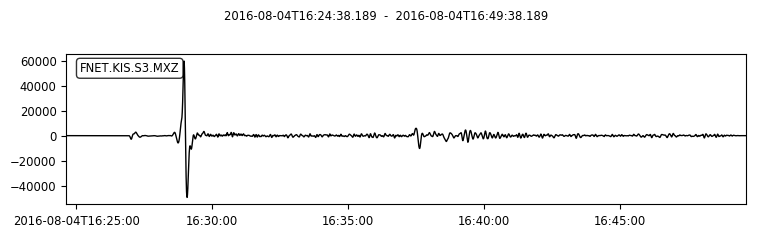

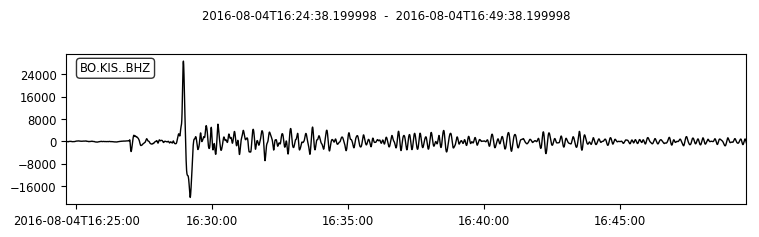

/Users/ziyixi/backup/obspy/obspy/taup/tau_branch.py:495: UserWarning: Resizing a TauP array inplace failed due to the existence of other references to the array, creating a new array. See Obspy #2280.
  warnings.warn(msg)


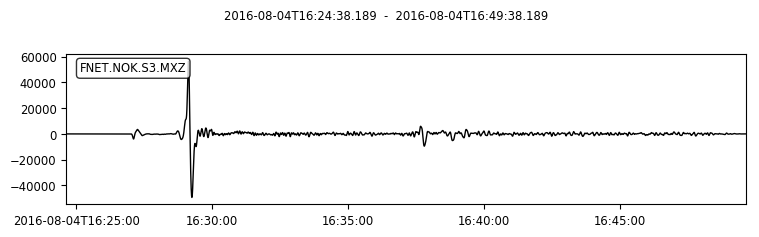

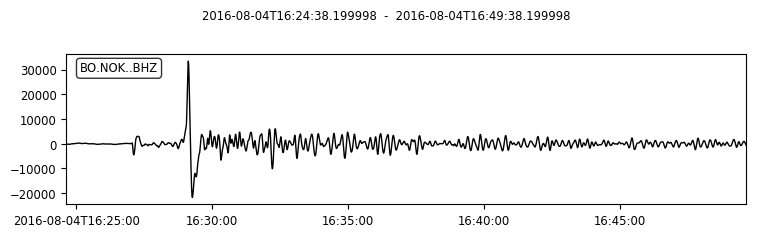

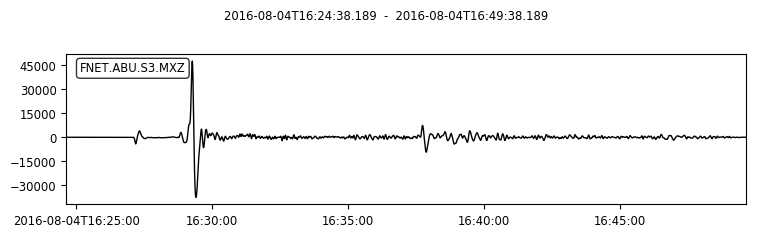

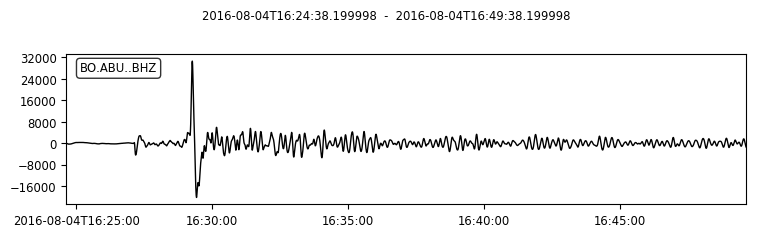

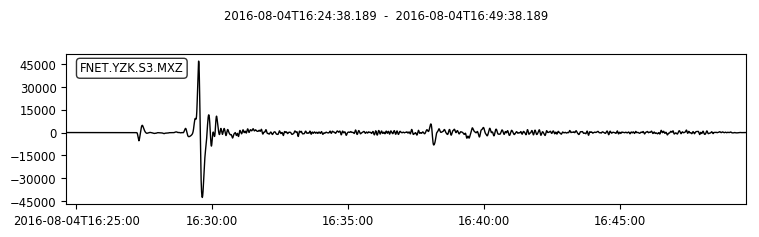

...

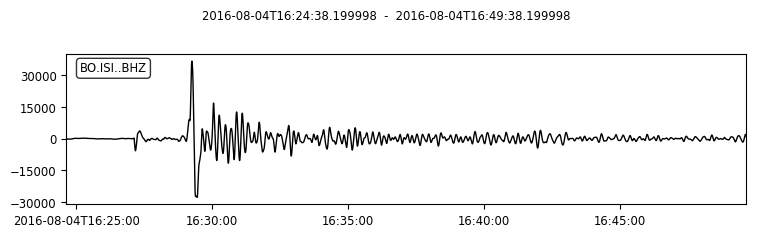

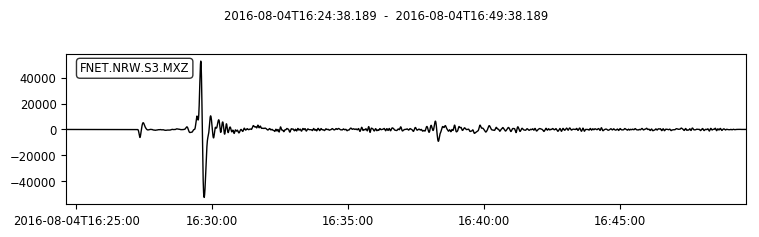

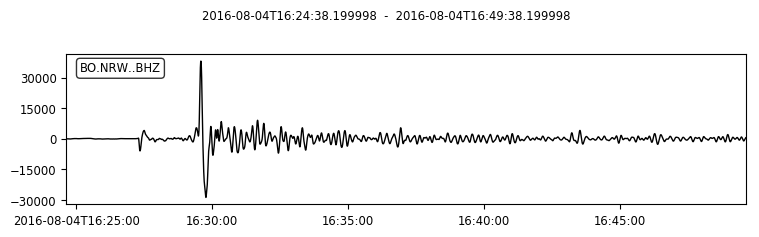

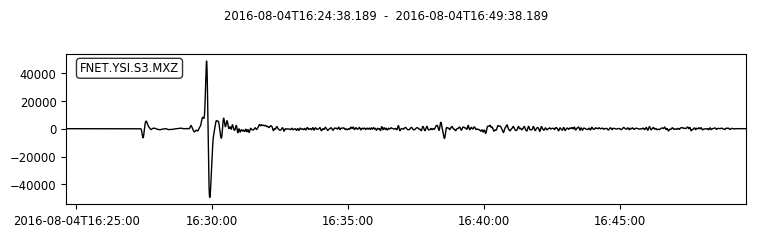

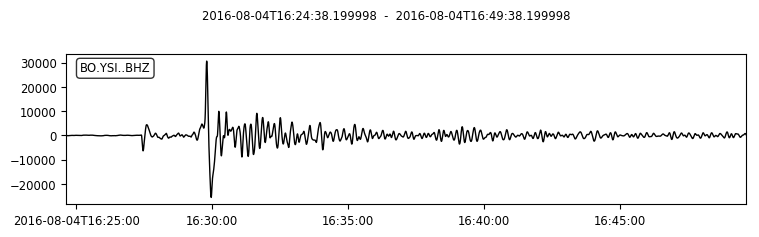

(8 Trace(s) in Stream:
FNET.KIS.S3.MXZ | 2016-08-04T16:28:04.339000Z - 2016-08-04T16:30:04.339000Z | 20.0 Hz, 2401 samples
FNET.NOK.S3.MXZ | 2016-08-04T16:28:13.889000Z - 2016-08-04T16:30:13.889000Z | 20.0 Hz, 2401 samples
FNET.ABU.S3.MXZ | 2016-08-04T16:28:23.289000Z - 2016-08-04T16:30:23.289000Z | 20.0 Hz, 2401 samples
FNET.YZK.S3.MXZ | 2016-08-04T16:28:36.389000Z - 2016-08-04T16:30:36.389000Z | 20.0 Hz, 2401 samples
FNET.SAG.S3.MXZ | 2016-08-04T16:29:04.939000Z - 2016-08-04T16:31:04.939000Z | 20.0 Hz, 2401 samples
FNET.ISI.S3.MXZ | 2016-08-04T16:28:20.489000Z - 2016-08-04T16:30:20.489000Z | 20.0 Hz, 2401 samples
FNET.NRW.S3.MXZ | 2016-08-04T16:28:40.189000Z - 2016-08-04T16:30:40.189000Z | 20.0 Hz, 2401 samples
FNET.YSI.S3.MXZ | 2016-08-04T16:28:52.939000Z - 2016-08-04T16:30:52.939000Z | 20.0 Hz, 2401 samples,
 8 Trace(s) in Stream:
BO.KIS..BHZ | 2016-08-04T16:28:04.349998Z - 2016-08-04T16:30:04.349998Z | 20.0 Hz, 2401 samples
BO.NOK..BHZ | 2016-08-04T16:28:13.899998Z - 2016-08-04T16

In [61]:
preprocess(sync,data,1/100,1/10,"s",-50,70)

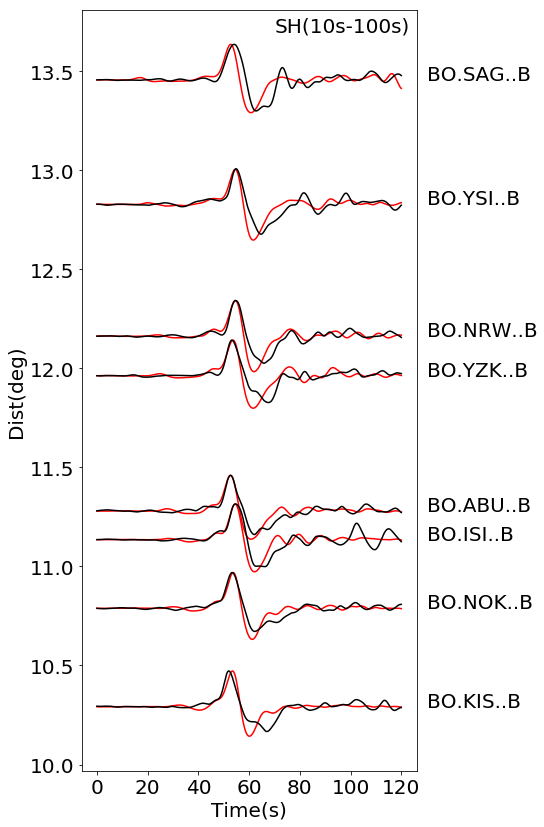

In [1904]:
plot(sync,data,-50,70,0.18)

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
8 Trace(s) in Stream:
FNET.KIS.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.NOK.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ABU.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.YZK.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.SAG.S3.MXZ | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ISI.S3.MXZ | 2016-08

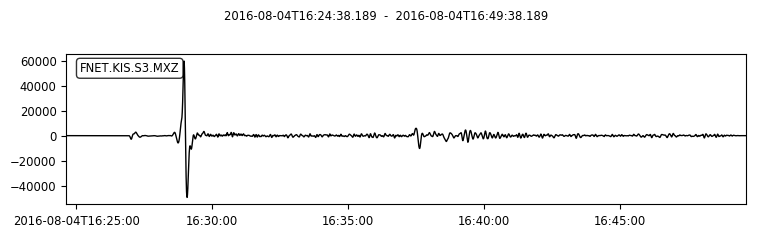

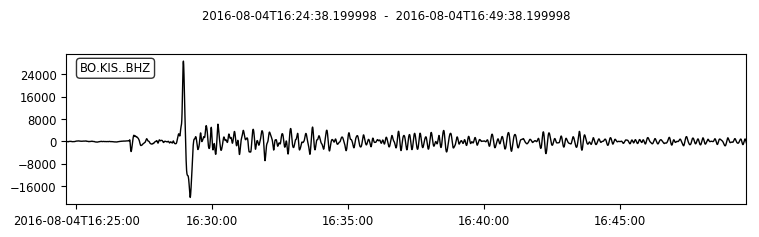

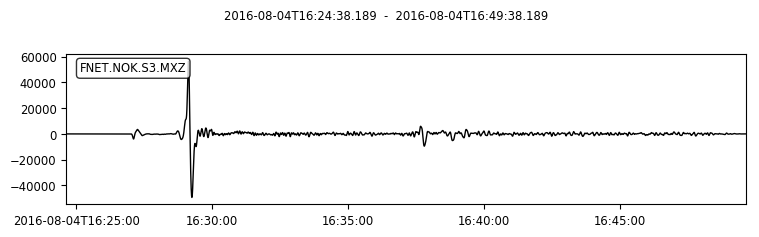

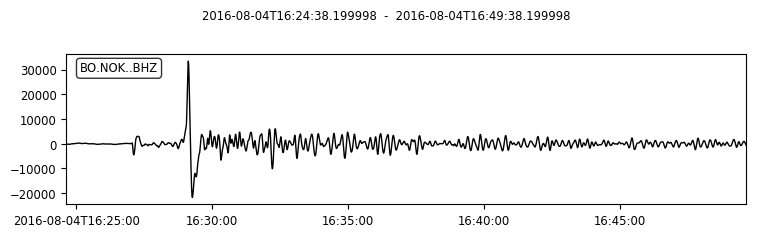

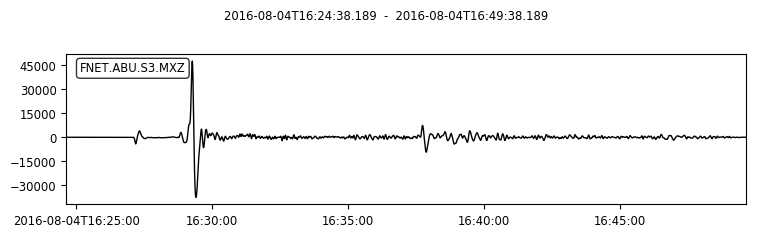

...

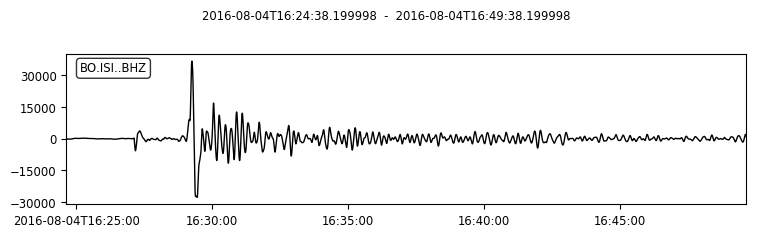

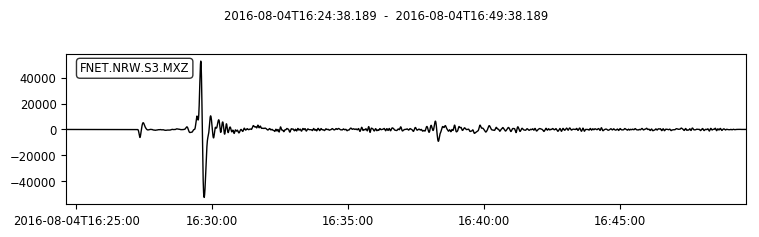

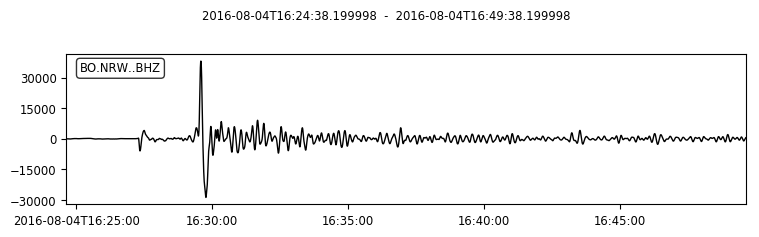

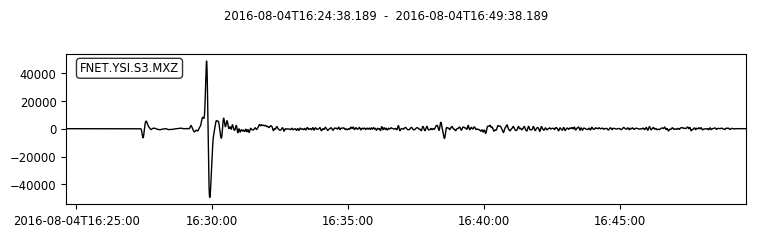

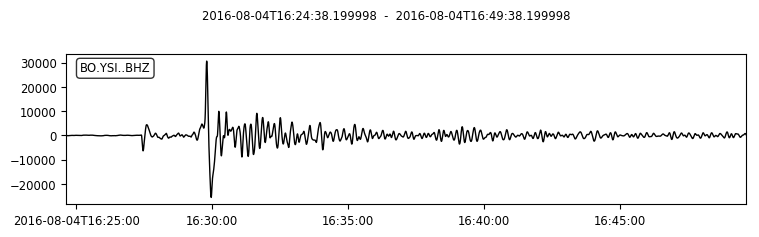

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
8 Trace(s) in Stream:
FNET.KIS.S3.MXR | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.NOK.S3.MXR | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ABU.S3.MXR | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.YZK.S3.MXR | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.SAG.S3.MXR | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ISI.S3.MXR | 2016-08

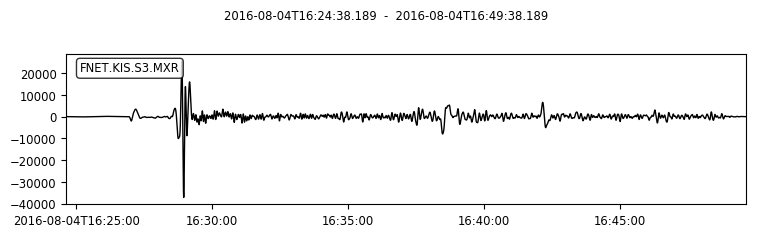

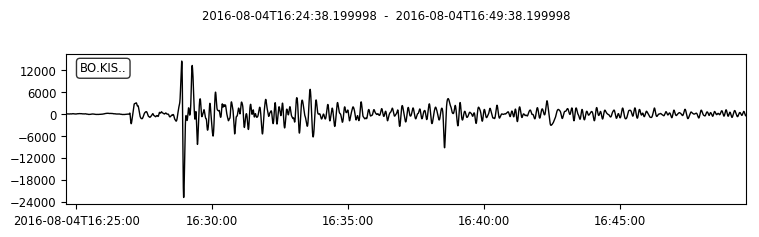

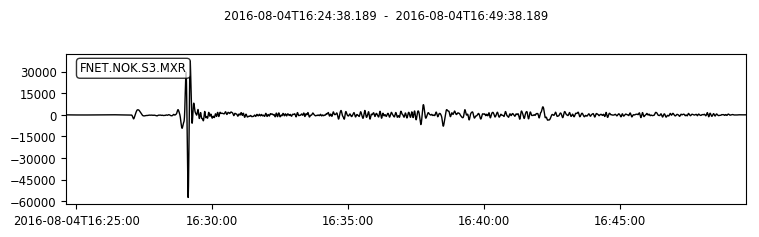

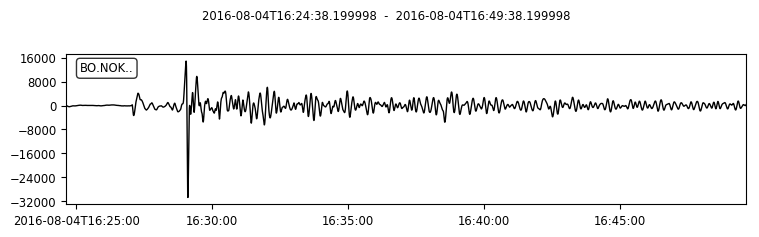

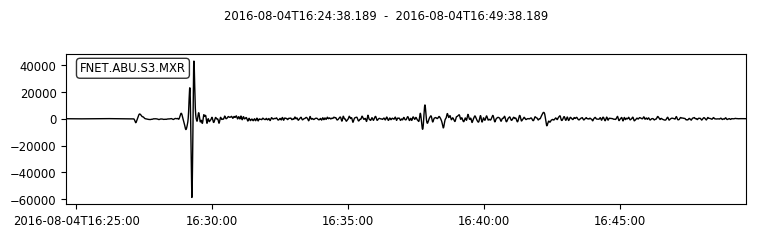

...

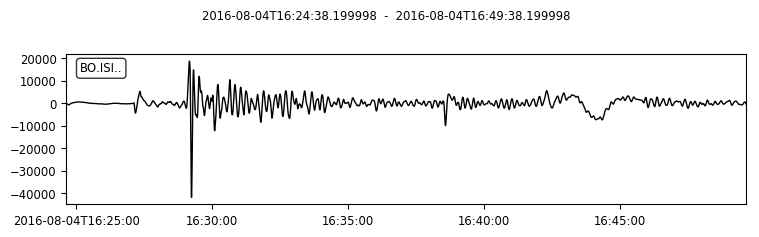

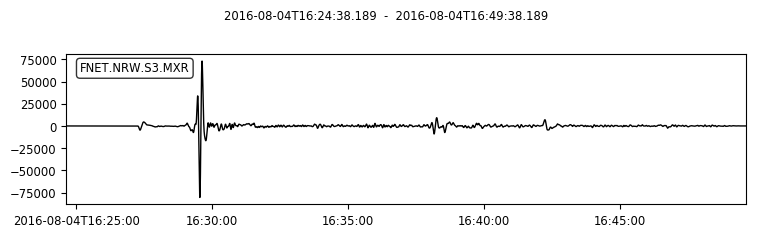

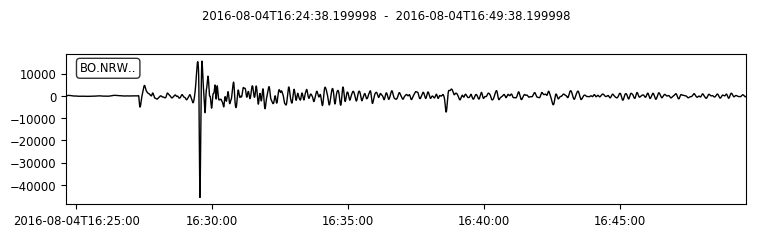

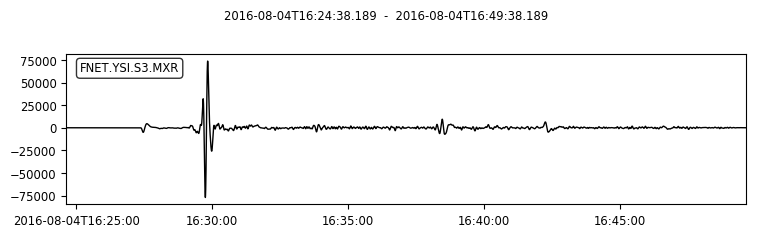

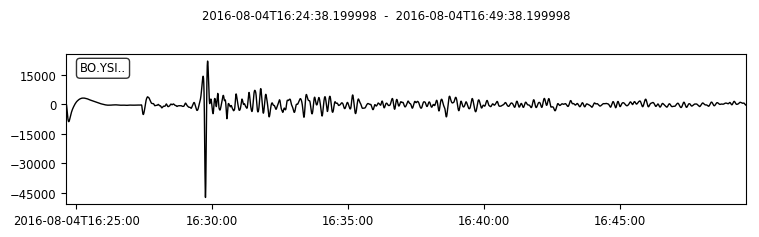

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.190000Z
8 Trace(s) in Stream:
FNET.KIS.S3.MXT | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.NOK.S3.MXT | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ABU.S3.MXT | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.YZK.S3.MXT | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.SAG.S3.MXT | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
FNET.ISI.S3.MXT | 2016-08

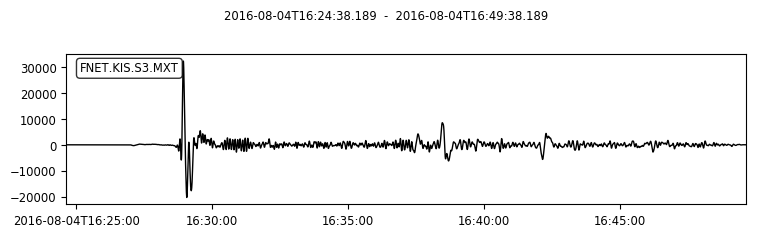

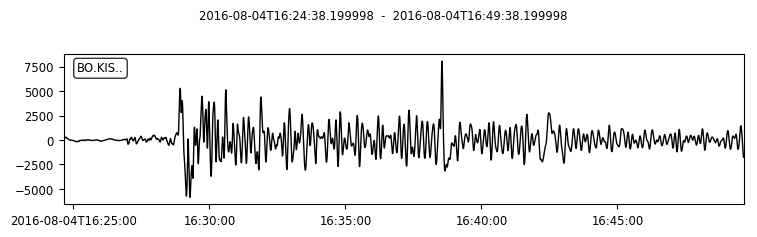

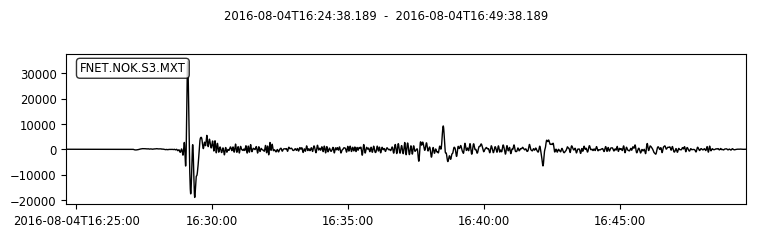

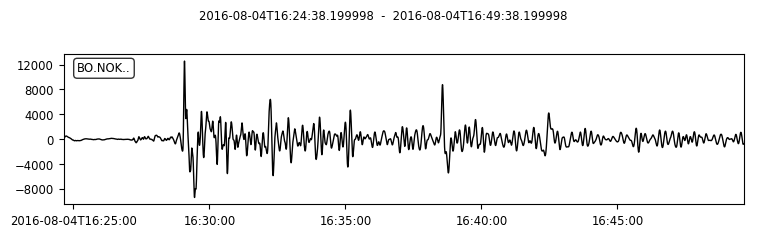

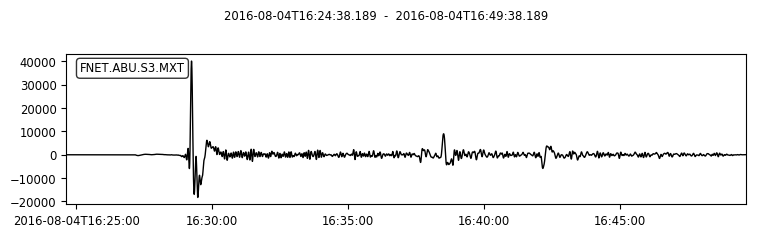

...

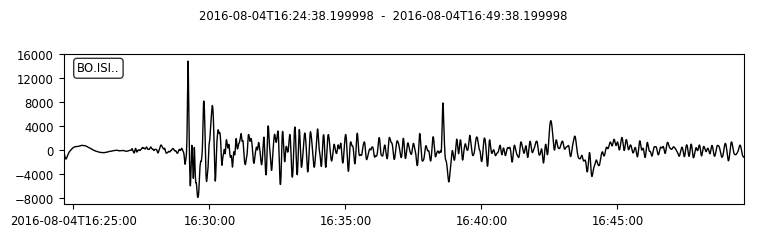

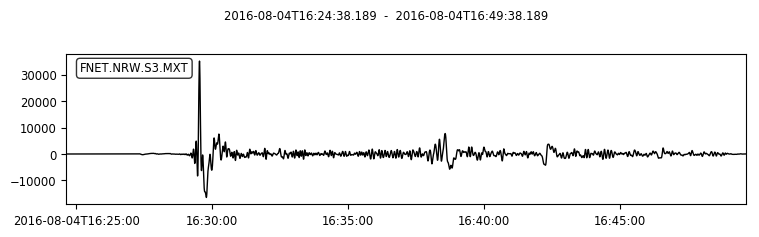

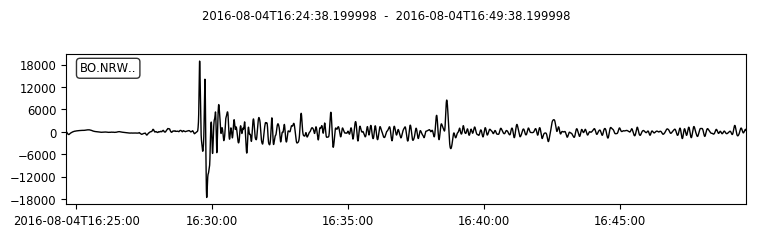

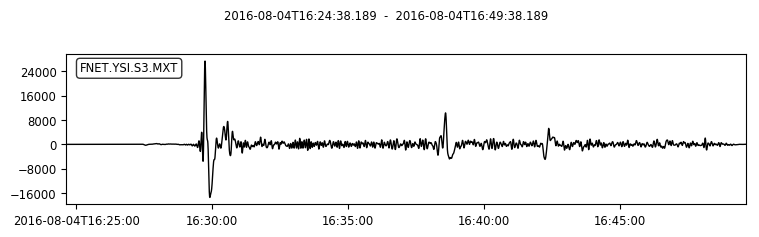

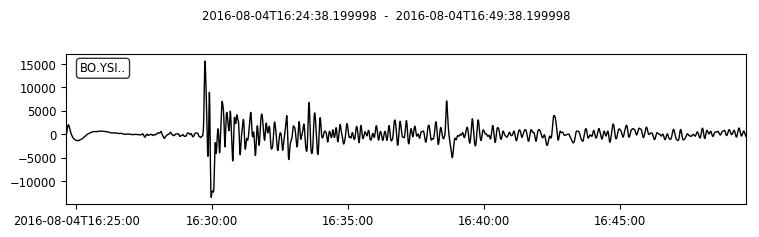

(8 Trace(s) in Stream:
FNET.KIS.S3.MXT | 2016-08-04T16:28:04.339000Z - 2016-08-04T16:30:04.339000Z | 20.0 Hz, 2401 samples
FNET.NOK.S3.MXT | 2016-08-04T16:28:13.889000Z - 2016-08-04T16:30:13.889000Z | 20.0 Hz, 2401 samples
FNET.ABU.S3.MXT | 2016-08-04T16:28:23.289000Z - 2016-08-04T16:30:23.289000Z | 20.0 Hz, 2401 samples
FNET.YZK.S3.MXT | 2016-08-04T16:28:36.389000Z - 2016-08-04T16:30:36.389000Z | 20.0 Hz, 2401 samples
FNET.SAG.S3.MXT | 2016-08-04T16:29:04.939000Z - 2016-08-04T16:31:04.939000Z | 20.0 Hz, 2401 samples
FNET.ISI.S3.MXT | 2016-08-04T16:28:20.489000Z - 2016-08-04T16:30:20.489000Z | 20.0 Hz, 2401 samples
FNET.NRW.S3.MXT | 2016-08-04T16:28:40.189000Z - 2016-08-04T16:30:40.189000Z | 20.0 Hz, 2401 samples
FNET.YSI.S3.MXT | 2016-08-04T16:28:52.939000Z - 2016-08-04T16:30:52.939000Z | 20.0 Hz, 2401 samples,
 8 Trace(s) in Stream:
BO.KIS.. | 2016-08-04T16:28:04.349998Z - 2016-08-04T16:30:04.349998Z | 20.0 Hz, 2401 samples
BO.NOK.. | 2016-08-04T16:28:13.899998Z - 2016-08-04T16:30:13

In [66]:
syncz=get_sync("/Users/ziyixi/Datas/fnet/201608041624382_sync_tao",names,"Z")
dataz=get_data("/Users/ziyixi/Datas/fnet/201608041624A",names,"Z")
syncr=get_sync("/Users/ziyixi/Datas/fnet/201608041624382_sync_tao",names,"R")
datar=get_data("/Users/ziyixi/Datas/fnet/201608041624A",names,"R")
synct=get_sync("/Users/ziyixi/Datas/fnet/201608041624382_sync_tao",names,"T")
datat=get_data("/Users/ziyixi/Datas/fnet/201608041624A",names,"T")
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

In [107]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,70,0.18)

TypeError: plot_three_component() missing 1 required positional argument: 'height'

In [279]:
def get_data_cea(main_path,names,component,network):
    dirs=[ join(main_path,f"{net}.{name}.00..{component}") for name,net in zip(names,network) ]
    data=obspy.Stream()
    for item in dirs:
        data+=obspy.read(item)
    data=sort_waves(data)
    return data   

def get_sync_cea(main_path,names,component,network):
    dirs=[ join(main_path,f"{net}.{name}.MX{component}.sem.sac") for name,net in zip(names,network) ]
    data=obspy.Stream()
    for item in dirs:
        data+=obspy.read(item)
    data=sort_waves(data)
    return data

In [129]:
def plot_three_component_cea(dataz,datar,datat,syncz,syncr,synct,t1,t2,scale,height):
#     fig, axes = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(14,8))
    fig, axes = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(14,height))
    
    sync=syncz
    data=dataz
    ax1 = axes[0]
    
    allstream=obspy.Stream()
    allstream+=sync
    allstream+=data
    allstream.normalize(global_max=False)
    for syncwave,datawave in zip(sync,data):
        plotx_sync=np.linspace(t1,t2,syncwave.stats.npts)-t1 
        plotx_data=np.linspace(t1,t2,datawave.stats.npts)-t1
        
        ploty_sync=syncwave.data*scale+syncwave.stats.sac.gcarc
        ploty_data=datawave.data*scale+syncwave.stats.sac.gcarc
        
        ax1.plot(plotx_sync,ploty_sync,color="r")
        ax1.plot(plotx_data,ploty_data,color="k")
        
#         plt.text(t2-t1+10,syncwave.stats.sac.gcarc,datawave.id[:-2],fontsize=20)
    ax1.set_xticks(np.arange(0,t2-t1+10,20))
    ax1.set_xlabel("Time(s)", fontsize=20)
    ax1.set_ylabel("Dist(deg)", fontsize=20)
    ax1.set_ylim([20.3,23.5])
#     ax1.text(22,23.38,"BHZ SV(10s-100s)",fontsize=20)

    sync=syncr
    data=datar
    ax2=axes[1]
    
    allstream=obspy.Stream()
    allstream+=sync
    allstream+=data
    allstream.normalize(global_max=False)
    for syncwave,datawave in zip(sync,data):
        plotx_sync=np.linspace(t1,t2,syncwave.stats.npts)-t1 
        plotx_data=np.linspace(t1,t2,datawave.stats.npts)-t1
        
        ploty_sync=syncwave.data*scale+syncwave.stats.sac.gcarc
        ploty_data=datawave.data*scale+syncwave.stats.sac.gcarc
        
        ax2.plot(plotx_sync,ploty_sync,color="r")
        ax2.plot(plotx_data,ploty_data,color="k")
        
#         plt.text(t2-t1+10,syncwave.stats.sac.gcarc,datawave.id[:-2],fontsize=20)
    ax2.set_xticks(np.arange(0,t2-t1+10,20))
    ax2.set_xlabel("Time(s)", fontsize=20)
#     ax1.set_ylabel("Dist(deg)", fontsize=20)
#     ax2.text(22,23.38,"BHR SV(10s-100s)",fontsize=20)
#     ax2.set_ylim([20.3,23.5])
    
    
    sync=synct
    data=datat
    ax3=axes[2]
    
    allstream=obspy.Stream()
    allstream+=sync
    allstream+=data
    allstream.normalize(global_max=False)
    for syncwave,datawave in zip(sync,data):
        plotx_sync=np.linspace(t1,t2,syncwave.stats.npts)-t1 
        plotx_data=np.linspace(t1,t2,datawave.stats.npts)-t1
        
        ploty_sync=syncwave.data*scale+syncwave.stats.sac.gcarc
        ploty_data=datawave.data*scale+syncwave.stats.sac.gcarc
        
        ax3.plot(plotx_sync,ploty_sync,color="r")
        ax3.plot(plotx_data,ploty_data,color="k")
        
        plt.text(t2-t1+10,syncwave.stats.sac.gcarc,"{datawave.id[:-4]},{datawave.stats.sac.gcarc:.2f} deg",fontsize=15)
    ax3.set_xticks(np.arange(0,t2-t1+10,20))
    ax3.set_xlabel("Time(s)", fontsize=20)
#     ax1.set_ylabel("Dist(deg)", fontsize=20)
#     ax3.text(22,23.38,"BHT SH(10s-100s)",fontsize=20)
#     ax3.set_ylim([20.3,23.5])
    plt.savefig("remote.eps")
#     plt.show()

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
7 Trace(s) in Stream:
JL.CN2.S3.MXZ  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.FMT.S3.MXZ  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.FST.S3.MXZ  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.HST.S3.MXZ  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.MJT.S3.MXZ  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.PST.S3.MXZ  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 

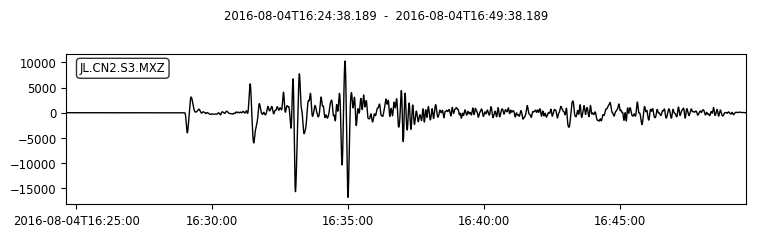

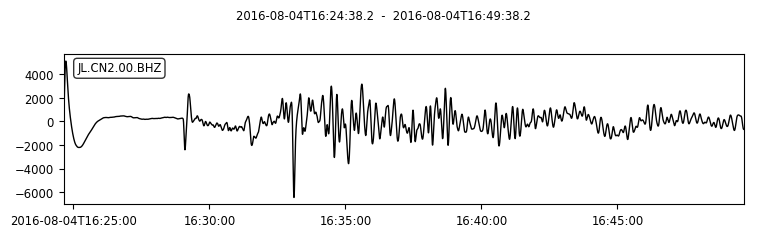

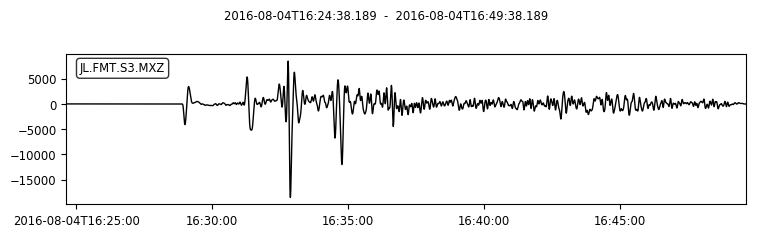

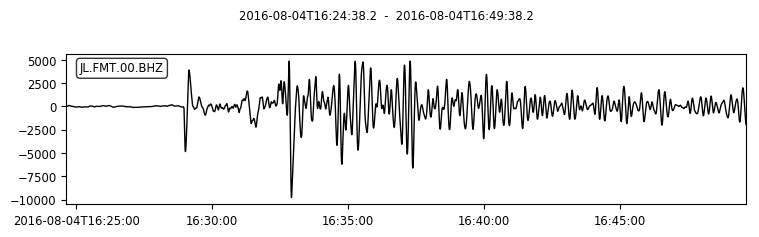

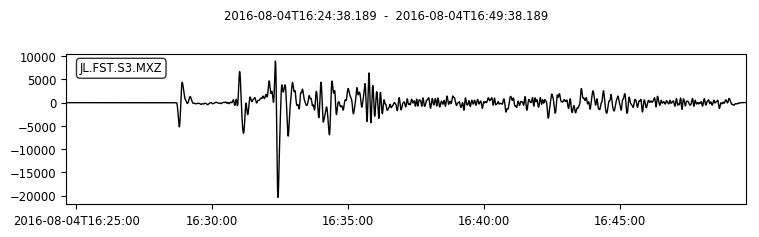

...

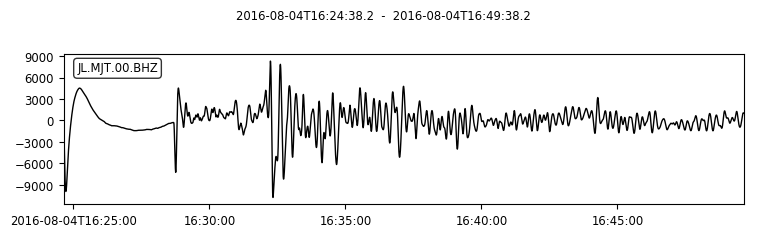

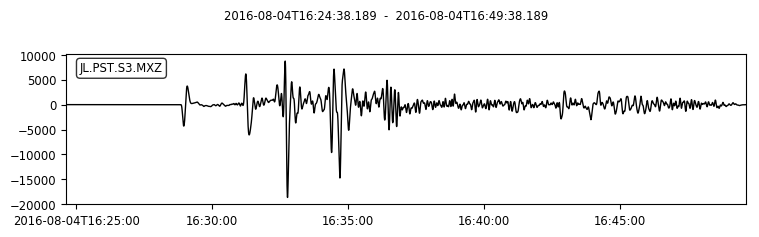

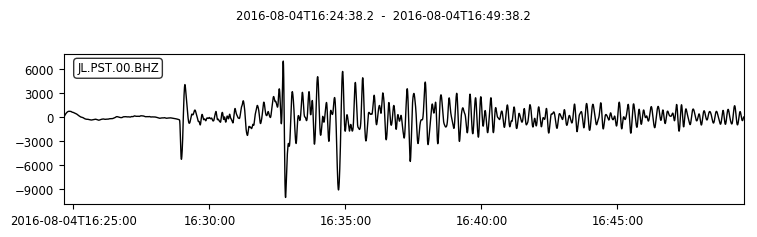

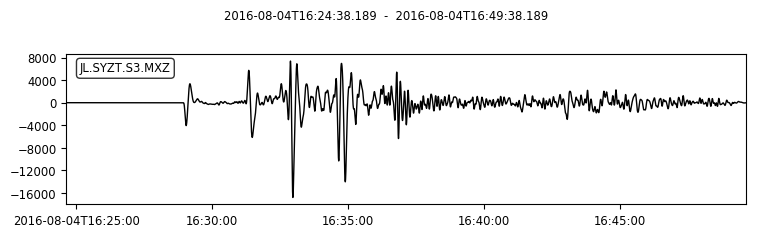

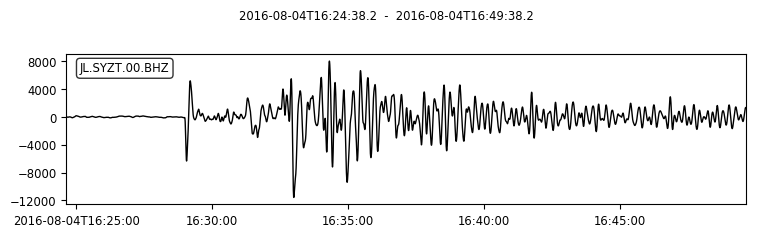

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
7 Trace(s) in Stream:
JL.CN2.S3.MXR  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.FMT.S3.MXR  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.FST.S3.MXR  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.HST.S3.MXR  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.MJT.S3.MXR  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.PST.S3.MXR  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 

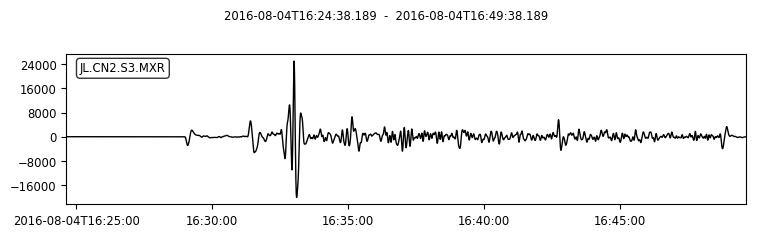

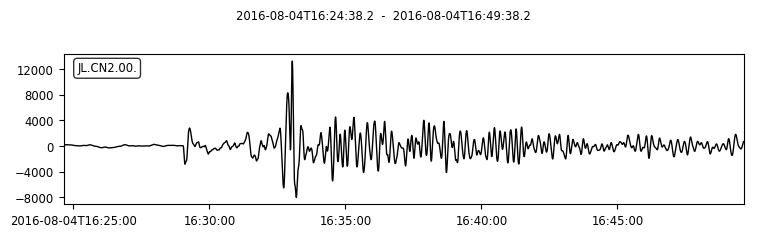

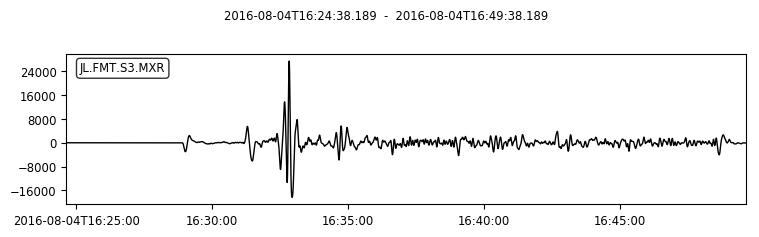

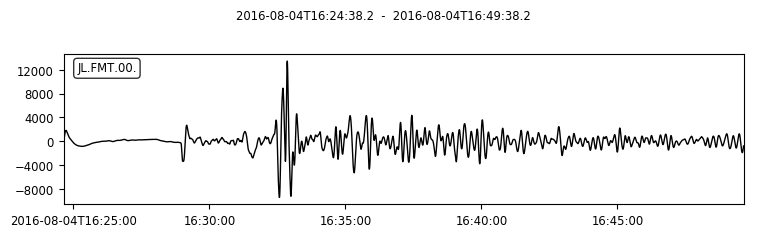

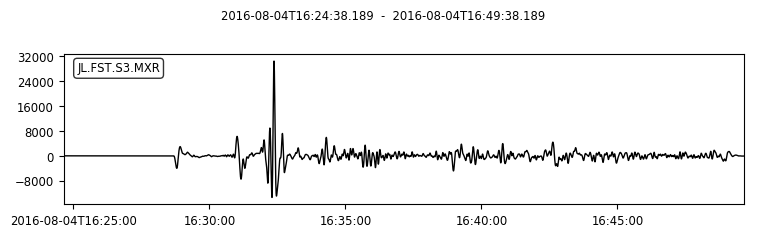

...

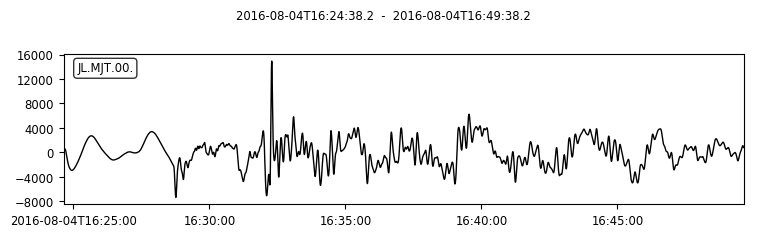

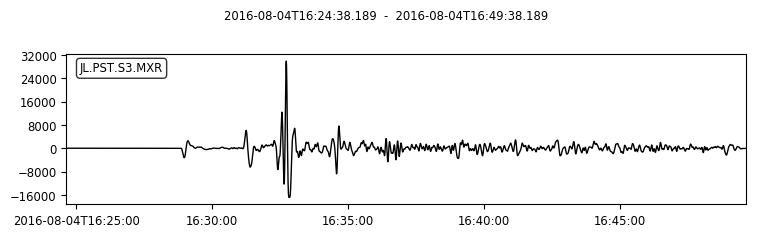

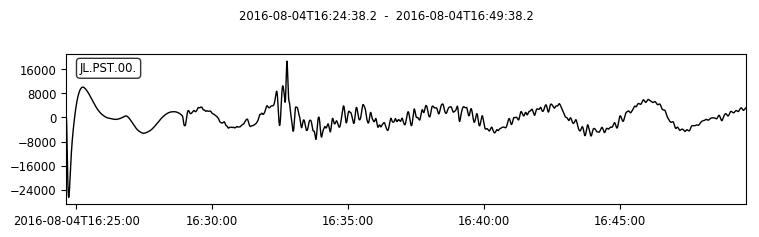

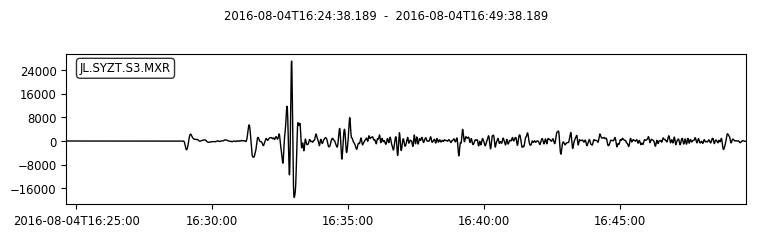

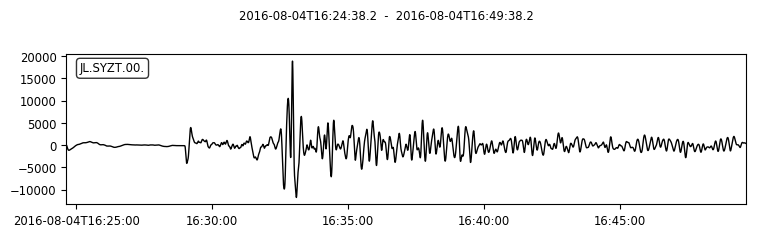

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
7 Trace(s) in Stream:
JL.CN2.S3.MXT  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.FMT.S3.MXT  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.FST.S3.MXT  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.HST.S3.MXT  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.MJT.S3.MXT  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 30001 samples
JL.PST.S3.MXT  | 2016-08-04T16:24:38.189000Z - 2016-08-04T16:49:38.189000Z | 20.0 Hz, 

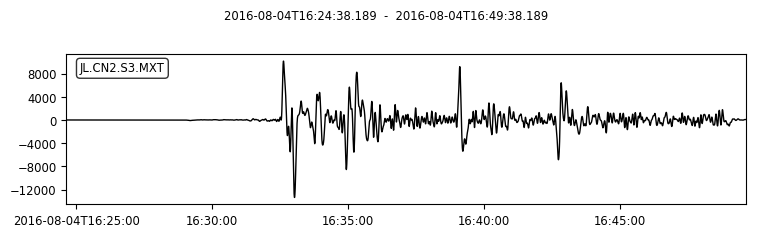

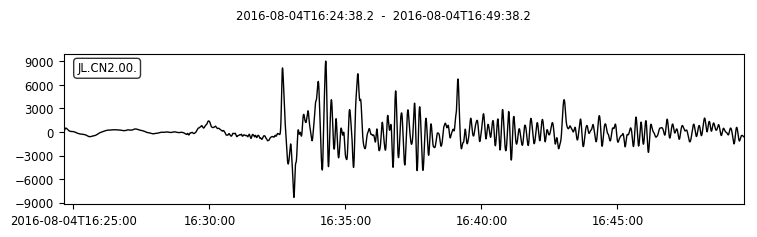

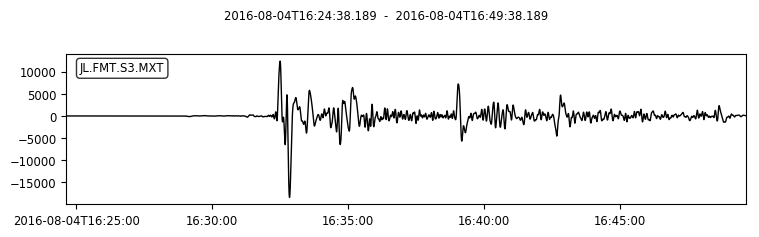

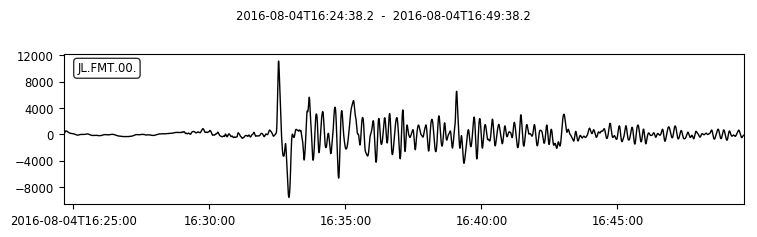

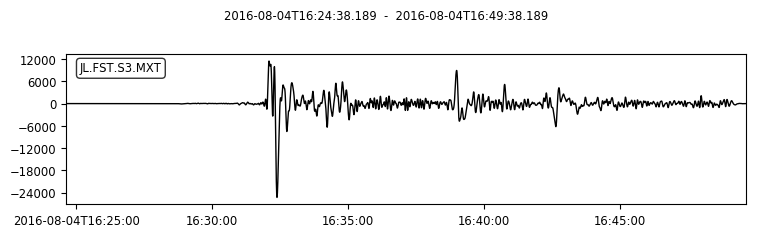

...

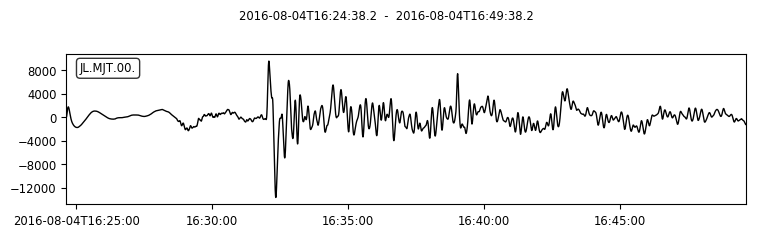

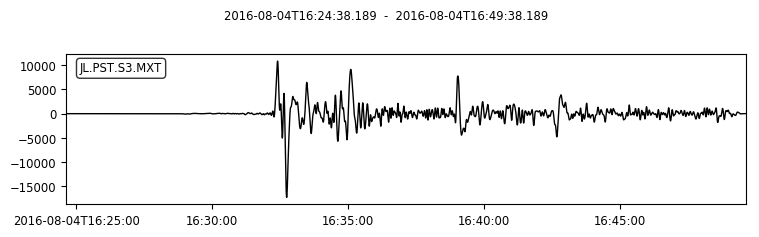

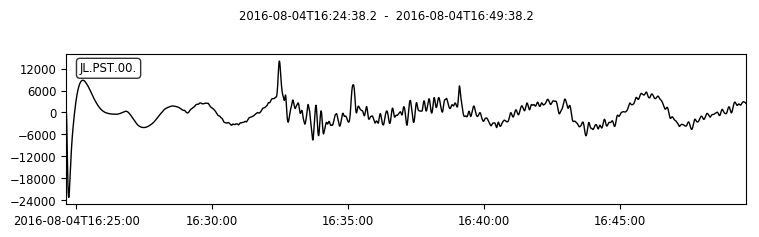

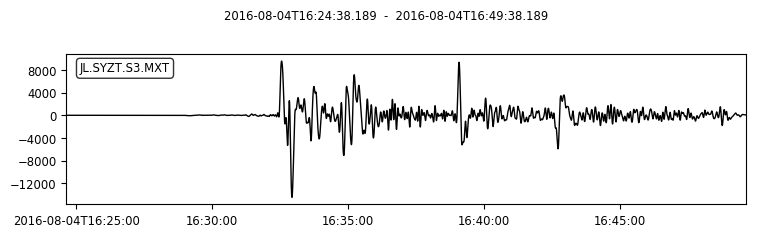

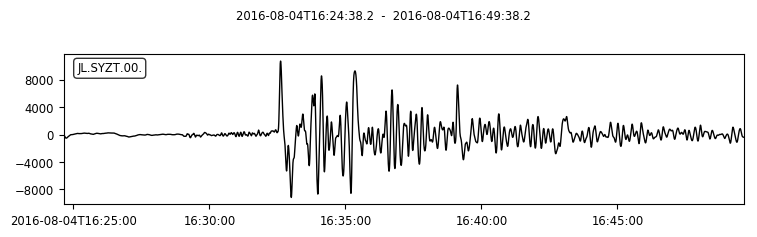

(7 Trace(s) in Stream:
JL.CN2.S3.MXT  | 2016-08-04T16:31:47.139000Z - 2016-08-04T16:33:47.139000Z | 20.0 Hz, 2401 samples
JL.FMT.S3.MXT  | 2016-08-04T16:31:37.439000Z - 2016-08-04T16:33:37.439000Z | 20.0 Hz, 2401 samples
JL.FST.S3.MXT  | 2016-08-04T16:31:14.189000Z - 2016-08-04T16:33:14.189000Z | 20.0 Hz, 2401 samples
JL.HST.S3.MXT  | 2016-08-04T16:31:24.439000Z - 2016-08-04T16:33:24.439000Z | 20.0 Hz, 2401 samples
JL.MJT.S3.MXT  | 2016-08-04T16:31:08.789000Z - 2016-08-04T16:33:08.789000Z | 20.0 Hz, 2401 samples
JL.PST.S3.MXT  | 2016-08-04T16:31:32.339000Z - 2016-08-04T16:33:32.339000Z | 20.0 Hz, 2401 samples
JL.SYZT.S3.MXT | 2016-08-04T16:31:42.389000Z - 2016-08-04T16:33:42.389000Z | 20.0 Hz, 2401 samples,
 7 Trace(s) in Stream:
JL.CN2.00.  | 2016-08-04T16:31:47.170000Z - 2016-08-04T16:33:47.170000Z | 100.0 Hz, 12001 samples
JL.FMT.00.  | 2016-08-04T16:31:37.430000Z - 2016-08-04T16:33:37.430000Z | 100.0 Hz, 12001 samples
JL.FST.00.  | 2016-08-04T16:31:14.210000Z - 2016-08-04T16:33:14.

In [72]:
names=["CN2","FMT","FST","HST","MJT","PST","SYZT"] # ,"MZL" "HLR", "CHR", ,"IDR"
syncz=get_sync_cea("/Users/ziyixi/Datas/fnet/cea/sync",names,"Z")
dataz=get_data_cea("/Users/ziyixi/Datas/fnet/cea/poster",names,"Z")
syncr=get_sync_cea("/Users/ziyixi/Datas/fnet/cea/sync",names,"R")
datar=get_data_cea("/Users/ziyixi/Datas/fnet/cea/poster",names,"R")
synct=get_sync_cea("/Users/ziyixi/Datas/fnet/cea/sync",names,"T")
datat=get_data_cea("/Users/ziyixi/Datas/fnet/cea/poster",names,"T")
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

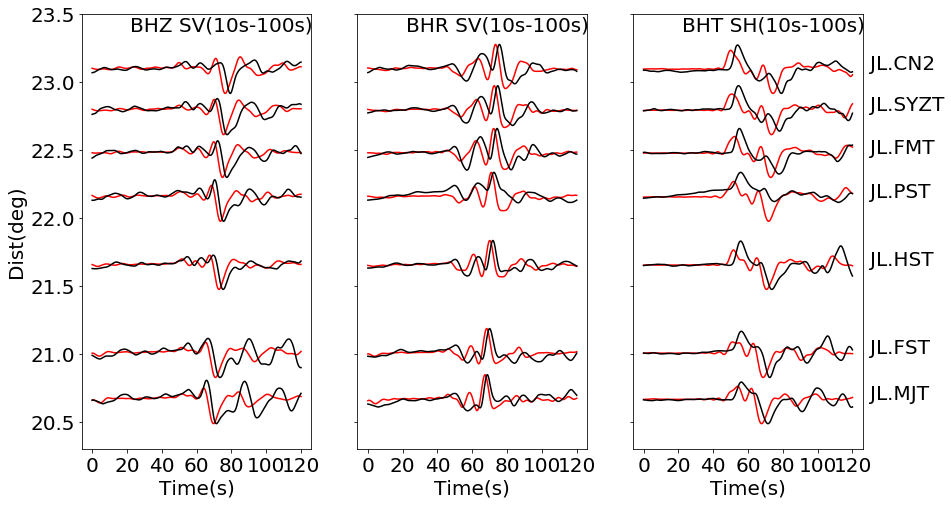

In [73]:
plot_three_component_cea(dataz,datar,datat,syncz,syncr,synct,-50,70,0.18)

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.

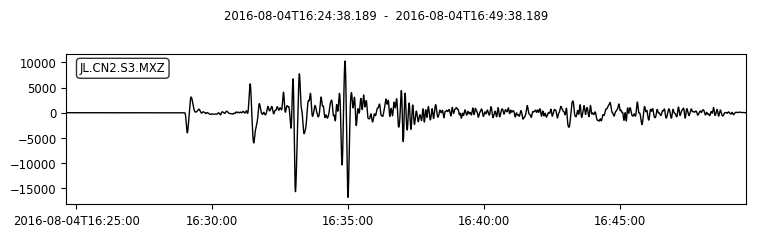

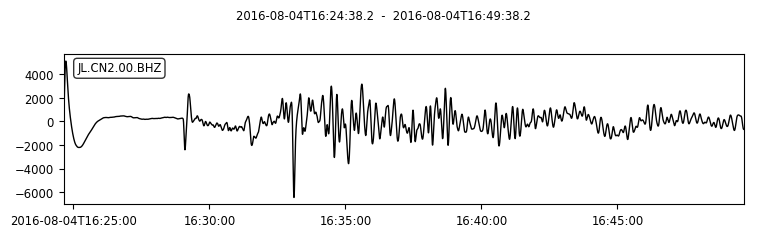

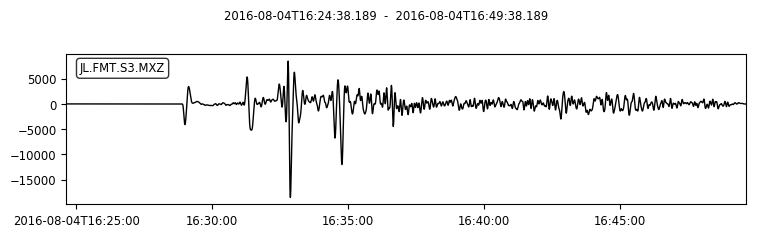

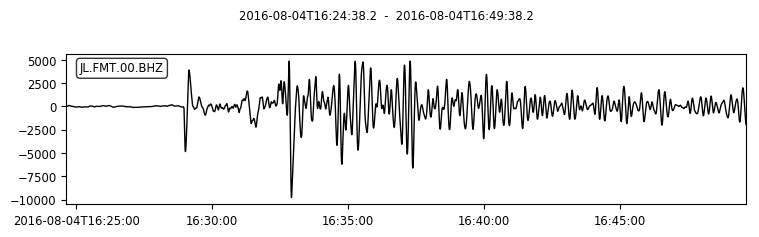

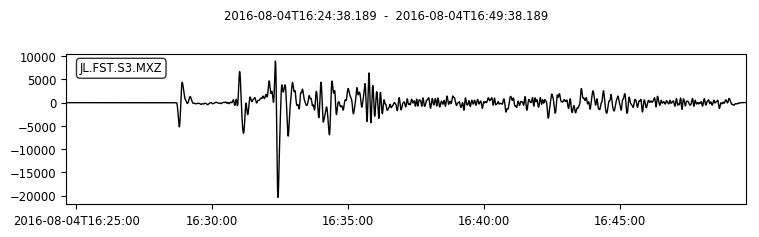

...

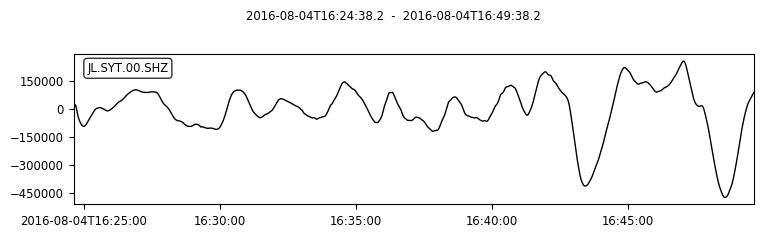

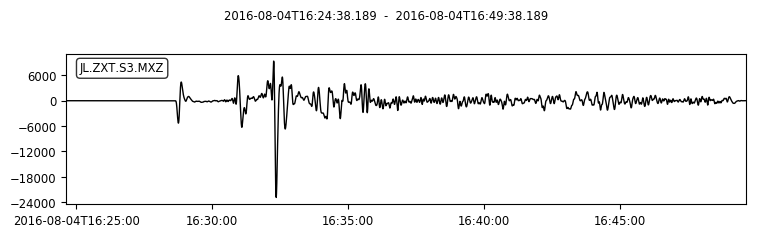

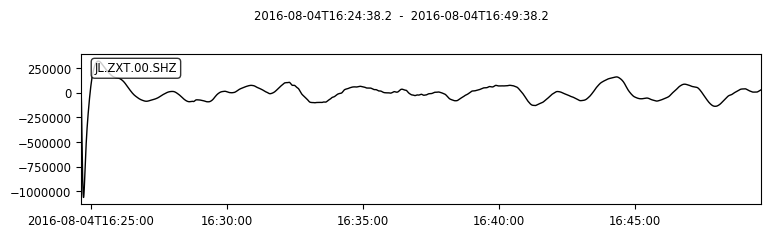

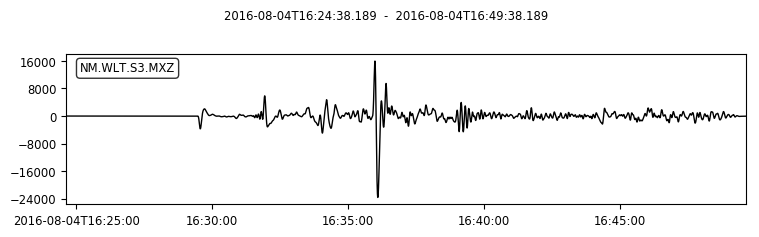

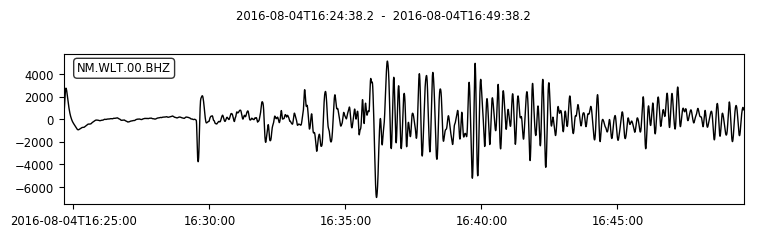

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.

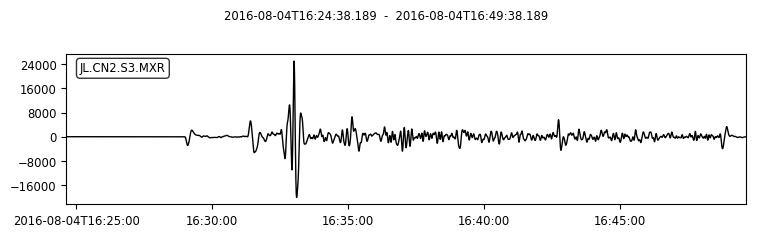

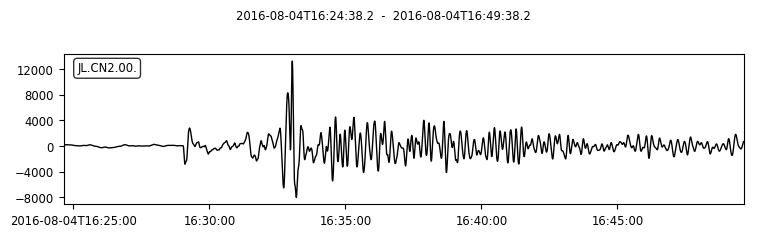

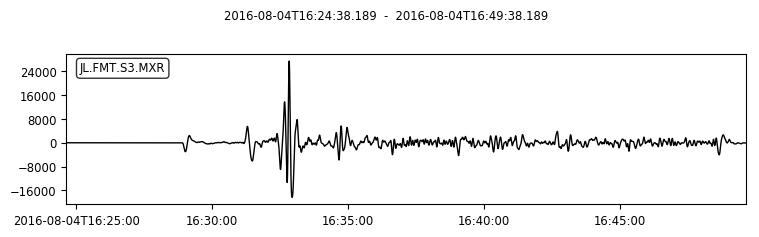

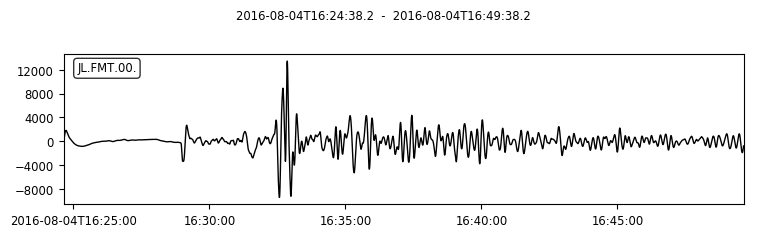

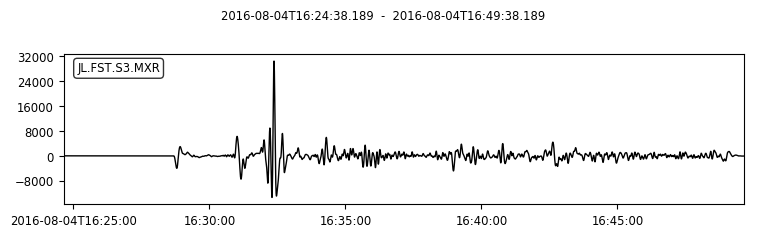

...

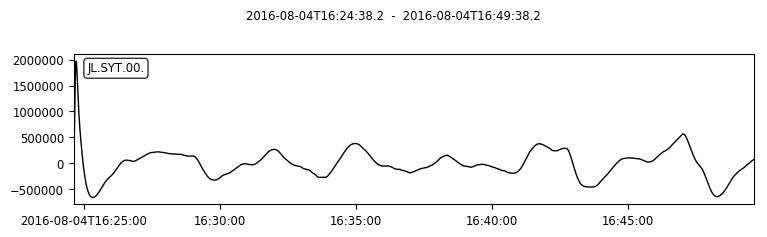

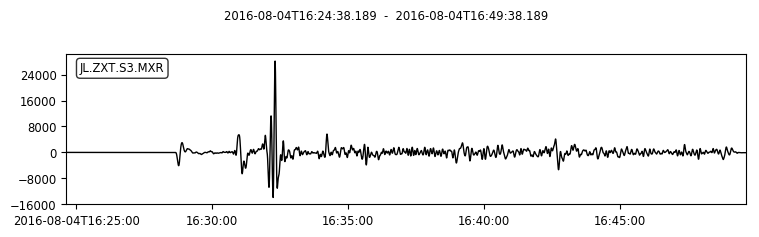

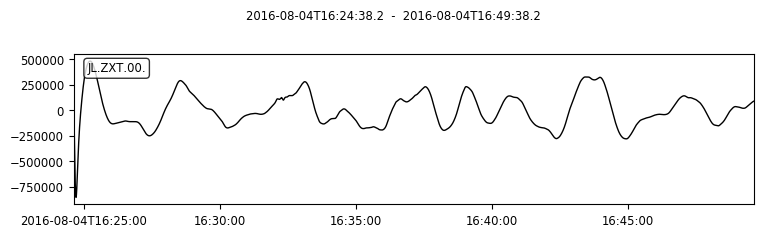

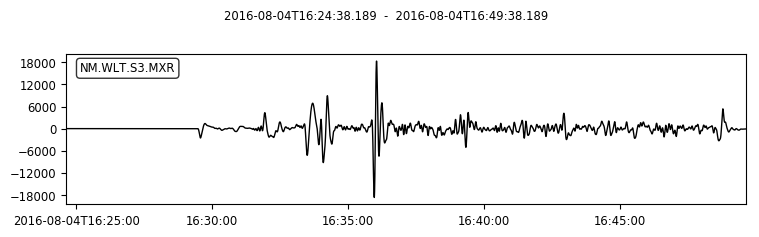

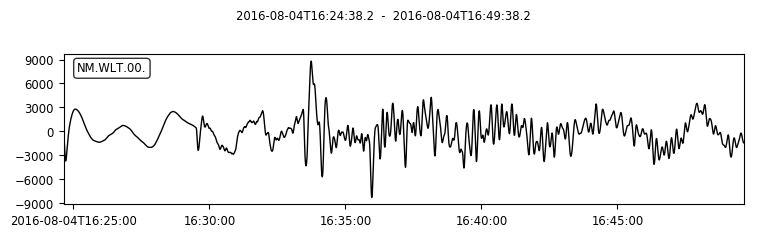

2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.200000Z
2016-08-04T16:24:38.189000Z
2016-08-04T16:24:38.

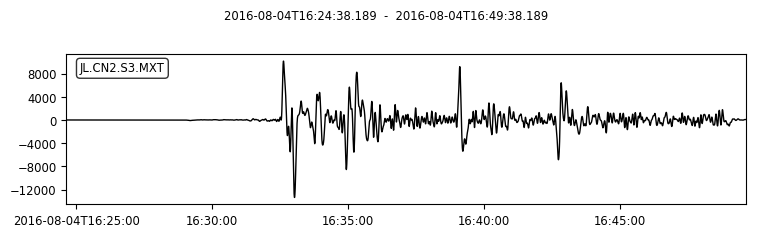

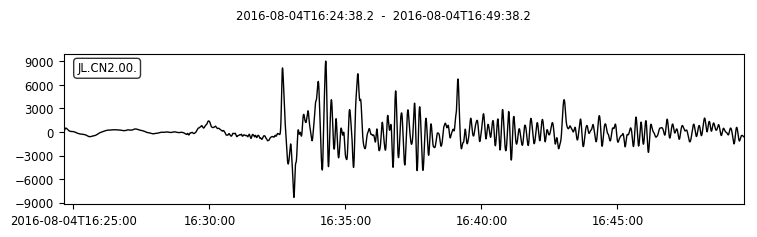

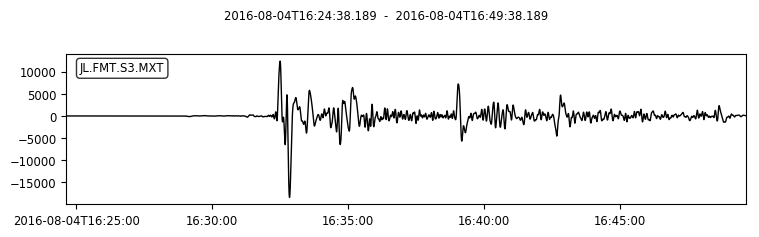

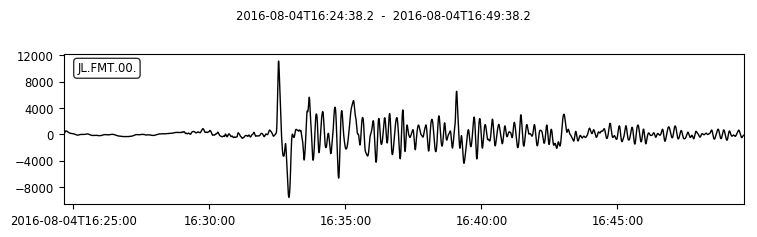

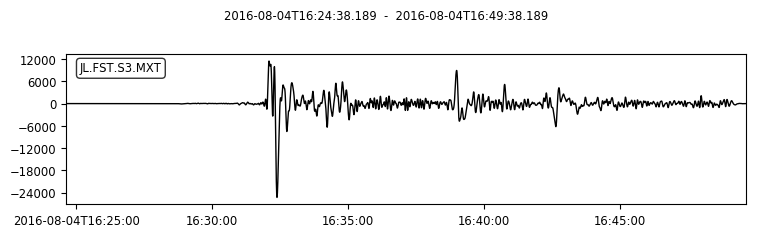

...

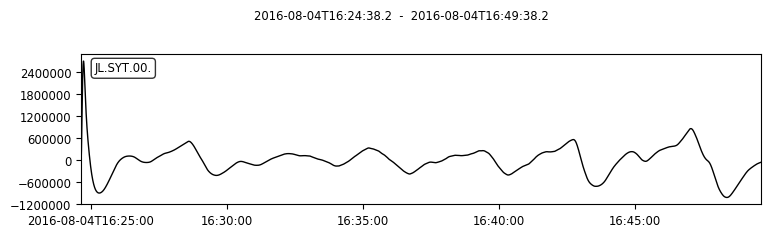

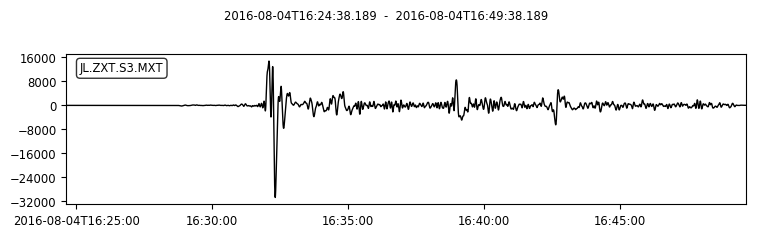

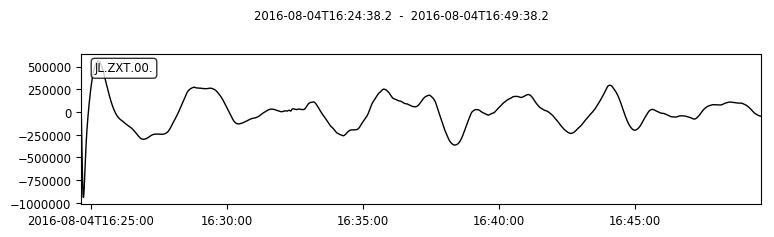

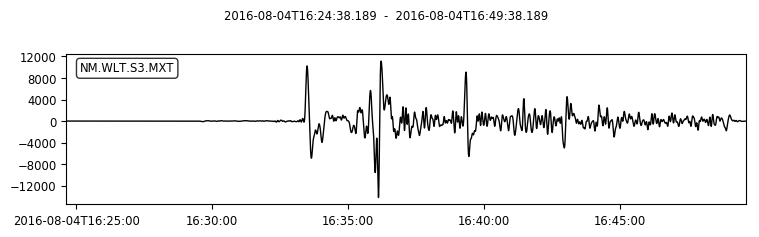

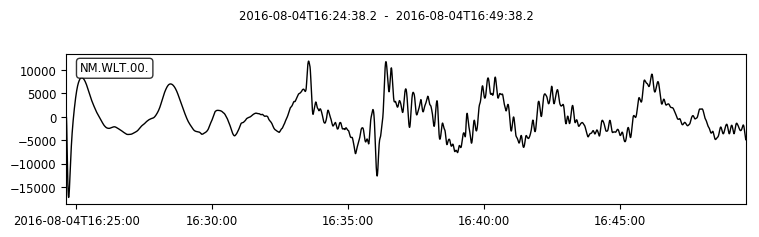

(18 Trace(s) in Stream:
JL.CN2.S3.MXT  | 2016-08-04T16:31:47.139000Z - 2016-08-04T16:33:47.139000Z | 20.0 Hz, 2401 samples
JL.FMT.S3.MXT  | 2016-08-04T16:31:37.439000Z - 2016-08-04T16:33:37.439000Z | 20.0 Hz, 2401 samples
JL.FST.S3.MXT  | 2016-08-04T16:31:14.189000Z - 2016-08-04T16:33:14.189000Z | 20.0 Hz, 2401 samples
JL.HST.S3.MXT  | 2016-08-04T16:31:24.439000Z - 2016-08-04T16:33:24.439000Z | 20.0 Hz, 2401 samples
JL.MJT.S3.MXT  | 2016-08-04T16:31:08.789000Z - 2016-08-04T16:33:08.789000Z | 20.0 Hz, 2401 samples
JL.PST.S3.MXT  | 2016-08-04T16:31:32.339000Z - 2016-08-04T16:33:32.339000Z | 20.0 Hz, 2401 samples
JL.SYZT.S3.MXT | 2016-08-04T16:31:42.389000Z - 2016-08-04T16:33:42.389000Z | 20.0 Hz, 2401 samples
NM.MZL.S3.MXT  | 2016-08-04T16:33:51.239000Z - 2016-08-04T16:35:51.239000Z | 20.0 Hz, 2401 samples
NM.HLR.S3.MXT  | 2016-08-04T16:33:31.739000Z - 2016-08-04T16:35:31.739000Z | 20.0 Hz, 2401 samples
NM.CHR.S3.MXT  | 2016-08-04T16:33:06.989000Z - 2016-08-04T16:35:06.989000Z | 20.0 Hz,

In [74]:
names=["CN2","FMT","FST","HST","MJT","PST","SYZT","MZL" ,"HLR", "CHR", "IDR","AGT","CBS","QAT","SGT","SYT","ZXT","WLT"] # ,
syncz=get_sync_cea("/Users/ziyixi/Datas/fnet/cea/sync",names,"Z")
dataz=get_data_cea("/Users/ziyixi/Datas/fnet/cea/poster",names,"Z")
syncr=get_sync_cea("/Users/ziyixi/Datas/fnet/cea/sync",names,"R")
datar=get_data_cea("/Users/ziyixi/Datas/fnet/cea/poster",names,"R")
synct=get_sync_cea("/Users/ziyixi/Datas/fnet/cea/sync",names,"T")
datat=get_data_cea("/Users/ziyixi/Datas/fnet/cea/poster",names,"T")
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

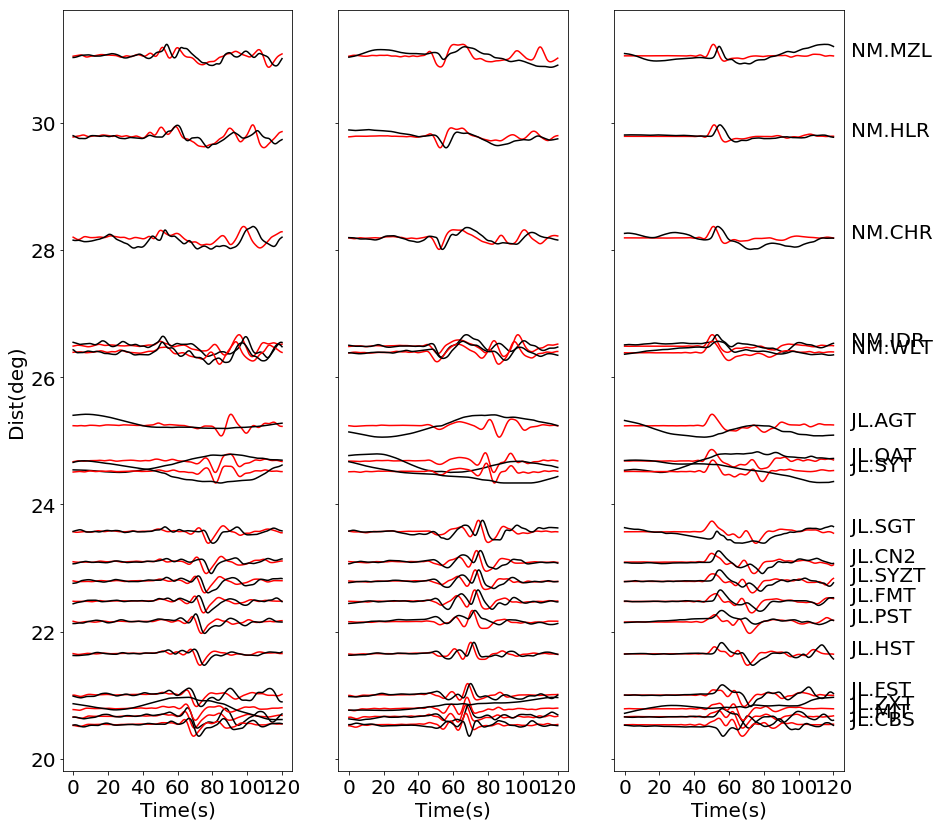

In [83]:
plot_three_component_cea(dataz,datar,datat,syncz,syncr,synct,-50,70,0.18)

# poster new!!!

In [284]:
import matplotlib
matplotlib.rc('xtick', labelsize=15) 
matplotlib.rc('ytick', labelsize=15) 
def plot_three_component(dataz,datar,datat,syncz,syncr,synct,t1,t2,scale,height):
#     fig, axes = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(14,8))
    fig, axes = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(13.8,height))
    
    sync=syncz
    data=dataz
    ax1 = axes[0]
    
#     allstream=obspy.Stream()
#     allstream+=sync
#     allstream+=data
#     allstream.normalize(global_max=False)
    for index,syncwave,datawave in zip(range(len(data)),sync,data):
        allstream=obspy.Stream()
        allstream+=syncwave
        allstream+=datawave
        allstream.normalize(global_max=True)
        plotx_sync=np.linspace(t1,t2,syncwave.stats.npts) 
        plotx_data=np.linspace(t1,t2,datawave.stats.npts)
        
        ploty_sync=syncwave.data*scale+(index+1)
        ploty_data=datawave.data*scale+(index+1)
        
        ax1.plot(plotx_sync,ploty_sync,color="r")
        ax1.plot(plotx_data,ploty_data,color="k")
        
#         plt.text(t2-t1+10,syncwave.stats.sac.gcarc,datawave.id[:-2],fontsize=20)
    ax1.set_xticks(np.arange(t1,t2+10,50))
    ax1.set_yticks(np.arange(len(sync))+1)
    ax1.set_xlabel("Time(s)", fontsize=20)
    ax1.set_ylabel("ID", fontsize=20)
    ax1.set_ylim([0,len(sync)+0.99])
    ax1.text(22,len(sync)+0.58,"BHZ SV(10s-100s)",fontsize=15)
#     ax1.text(22,len(sync)+0.68,"BHZ SV(10s-100s)",fontsize=20)

    sync=syncr
    data=datar
    ax2=axes[1]
    
#     allstream=obspy.Stream()
#     allstream+=sync
#     allstream+=data
#     allstream.normalize(global_max=False)
    for index,syncwave,datawave in zip(range(len(data)),sync,data):
        allstream=obspy.Stream()
        allstream+=syncwave
        allstream+=datawave
        allstream.normalize(global_max=True)
        plotx_sync=np.linspace(t1,t2,syncwave.stats.npts)
        plotx_data=np.linspace(t1,t2,datawave.stats.npts)
        
        ploty_sync=syncwave.data*scale+(index+1)
        ploty_data=datawave.data*scale+(index+1)
        
        ax2.plot(plotx_sync,ploty_sync,color="r")
        ax2.plot(plotx_data,ploty_data,color="k")
        
#         plt.text(t2-t1+10,syncwave.stats.sac.gcarc,datawave.id[:-2],fontsize=20)
    ax2.set_xticks(np.arange(t1,t2+10,50))
    ax2.set_xlabel("Time(s)", fontsize=20)
    ax2.set_ylim([0,len(sync)+0.99])
    ax2.text(22,len(sync)+0.58,"BHR SV(10s-100s)",fontsize=15)
#     ax1.set_ylabel("Dist(deg)", fontsize=20)
#     ax2.text(22,len(sync)+0.68,"BHR SV(10s-100s)",fontsize=20)
    
    
    sync=synct
    data=datat
    ax3=axes[2]
    
#     allstream=obspy.Stream()
#     allstream+=sync
#     allstream+=data
#     allstream.normalize(global_max=False)
    for index,syncwave,datawave in zip(range(len(data)),sync,data):
        allstream=obspy.Stream()
        allstream+=syncwave
        allstream+=datawave
        allstream.normalize(global_max=True)
        plotx_sync=np.linspace(t1,t2,syncwave.stats.npts)
        plotx_data=np.linspace(t1,t2,datawave.stats.npts)
        
        ploty_sync=syncwave.data*scale+(index+1)
        ploty_data=datawave.data*scale+(index+1)
        
        ax3.plot(plotx_sync,ploty_sync,color="r")
        ax3.plot(plotx_data,ploty_data,color="k")
        
        plt.text(t2-t1-25,index+1,f"{datawave.id[:-2]}, {datawave.stats.sac.gcarc:.2f}°",fontsize=10)
    ax3.set_xticks(np.arange(t1,t2+10,50))
    ax3.set_xlabel("Time(s)", fontsize=20)
    ax3.set_ylim([0,len(sync)+0.99])
    ax3.text(22,len(sync)+0.58,"BHT SH(10s-100s)",fontsize=15)
#     ax1.set_ylabel("Dist(deg)", fontsize=20)
#     ax3.text(22,len(sync)+0.68,"BHT SH(10s-100s)",fontsize=20)
    
#     plt.show()
    plt.savefig("./bbq.pdf")

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
6 Trace(s) in Stream:
FNET.TSK.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.ASI.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.YMZ.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.SBT.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.KZK.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.ADM.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples 6 Trace(s) in Stream:
BO.TSK..BHZ | 

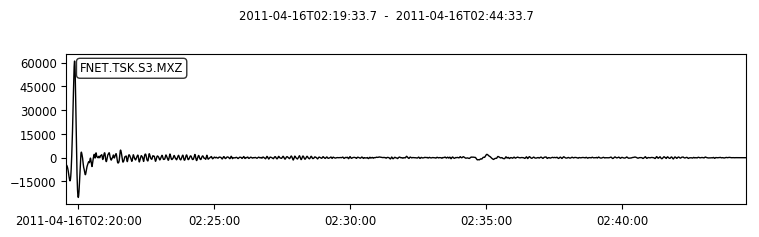

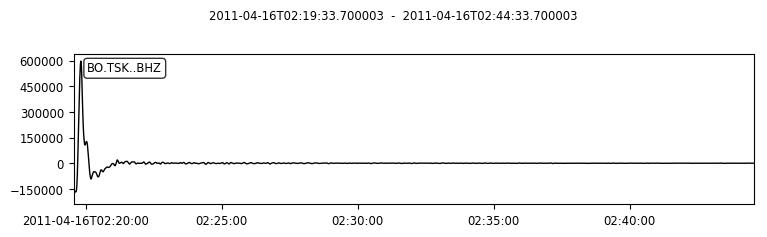

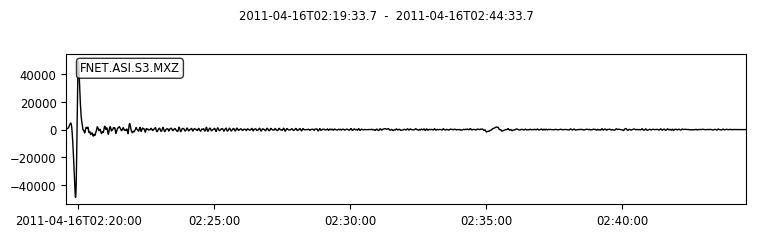

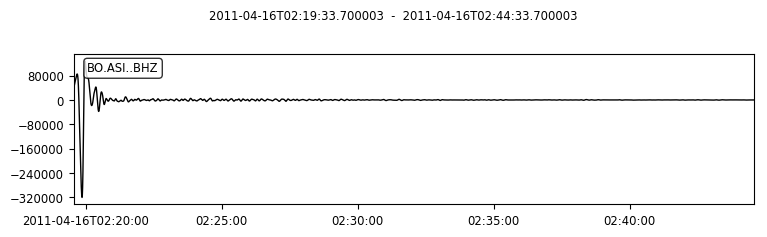

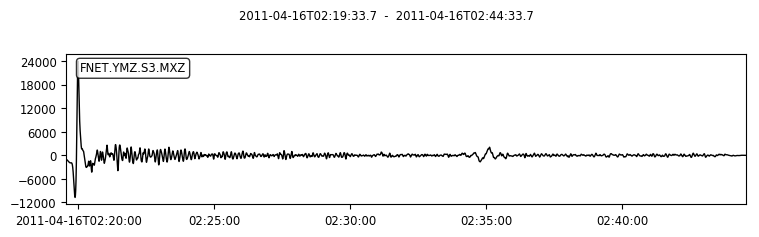

...

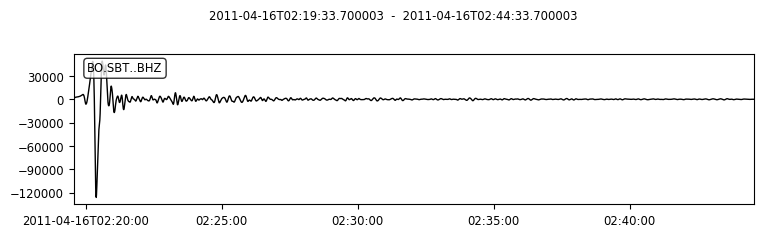

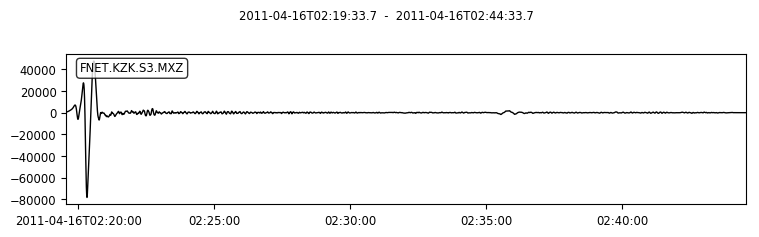

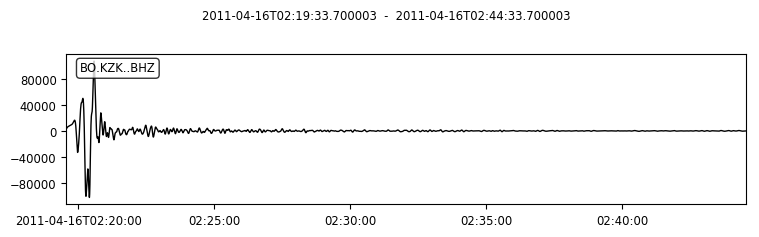

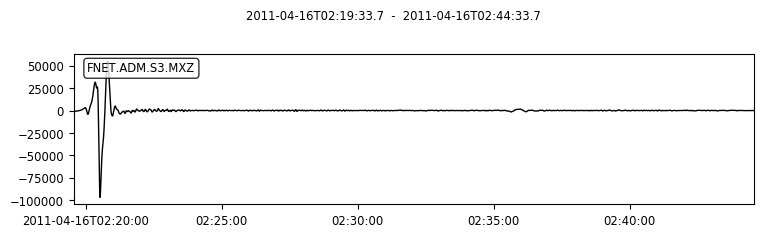

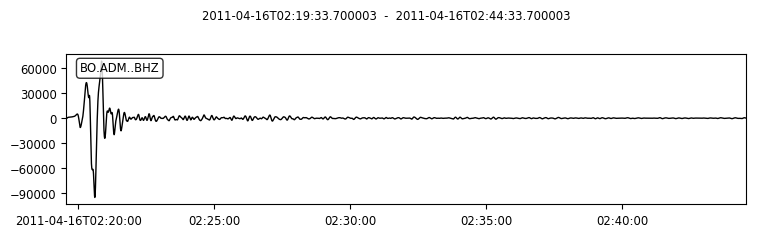

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
6 Trace(s) in Stream:
FNET.TSK.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.ASI.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.YMZ.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.SBT.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.KZK.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.ADM.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples 6 Trace(s) in Stream:
BO.TSK.. | 201

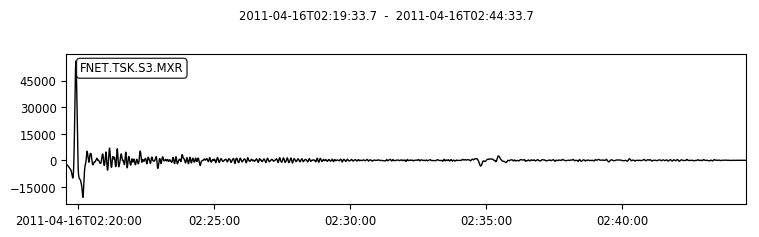

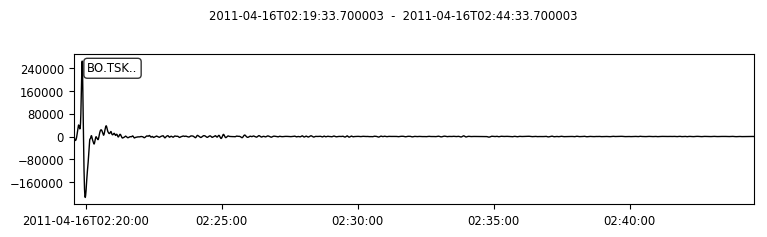

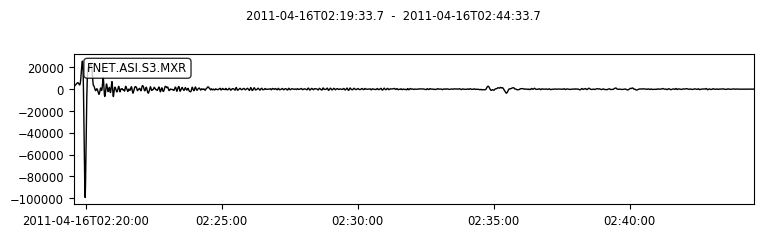

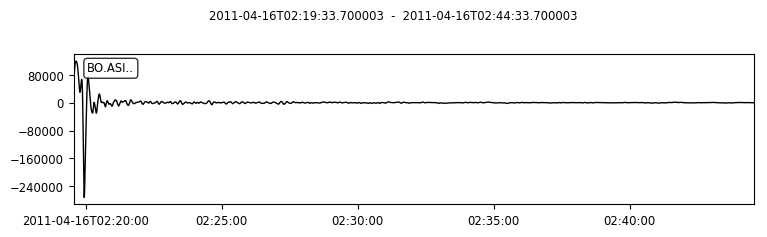

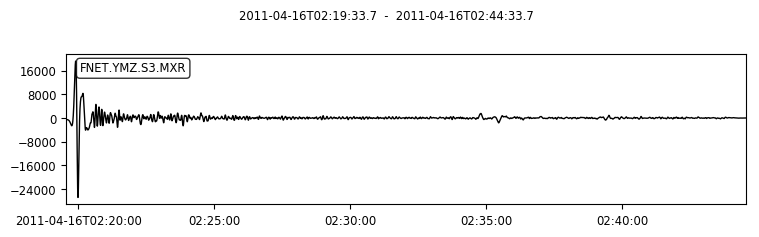

...

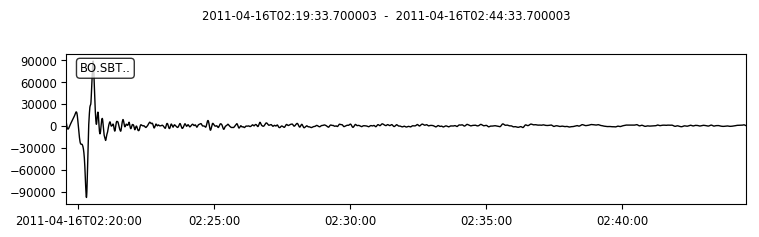

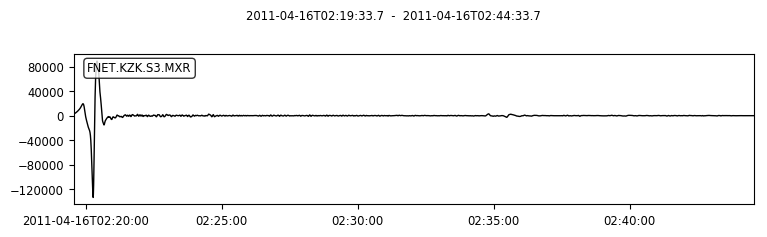

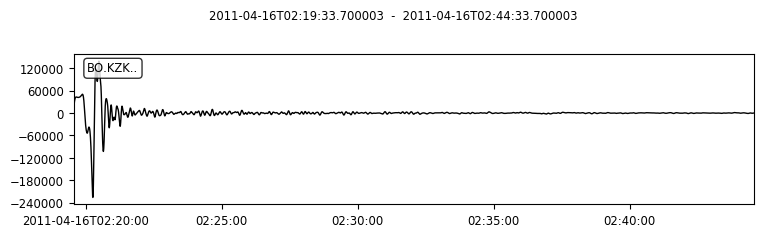

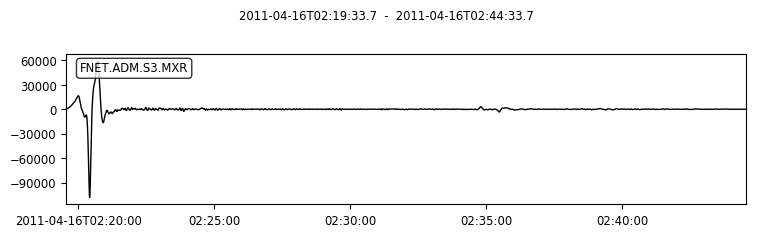

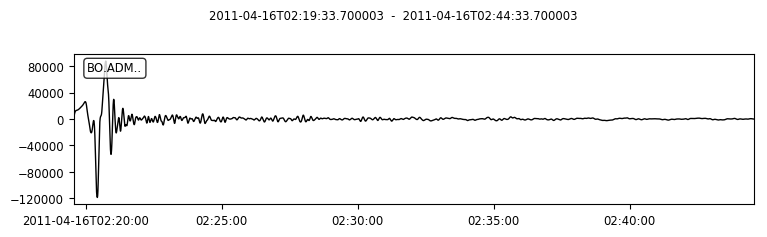

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
6 Trace(s) in Stream:
FNET.TSK.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.ASI.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.YMZ.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.SBT.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.KZK.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
FNET.ADM.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples 6 Trace(s) in Stream:
BO.TSK.. | 201

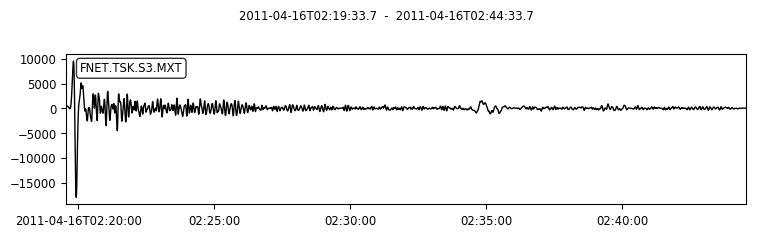

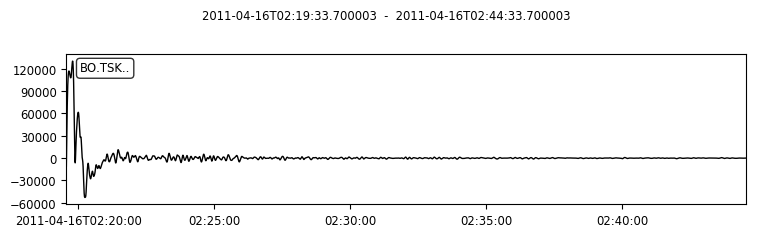

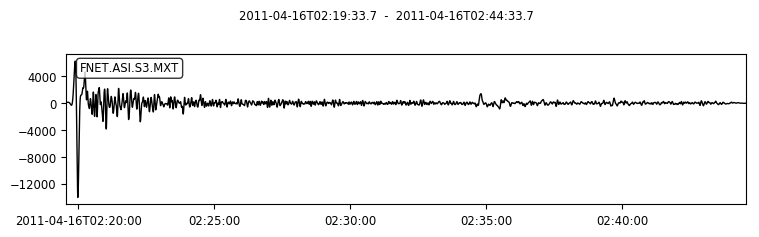

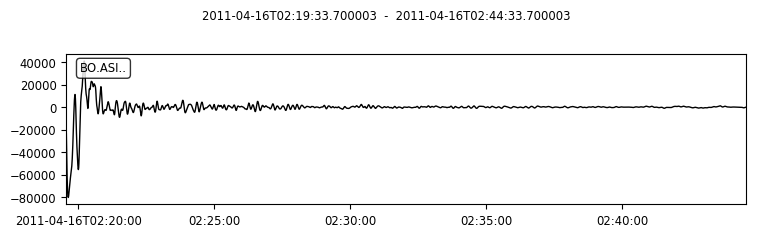

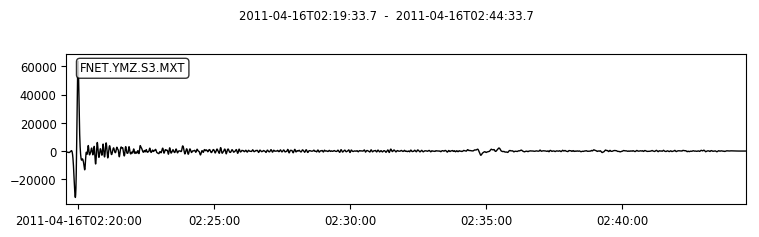

...

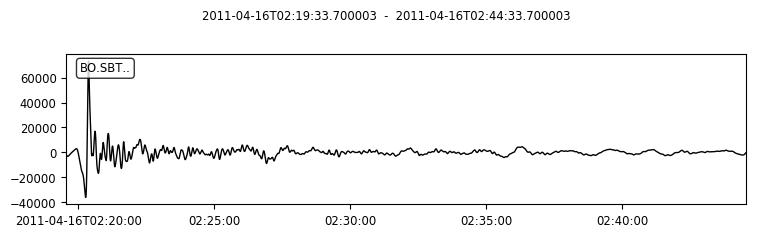

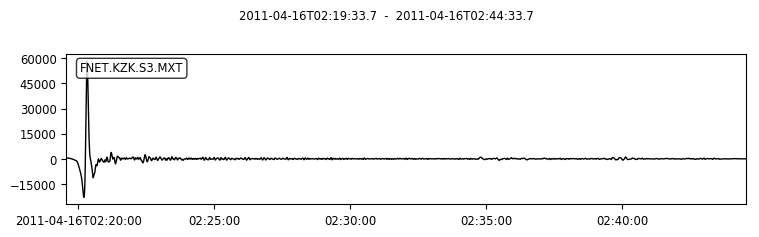

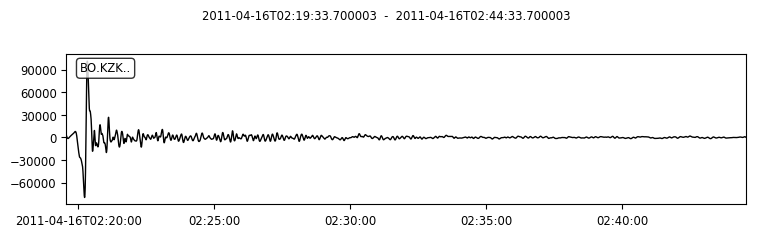

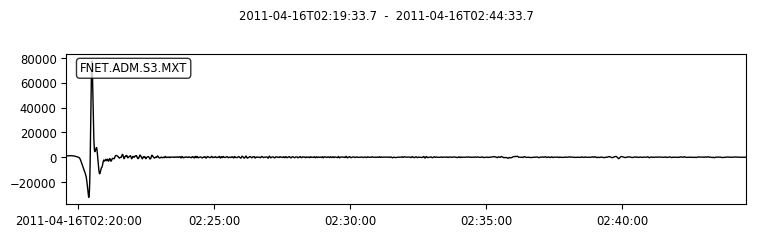

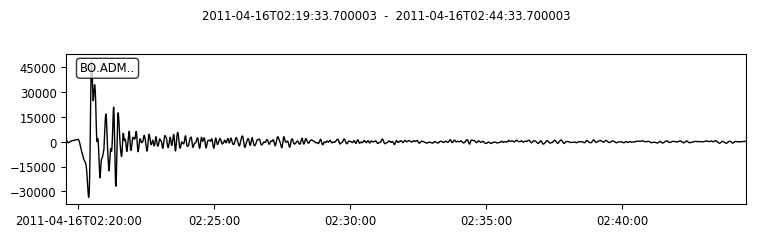

(6 Trace(s) in Stream:
FNET.TSK.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:04.250000Z | 20.0 Hz, 1812 samples
FNET.ASI.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:08.000000Z | 20.0 Hz, 1887 samples
FNET.YMZ.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:08.650000Z | 20.0 Hz, 1900 samples
FNET.SBT.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:31.050000Z | 20.0 Hz, 2348 samples
FNET.KZK.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:27.950000Z | 20.0 Hz, 2286 samples
FNET.ADM.S3.MXT | 2011-04-16T02:19:38.850000Z - 2011-04-16T02:21:38.850000Z | 20.0 Hz, 2401 samples,
 6 Trace(s) in Stream:
BO.TSK.. | 2011-04-16T02:19:33.700003Z - 2011-04-16T02:21:04.250003Z | 20.0 Hz, 1812 samples
BO.ASI.. | 2011-04-16T02:19:33.700003Z - 2011-04-16T02:21:08.000003Z | 20.0 Hz, 1887 samples
BO.YMZ.. | 2011-04-16T02:19:33.700003Z - 2011-04-16T02:21:08.650003Z | 20.0 Hz, 1900 samples
BO.SBT.. | 2011-04-16T02:19:33.700003Z - 2011-04-16T02:21:31.050003Z | 20.

In [184]:
names=["TSK","ASI","YMZ","SBT","KZK","ADM"]
syncz=get_sync("/Users/ziyixi/Datas/poster/sync",names,"Z")
dataz=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"Z")
syncr=get_sync("/Users/ziyixi/Datas/poster/sync",names,"R")
datar=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"R")
synct=get_sync("/Users/ziyixi/Datas/poster/sync",names,"T")
datat=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"T")
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

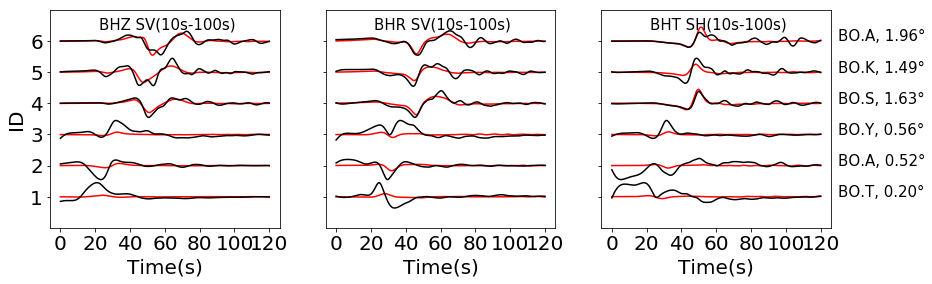

In [185]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,70,0.45,4)

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
8 Trace(s) in Stream:
HL.MIH.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.QTH.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JMS.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YIL.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YCH.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.TUJ.S3.MXZ | 2011-04-16T02:19:33

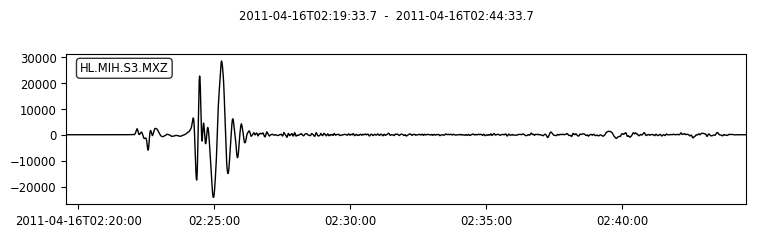

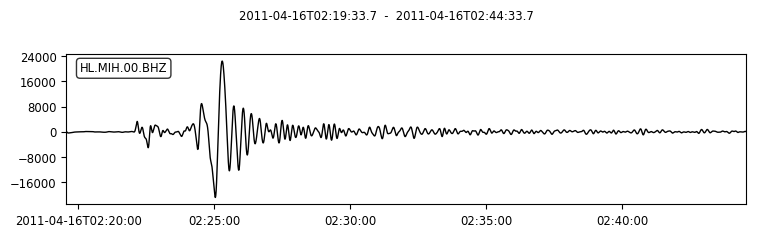

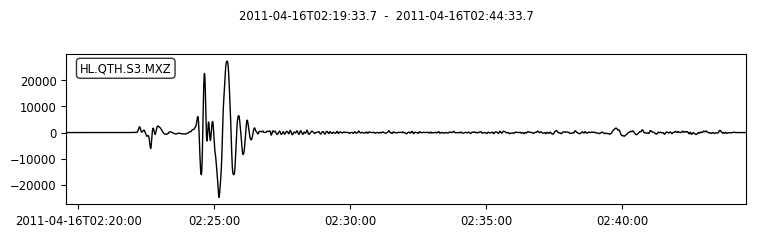

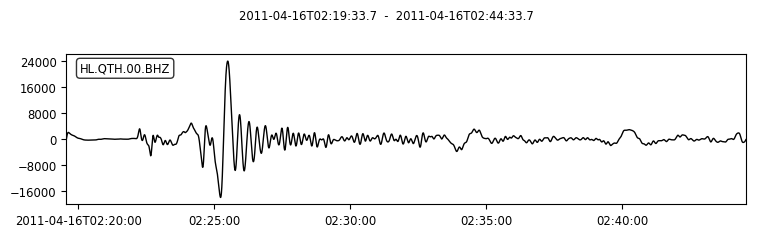

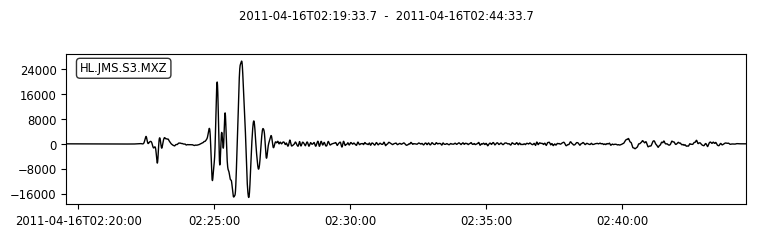

...

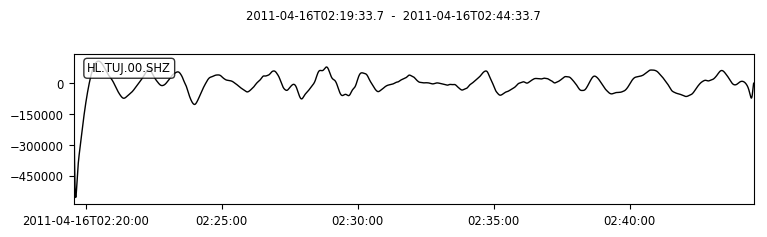

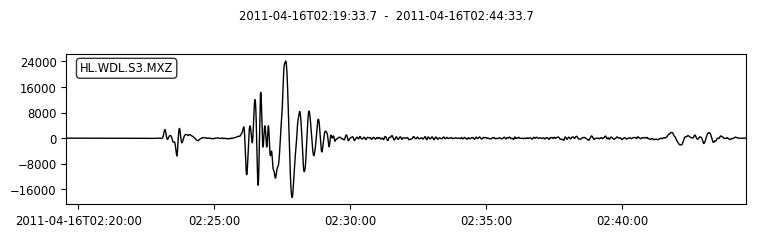

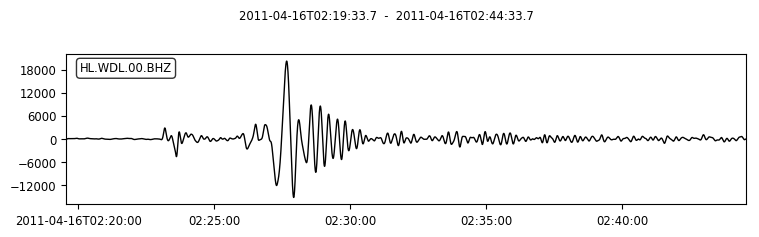

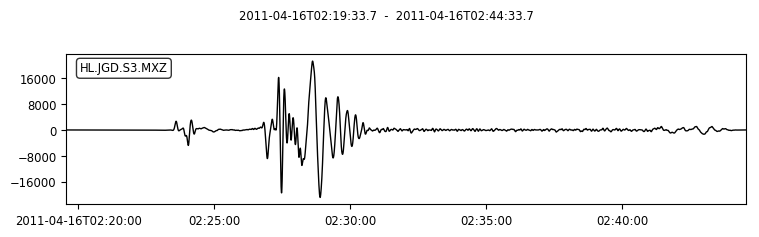

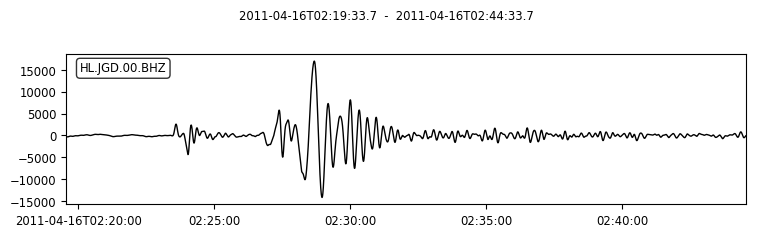

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
8 Trace(s) in Stream:
HL.MIH.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.QTH.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JMS.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YIL.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YCH.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.TUJ.S3.MXR | 2011-04-16T02:19:33

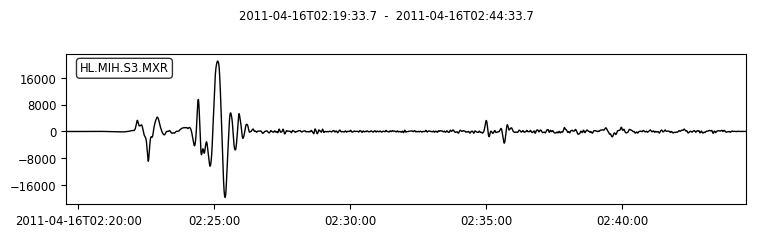

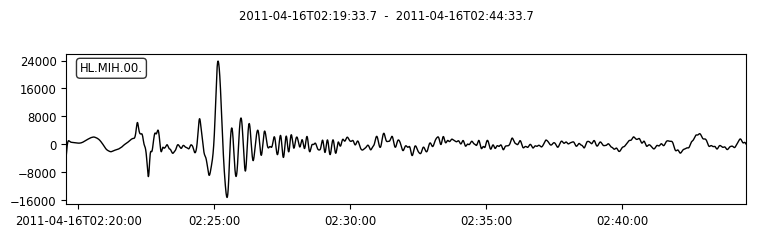

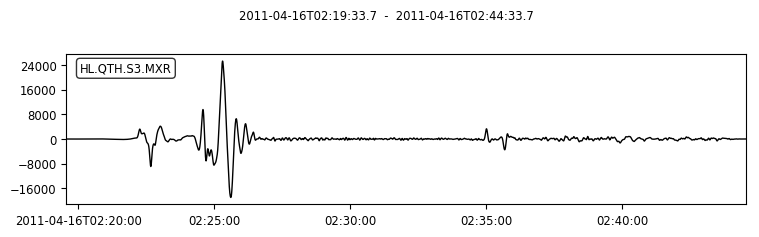

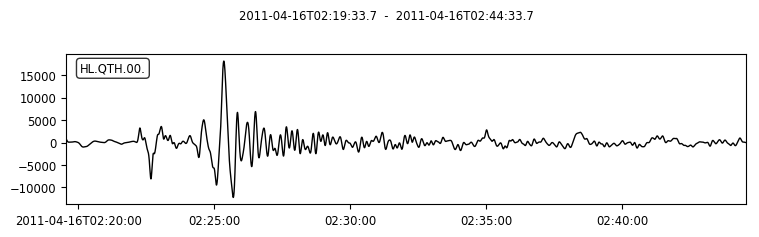

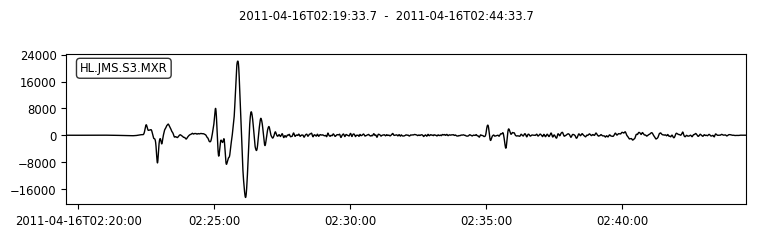

...

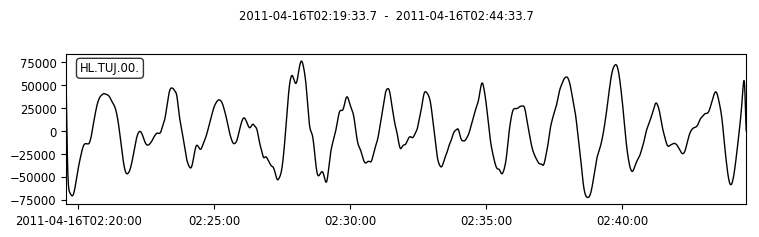

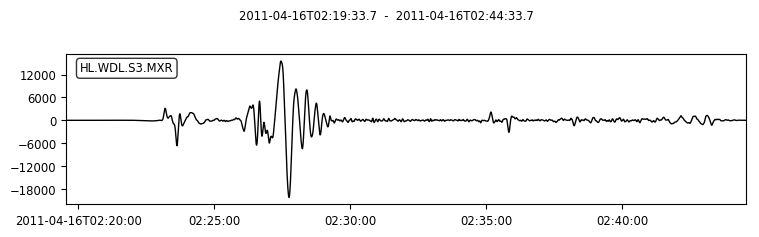

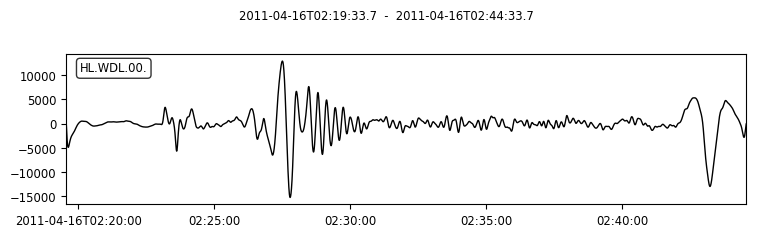

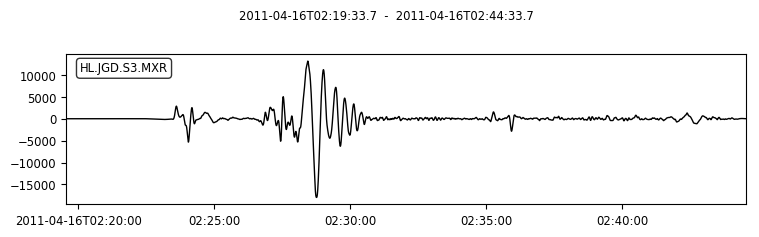

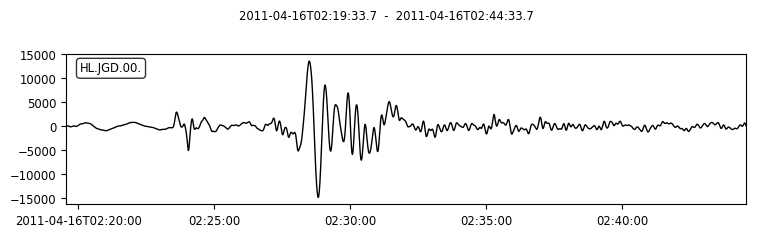

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
8 Trace(s) in Stream:
HL.MIH.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.QTH.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JMS.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YIL.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YCH.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.TUJ.S3.MXT | 2011-04-16T02:19:33

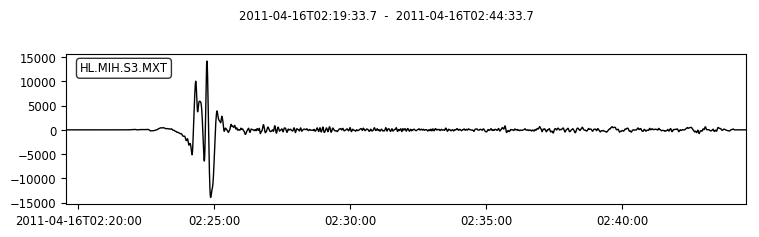

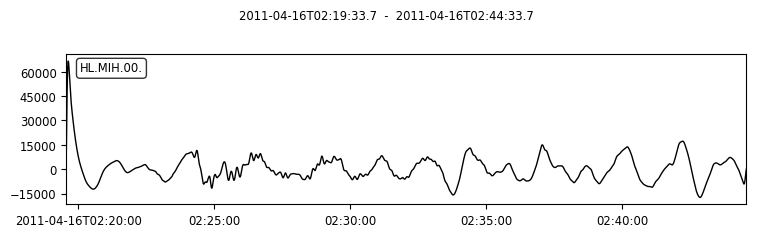

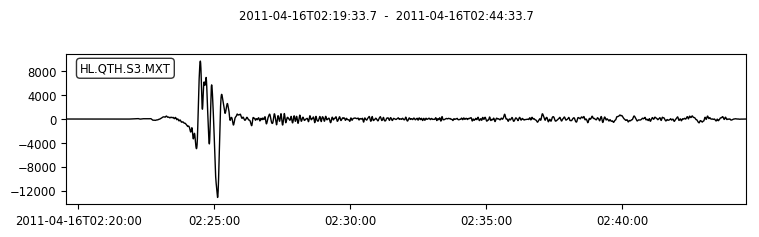

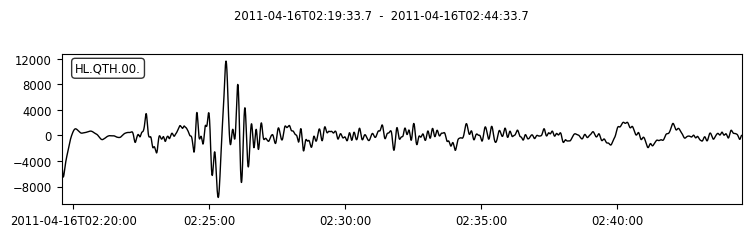

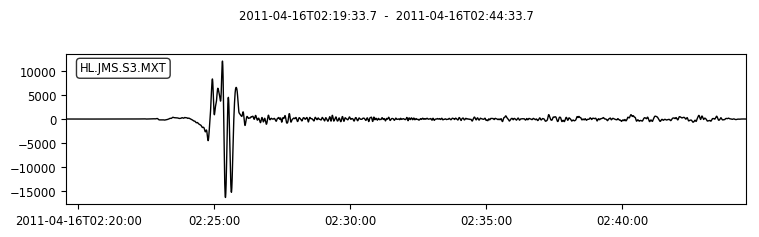

...

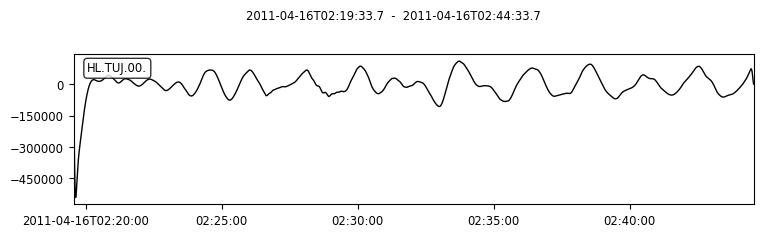

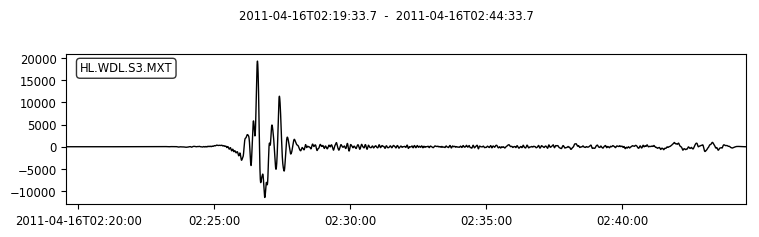

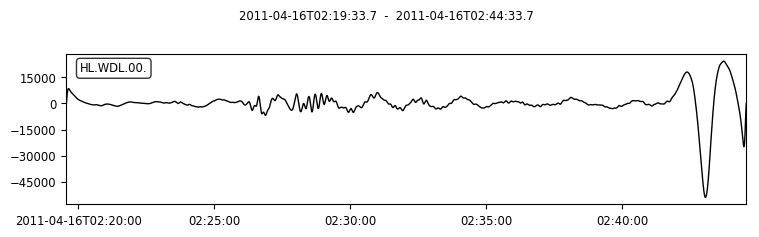

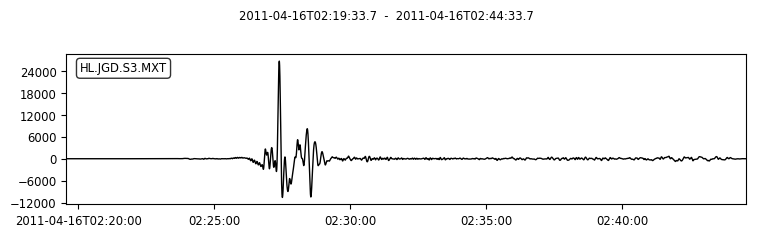

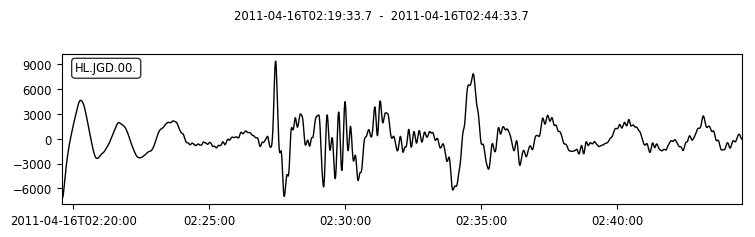

(8 Trace(s) in Stream:
HL.MIH.S3.MXT | 2011-04-16T02:23:21.400000Z - 2011-04-16T02:25:21.400000Z | 20.0 Hz, 2401 samples
HL.QTH.S3.MXT | 2011-04-16T02:23:31.300000Z - 2011-04-16T02:25:31.300000Z | 20.0 Hz, 2401 samples
HL.JMS.S3.MXT | 2011-04-16T02:23:58.050000Z - 2011-04-16T02:25:58.050000Z | 20.0 Hz, 2401 samples
HL.YIL.S3.MXT | 2011-04-16T02:24:04.600000Z - 2011-04-16T02:26:04.600000Z | 20.0 Hz, 2401 samples
HL.YCH.S3.MXT | 2011-04-16T02:24:33.500000Z - 2011-04-16T02:26:33.500000Z | 20.0 Hz, 2401 samples
HL.TUJ.S3.MXT | 2011-04-16T02:25:18.700000Z - 2011-04-16T02:27:18.700000Z | 20.0 Hz, 2401 samples
HL.WDL.S3.MXT | 2011-04-16T02:25:18.700000Z - 2011-04-16T02:27:18.700000Z | 20.0 Hz, 2401 samples
HL.JGD.S3.MXT | 2011-04-16T02:26:09.500000Z - 2011-04-16T02:28:09.500000Z | 20.0 Hz, 2401 samples,
 8 Trace(s) in Stream:
HL.MIH.00. | 2011-04-16T02:23:21.420000Z - 2011-04-16T02:25:21.420000Z | 100.0 Hz, 12001 samples
HL.QTH.00. | 2011-04-16T02:23:31.290000Z - 2011-04-16T02:25:31.290000Z |

In [145]:
names=["MIH","QTH","JMS","YIL","YCH","TUJ","WDL","JGD"]
network=["HL","HL","HL","HL","HL","HL","HL","HL"]
syncz=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"Z",network)
dataz=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"Z",network)
syncr=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"R",network)
datar=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"R",network)
synct=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"T",network)
datat=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"T",network)
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

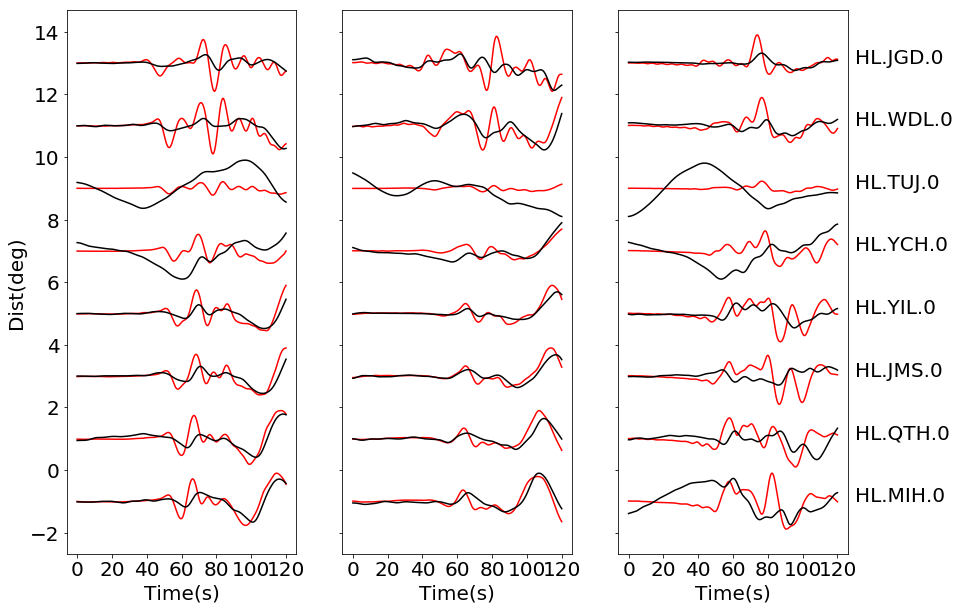

In [89]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,70,0.9,10)

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
6 Trace(s) in Stream:
HL.MIH.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.QTH.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JMS.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YIL.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.WDL.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JGD.S3.MXZ | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples 6 Trace(s) in Stream:
HL.MIH.00.BHZ | 2011-04-16

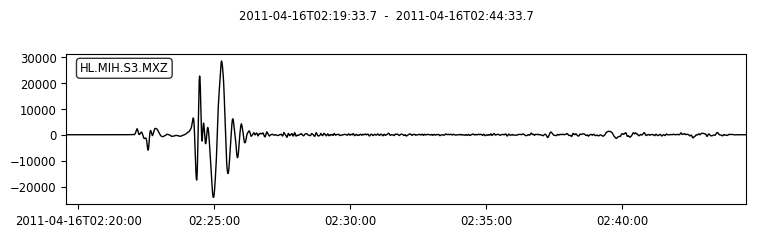

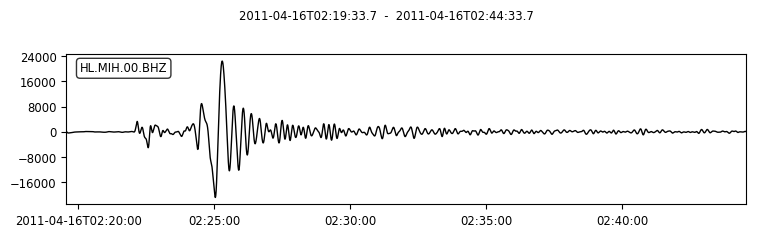

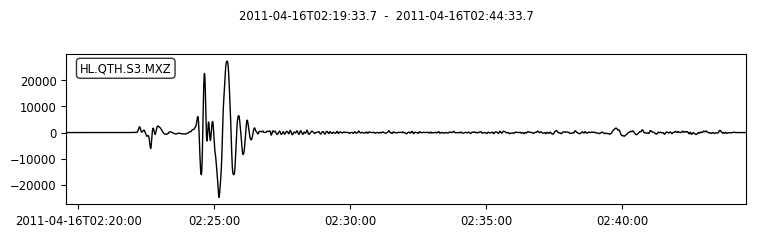

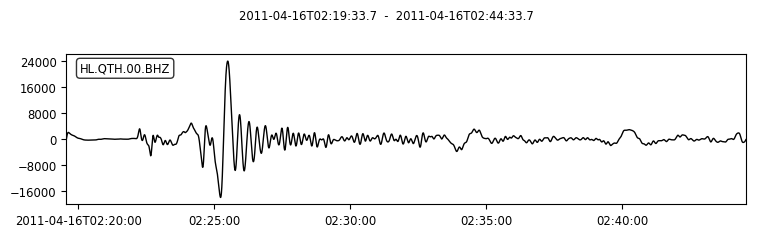

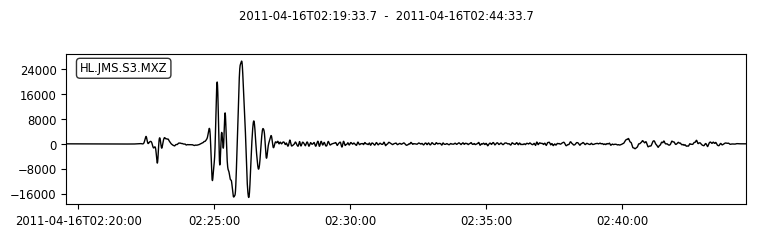

...

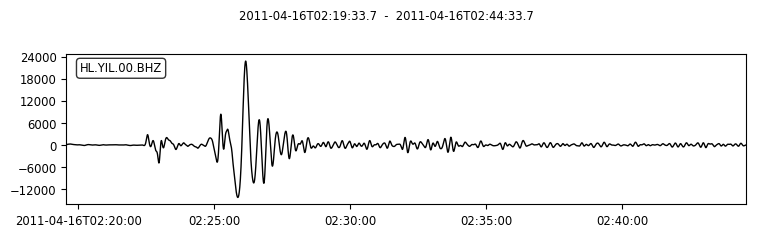

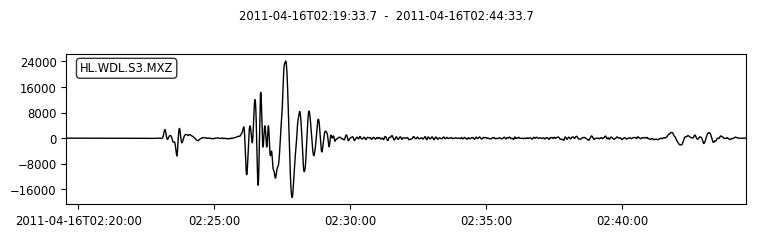

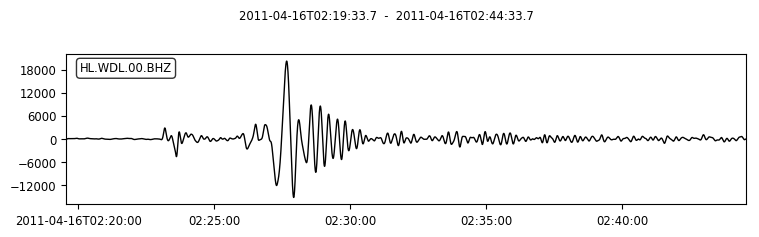

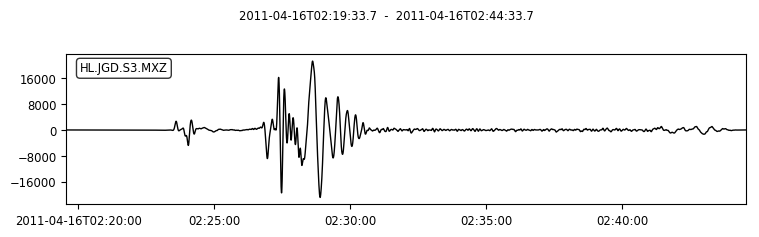

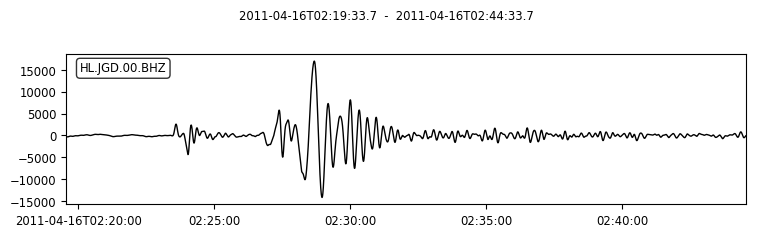

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
6 Trace(s) in Stream:
HL.MIH.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.QTH.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JMS.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YIL.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.WDL.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JGD.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples 6 Trace(s) in Stream:
HL.MIH.00. | 2011-04-16T02

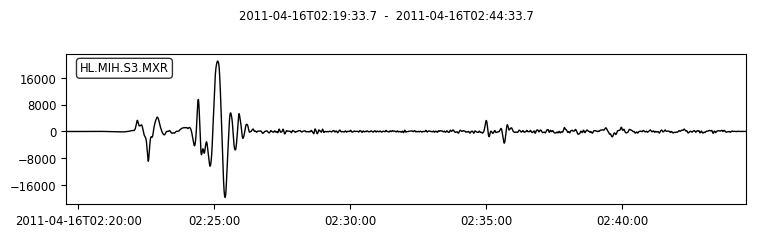

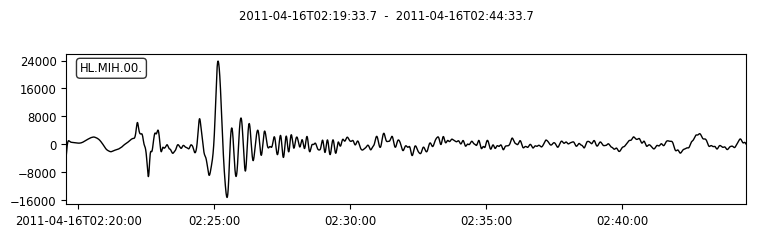

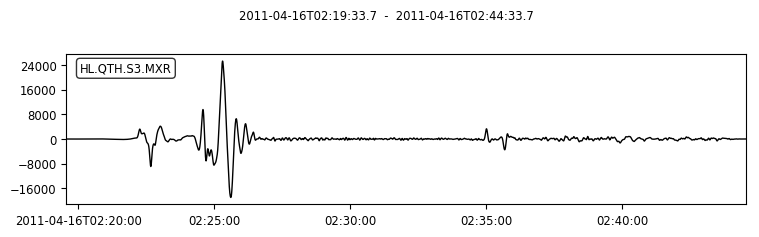

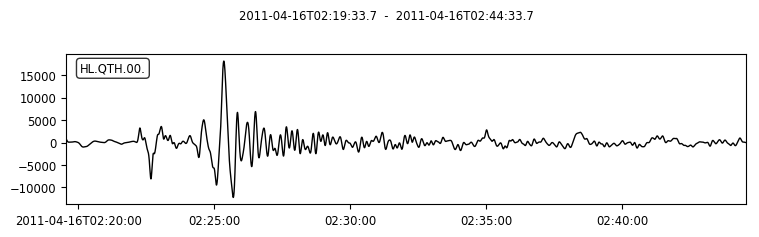

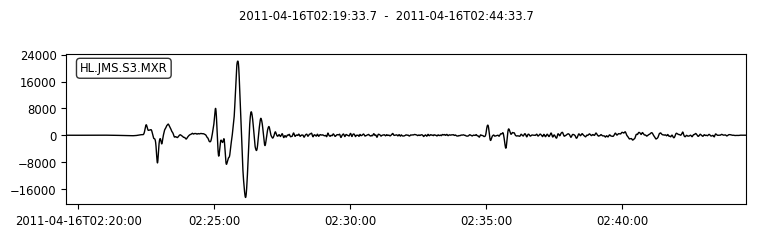

...

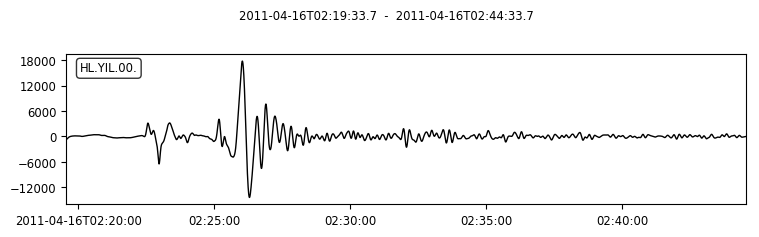

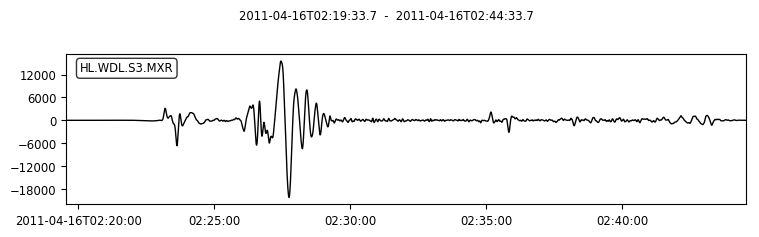

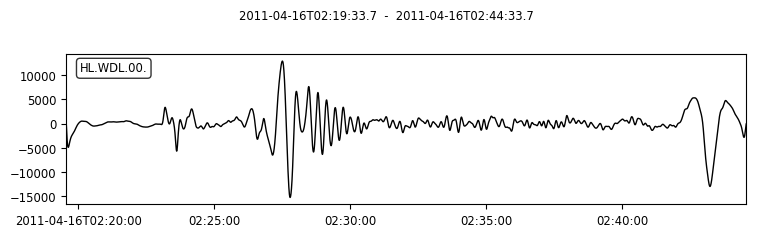

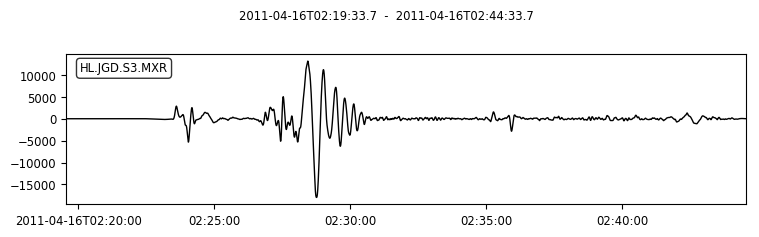

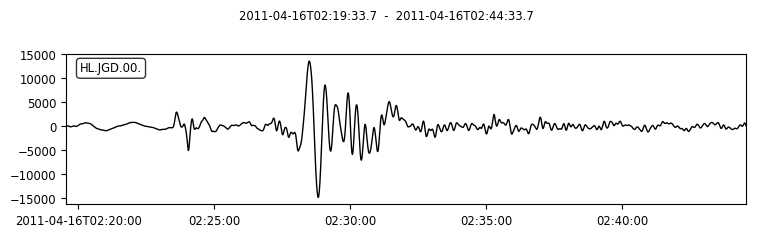

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
6 Trace(s) in Stream:
HL.MIH.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.QTH.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JMS.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.YIL.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.WDL.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.JGD.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples 6 Trace(s) in Stream:
HL.MIH.00. | 2011-04-16T02

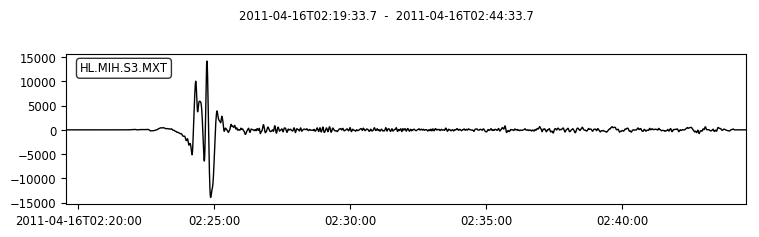

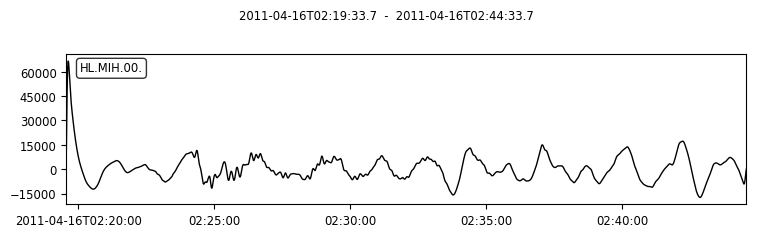

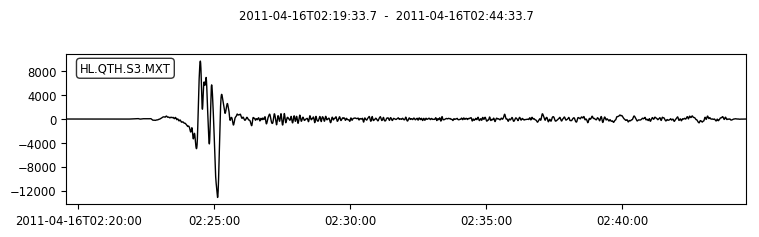

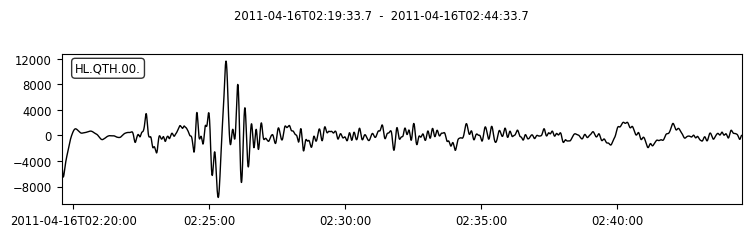

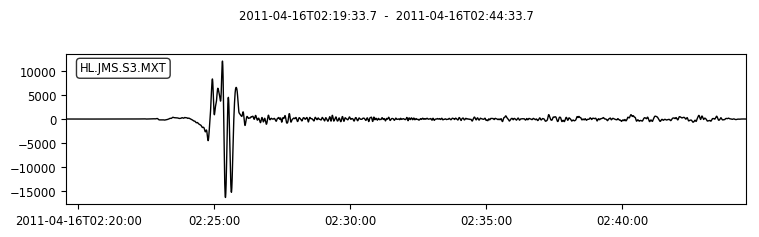

...

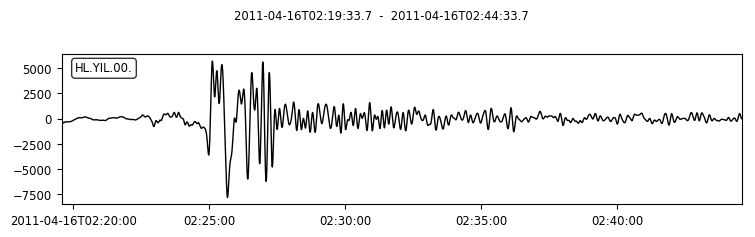

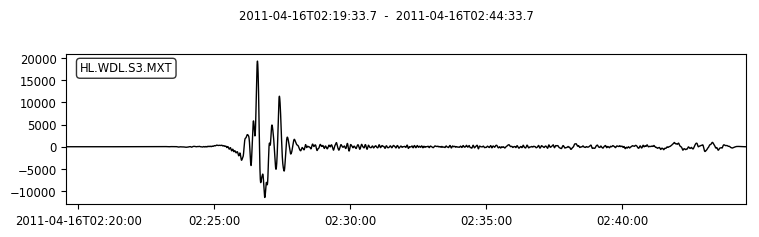

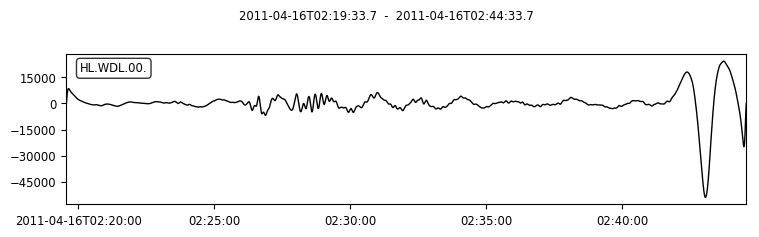

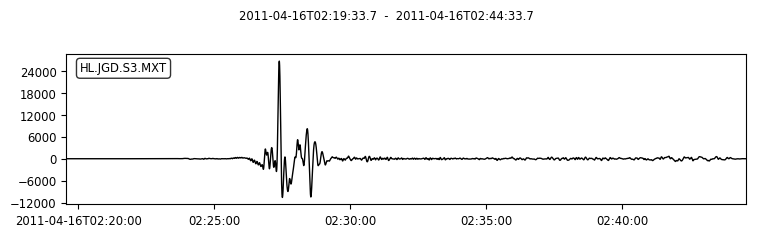

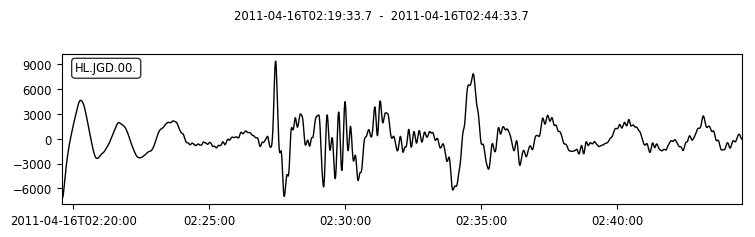

(6 Trace(s) in Stream:
HL.MIH.S3.MXT | 2011-04-16T02:23:21.400000Z - 2011-04-16T02:25:21.400000Z | 20.0 Hz, 2401 samples
HL.QTH.S3.MXT | 2011-04-16T02:23:31.300000Z - 2011-04-16T02:25:31.300000Z | 20.0 Hz, 2401 samples
HL.JMS.S3.MXT | 2011-04-16T02:23:58.050000Z - 2011-04-16T02:25:58.050000Z | 20.0 Hz, 2401 samples
HL.YIL.S3.MXT | 2011-04-16T02:24:04.600000Z - 2011-04-16T02:26:04.600000Z | 20.0 Hz, 2401 samples
HL.WDL.S3.MXT | 2011-04-16T02:25:18.700000Z - 2011-04-16T02:27:18.700000Z | 20.0 Hz, 2401 samples
HL.JGD.S3.MXT | 2011-04-16T02:26:09.500000Z - 2011-04-16T02:28:09.500000Z | 20.0 Hz, 2401 samples,
 6 Trace(s) in Stream:
HL.MIH.00. | 2011-04-16T02:23:21.420000Z - 2011-04-16T02:25:21.420000Z | 100.0 Hz, 12001 samples
HL.QTH.00. | 2011-04-16T02:23:31.290000Z - 2011-04-16T02:25:31.290000Z | 100.0 Hz, 12001 samples
HL.JMS.00. | 2011-04-16T02:23:58.050000Z - 2011-04-16T02:25:58.050000Z | 100.0 Hz, 12001 samples
HL.YIL.00. | 2011-04-16T02:24:04.580000Z - 2011-04-16T02:26:04.580000Z | 1

In [189]:
names=["MIH","QTH","JMS","YIL","WDL","JGD"]
network=["HL","HL","HL","HL","HL","HL","HL","HL"]
syncz=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"Z",network)
dataz=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"Z",network)
syncr=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"R",network)
datar=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"R",network)
synct=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"T",network)
datat=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"T",network)
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

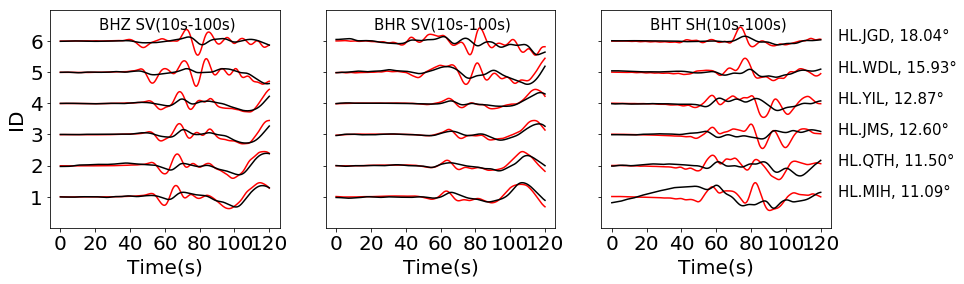

In [190]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,70,0.45,4)

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

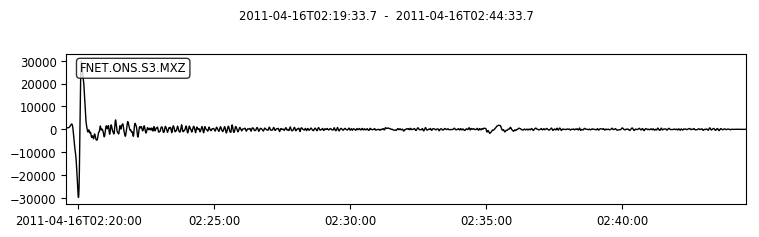

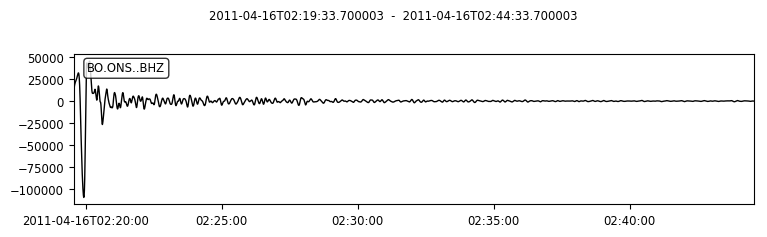

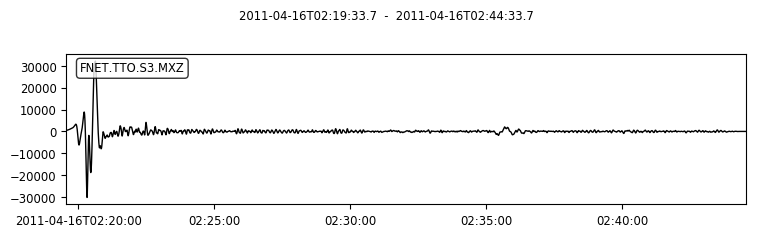

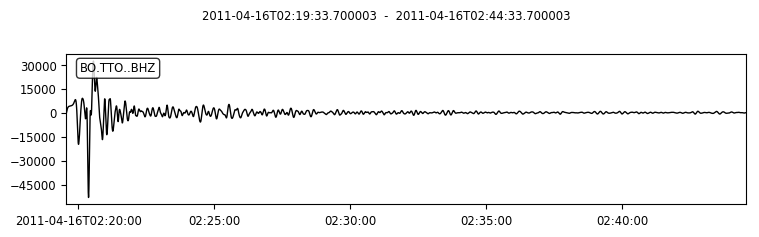

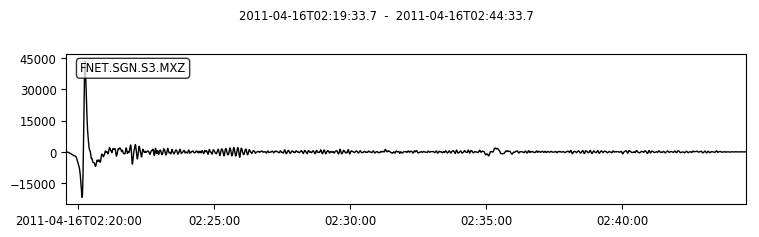

...

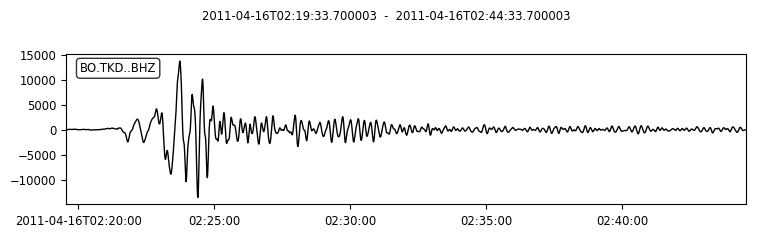

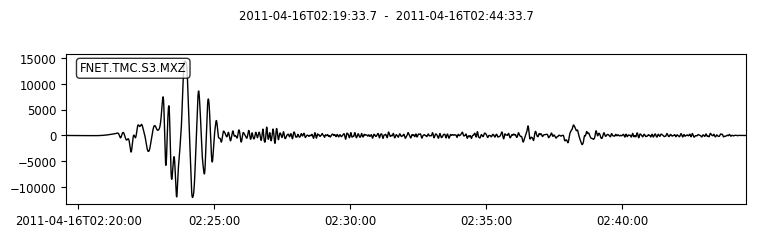

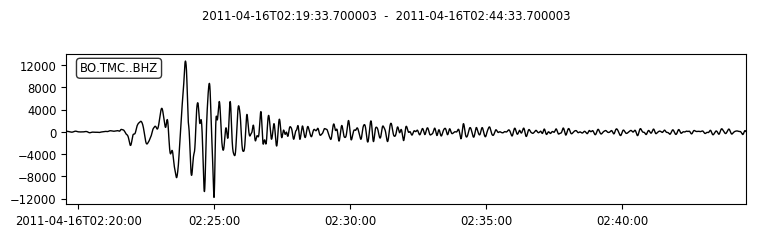

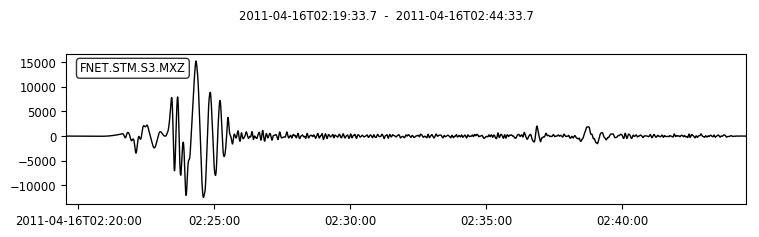

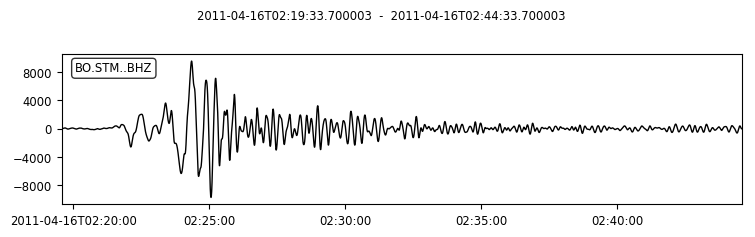

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

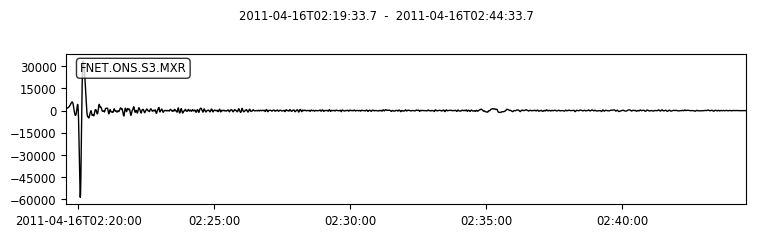

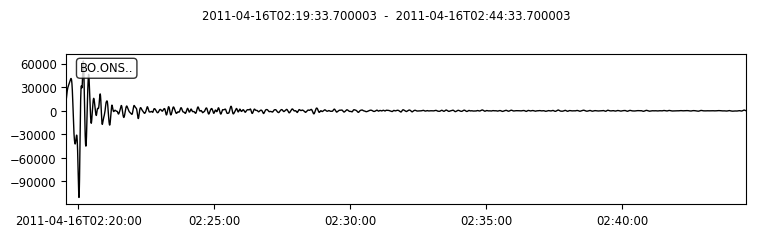

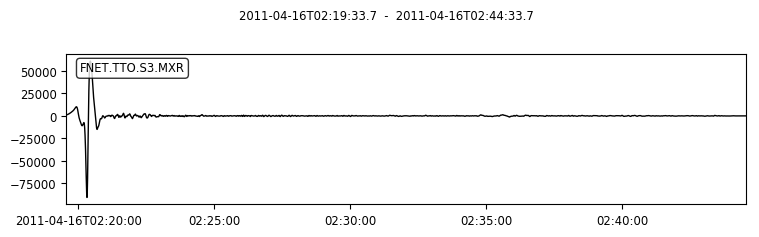

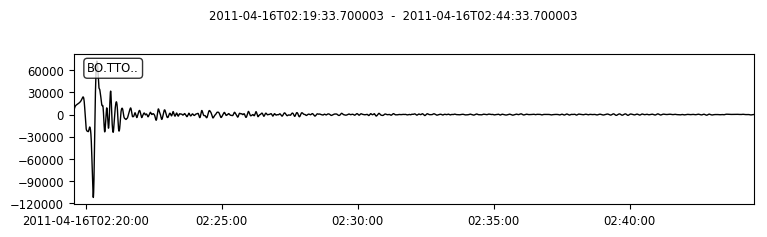

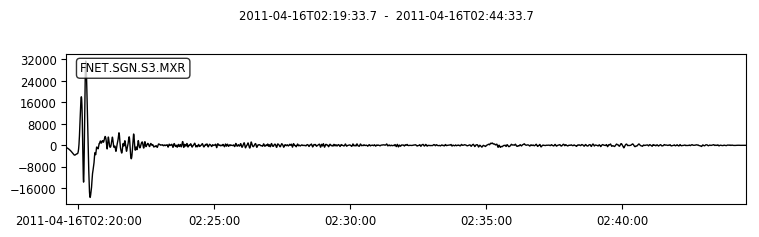

...

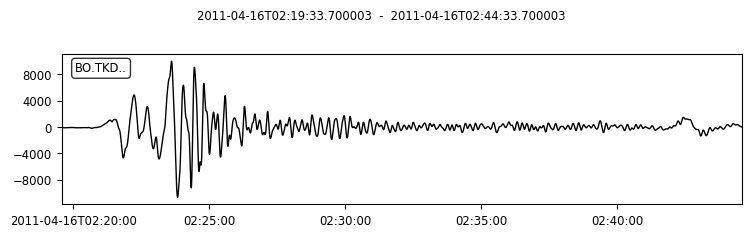

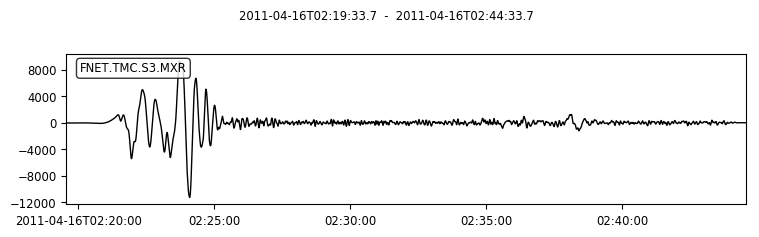

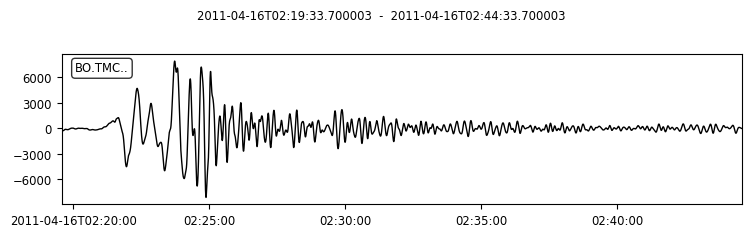

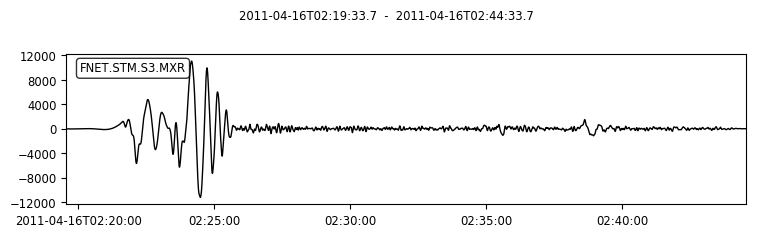

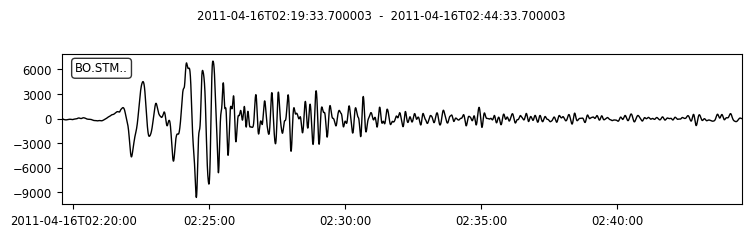

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

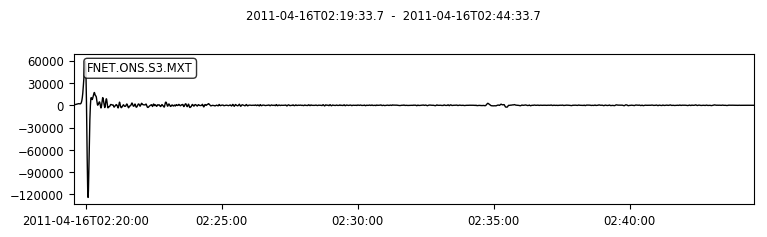

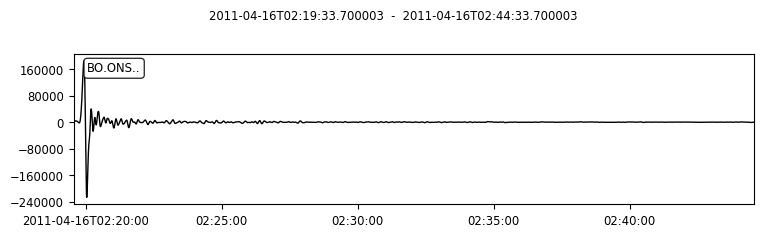

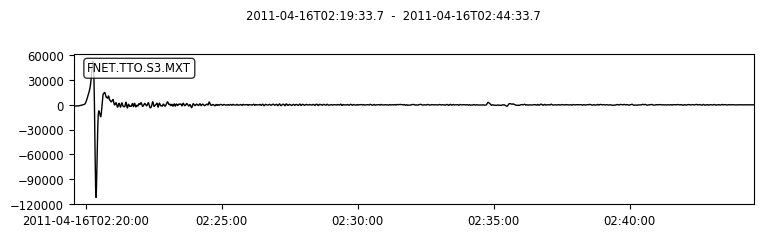

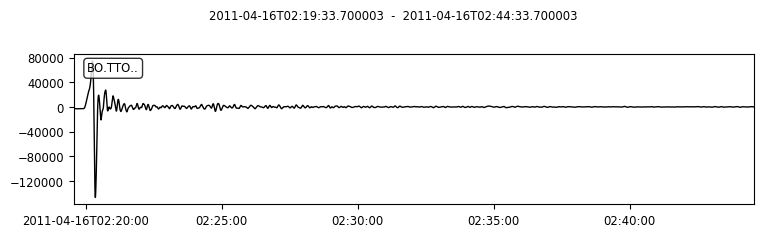

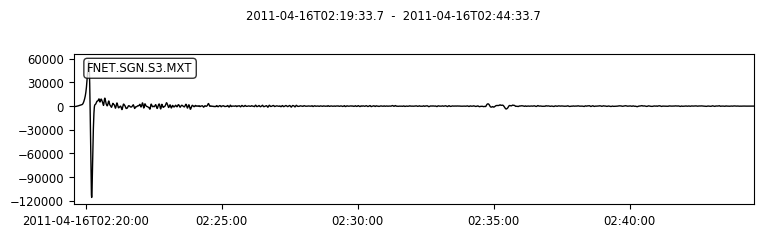

...

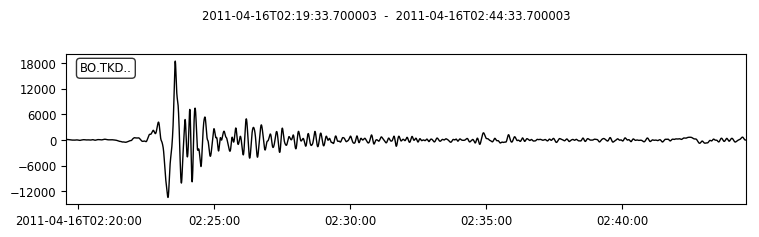

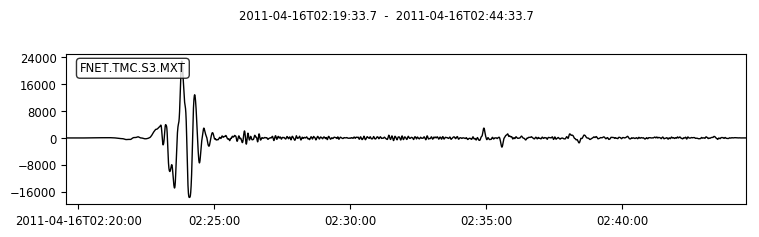

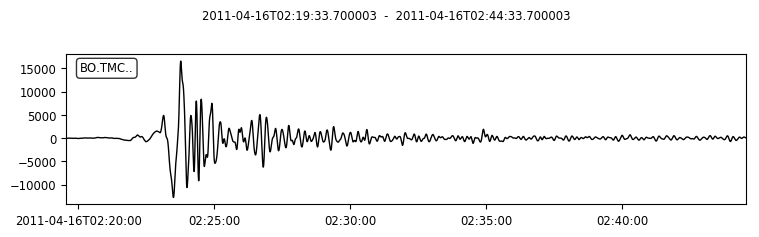

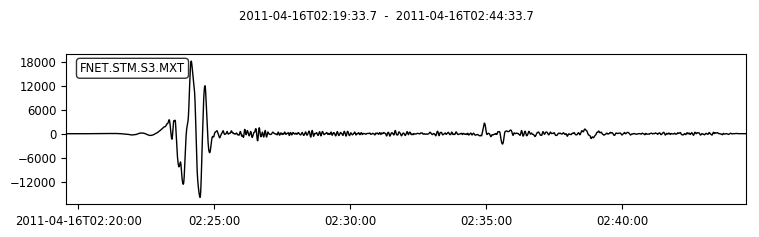

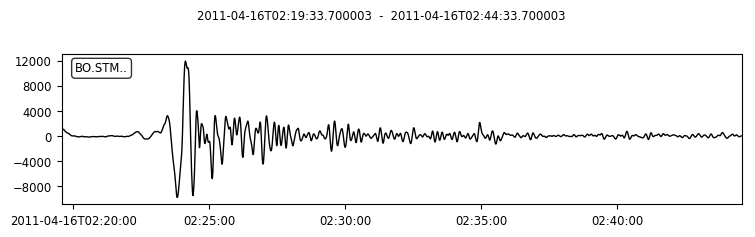

(19 Trace(s) in Stream:
FNET.ONS.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:14.100000Z | 20.0 Hz, 2009 samples
FNET.TTO.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:30.950000Z | 20.0 Hz, 2346 samples
FNET.SGN.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:21:22.100000Z | 20.0 Hz, 2169 samples
FNET.KNM.S3.MXT | 2011-04-16T02:19:49.100000Z - 2011-04-16T02:21:49.100000Z | 20.0 Hz, 2401 samples
FNET.NAA.S3.MXT | 2011-04-16T02:19:50.500000Z - 2011-04-16T02:21:50.500000Z | 20.0 Hz, 2401 samples
FNET.TGA.S3.MXT | 2011-04-16T02:20:09.150000Z - 2011-04-16T02:22:09.150000Z | 20.0 Hz, 2401 samples
FNET.YAS.S3.MXT | 2011-04-16T02:20:28.050000Z - 2011-04-16T02:22:28.050000Z | 20.0 Hz, 2401 samples
FNET.YZK.S3.MXT | 2011-04-16T02:20:45.150000Z - 2011-04-16T02:22:45.150000Z | 20.0 Hz, 2401 samples
FNET.ABU.S3.MXT | 2011-04-16T02:20:26.300000Z - 2011-04-16T02:22:26.300000Z | 20.0 Hz, 2401 samples
FNET.NRW.S3.MXT | 2011-04-16T02:21:05.300000Z - 2011-04-16T02:23:05.300000Z 

In [191]:
# names=["HRO","YMZ","ASI","TSK","ONS","TTO","SGN","KNM","NAA","TGA","YAS","YZK","ABU","NRW","ISI","NSK","TGW","OKW","INN","SBR","TKD","TMC","STM"]
names=["ONS","TTO","SGN","KNM","NAA","TGA","YAS","YZK","ABU","NRW","ISI","NSK","TGW","OKW","INN","SBR","TKD","TMC","STM"]
syncz=get_sync("/Users/ziyixi/Datas/poster/sync",names,"Z")
dataz=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"Z")
syncr=get_sync("/Users/ziyixi/Datas/poster/sync",names,"R")
datar=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"R")
synct=get_sync("/Users/ziyixi/Datas/poster/sync",names,"T")
datat=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"T")
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

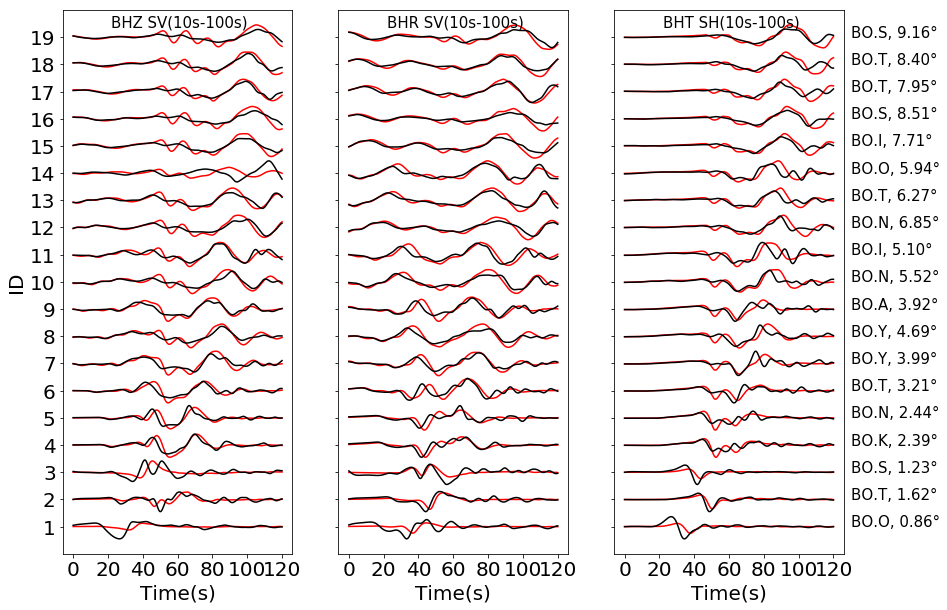

In [192]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,70,0.45,10)

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

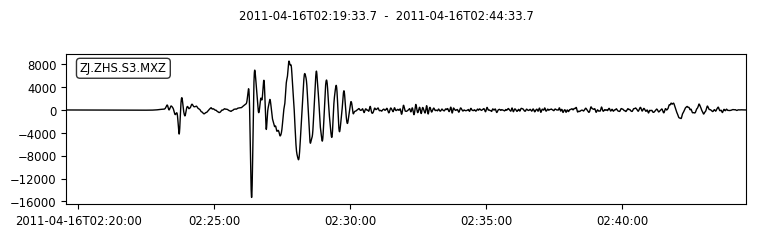

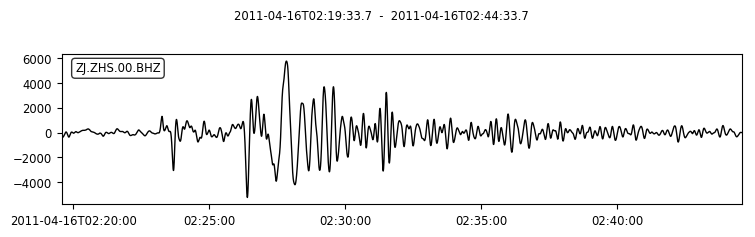

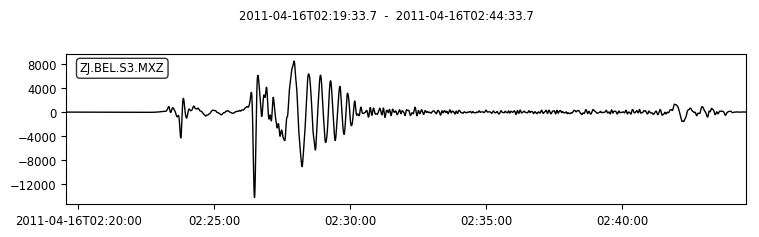

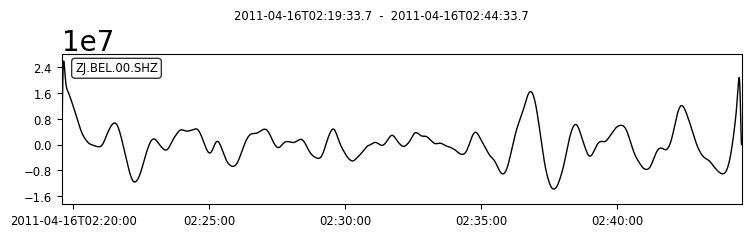

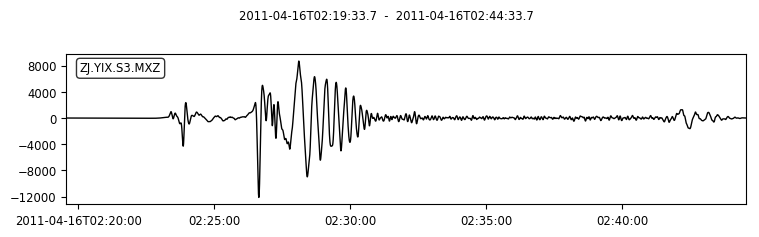

...

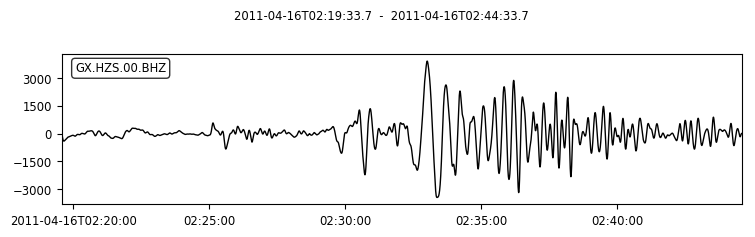

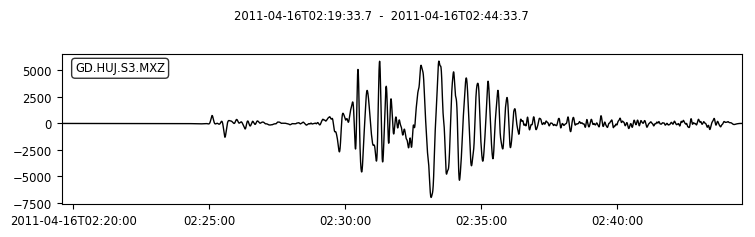

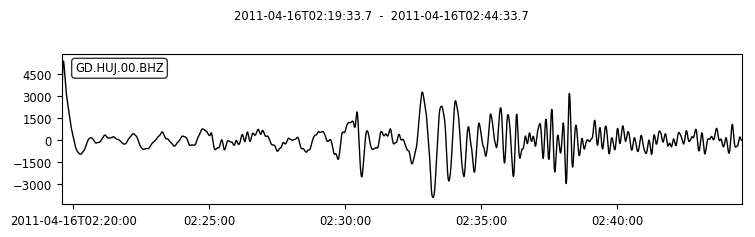

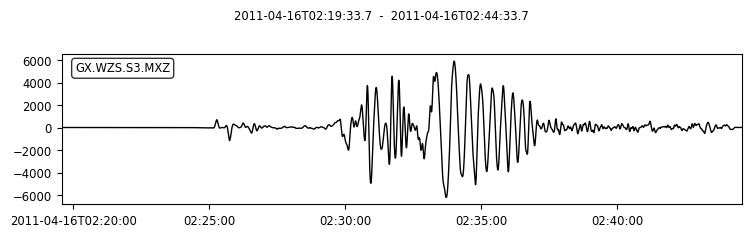

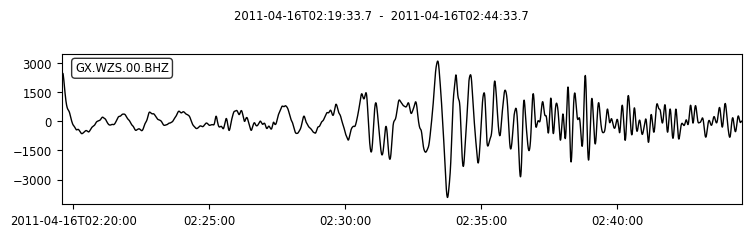

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

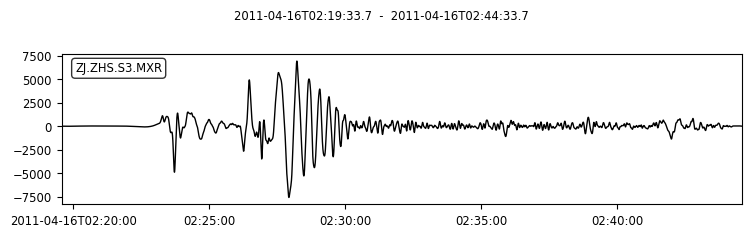

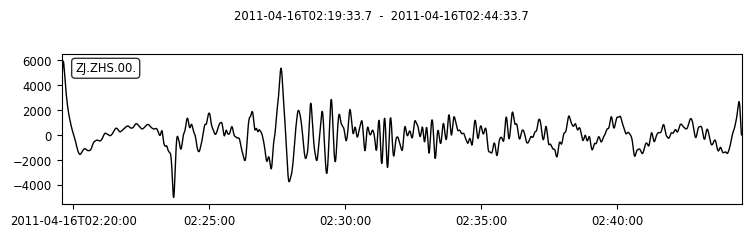

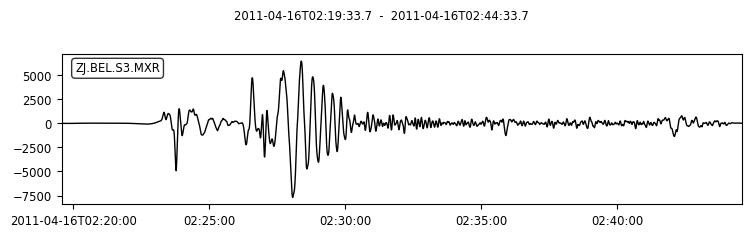

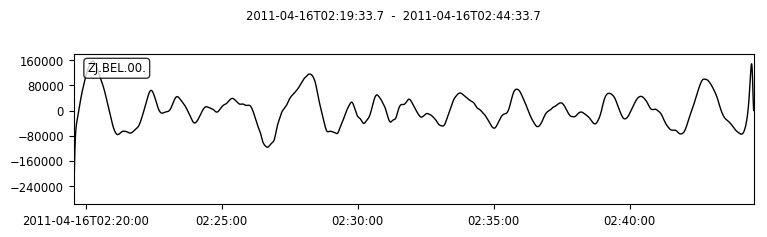

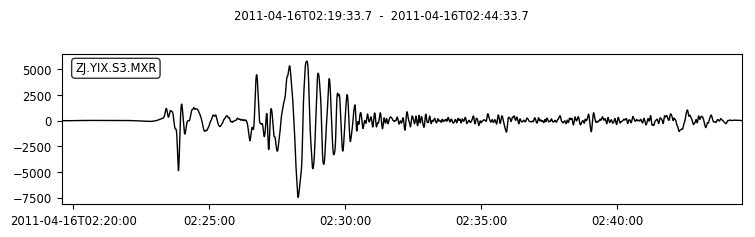

...

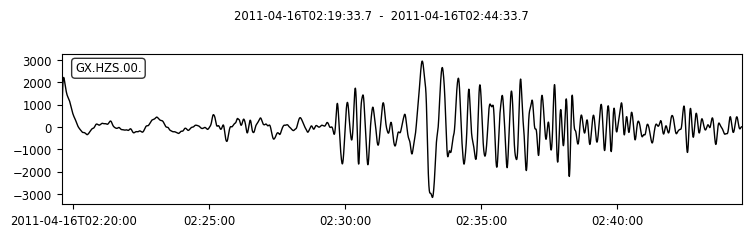

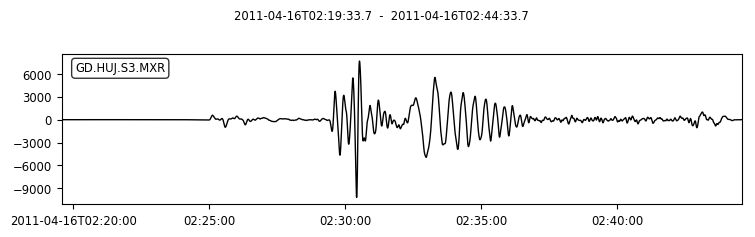

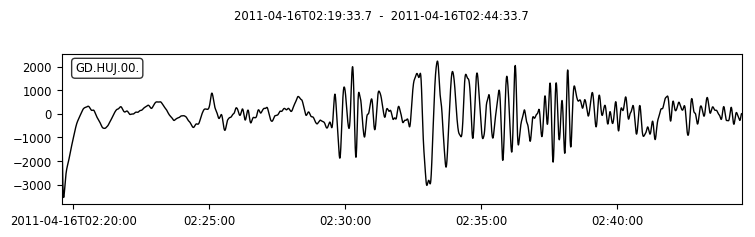

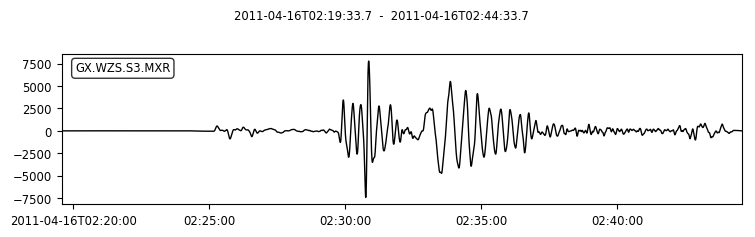

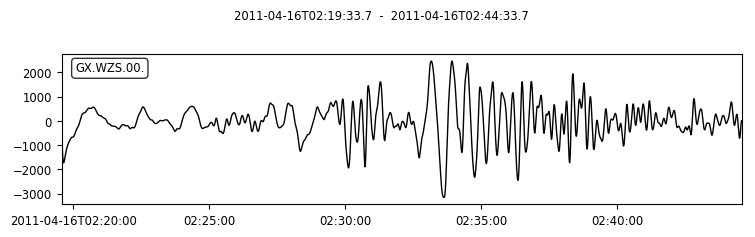

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

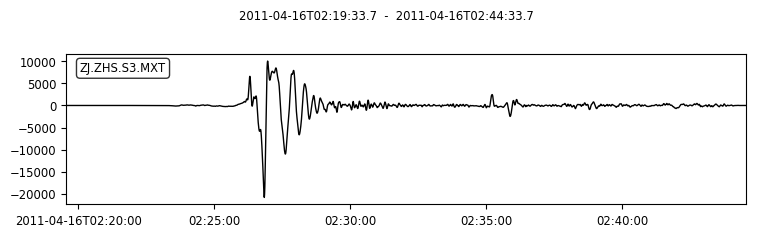

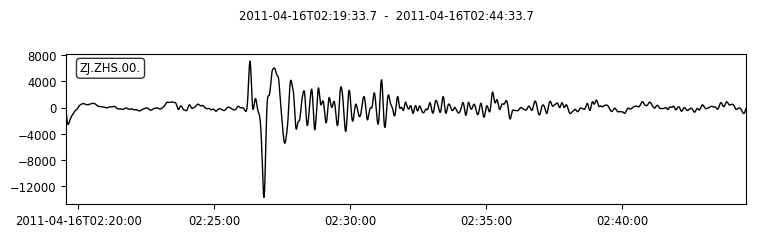

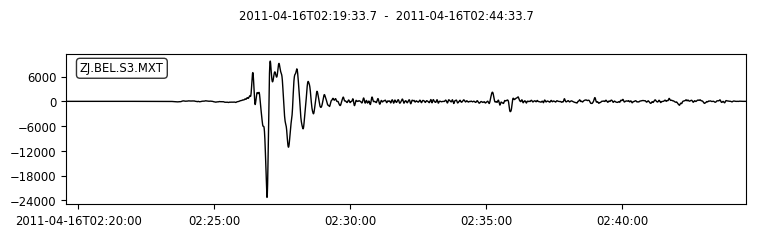

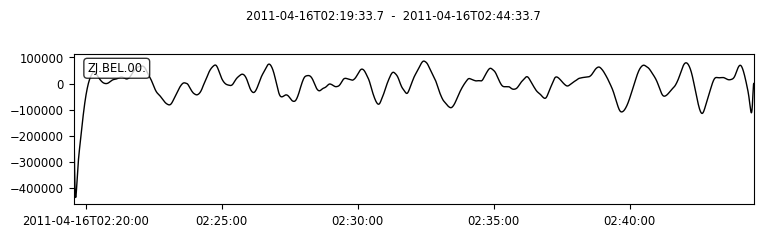

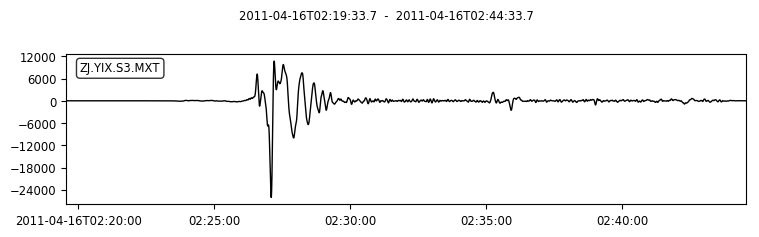

...

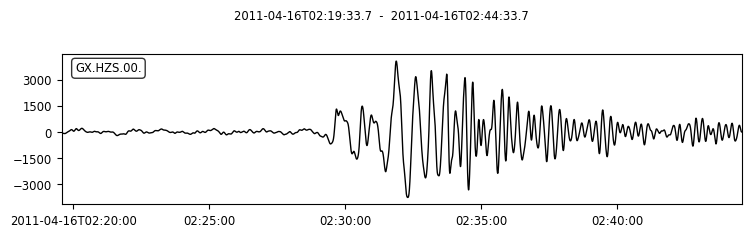

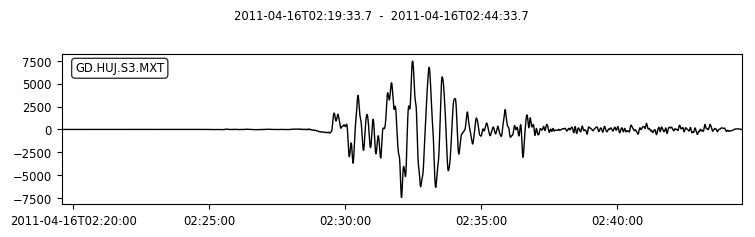

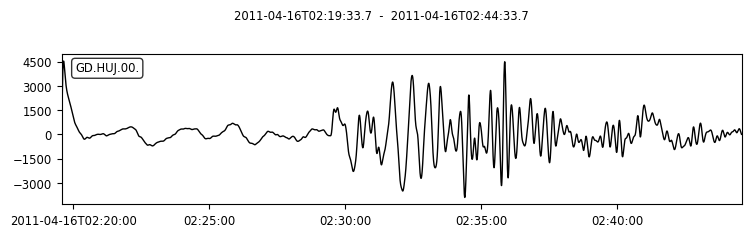

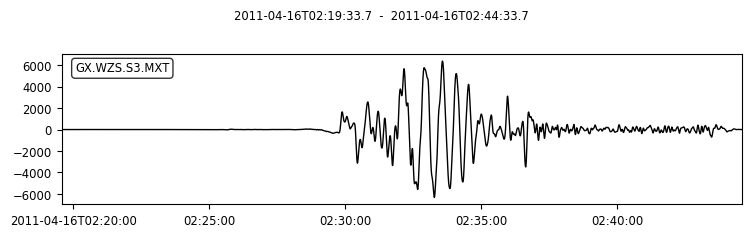

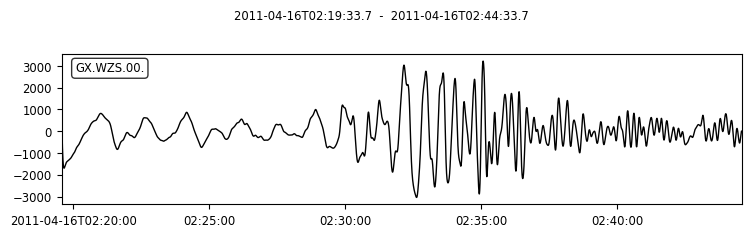

(23 Trace(s) in Stream:

ZJ.ZHS.S3.MXT | 2011-04-16T02:25:26.550000Z - 2011-04-16T02:27:26.550000Z | 20.0 Hz, 2401 samples
...
(21 other traces)
...
GX.WZS.S3.MXT | 2011-04-16T02:29:04.450000Z - 2011-04-16T02:31:04.450000Z | 20.0 Hz, 2401 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces],
 23 Trace(s) in Stream:

ZJ.ZHS.00. | 2011-04-16T02:25:26.540000Z - 2011-04-16T02:27:26.540000Z | 100.0 Hz, 12001 samples
...
(21 other traces)
...
GX.WZS.00. | 2011-04-16T02:29:04.450000Z - 2011-04-16T02:31:04.450000Z | 100.0 Hz, 12001 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces])

In [96]:
names=["ZHS","BEL","YIX","XIC","TIT","YUQ","WEZ","JIN","PCNP","TNSC","NPDK","MXXF","CTTZ","HUC","DAY","ANY","LON","SHG","LIZ","YND","HZS","HUJ","WZS"]
network=["ZJ","ZJ","ZJ","ZJ","ZJ","ZJ","ZJ","ZJ","FJ","FJ","FJ","FJ","FJ","JX","JX","JX","JX","GD","GD","GD","GX","GD","GX"]
syncz=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"Z",network)
dataz=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"Z",network)
syncr=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"R",network)
datar=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"R",network)
synct=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"T",network)
datat=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"T",network)
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

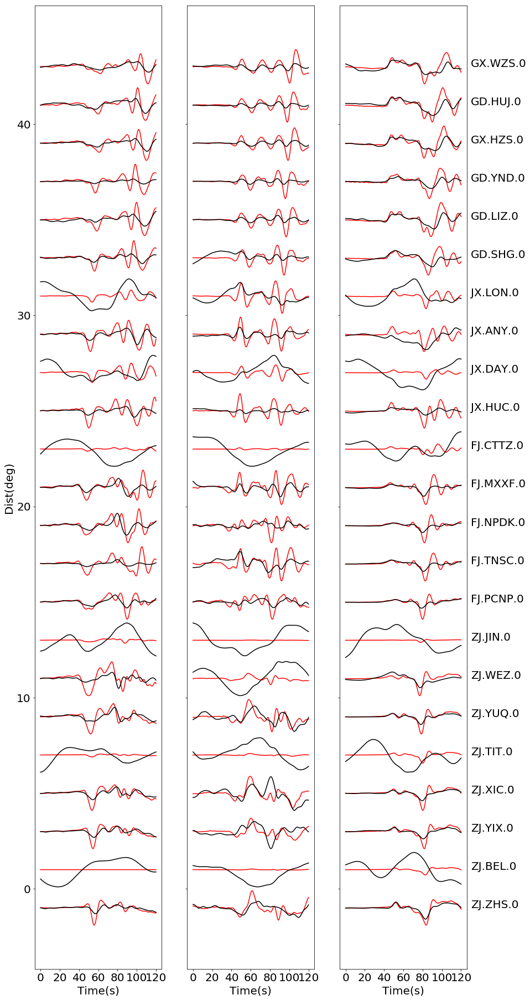

In [97]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,70,0.9,32)

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
17 Trace(s) in Stream:
ZJ.ZHS.S3.MXZ  | 2011-04-

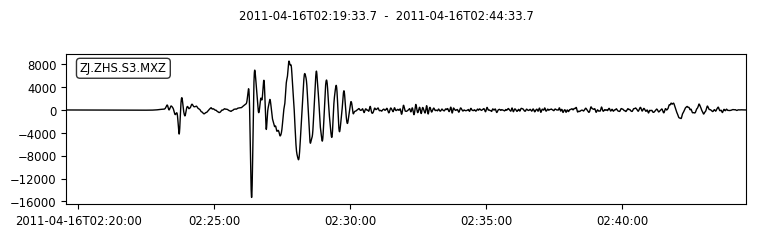

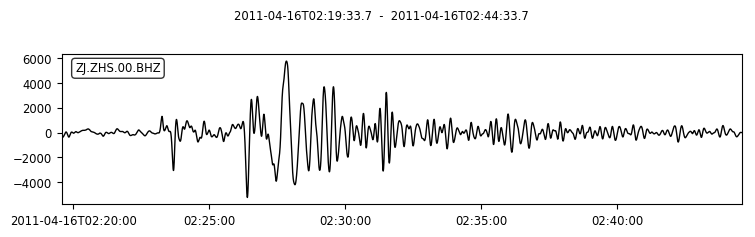

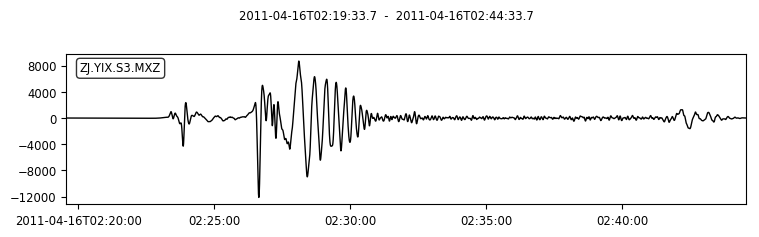

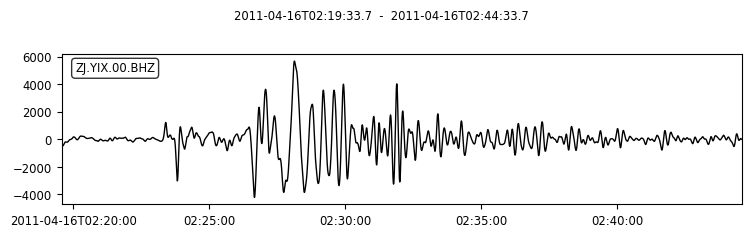

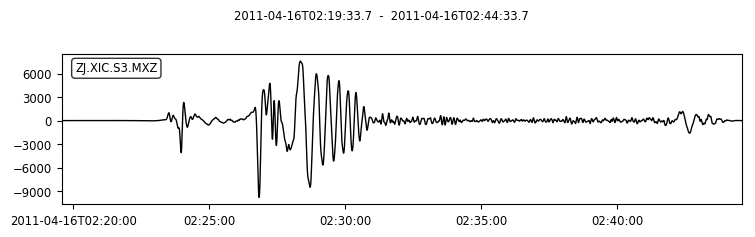

...

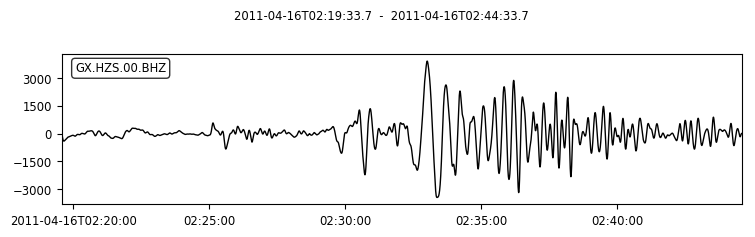

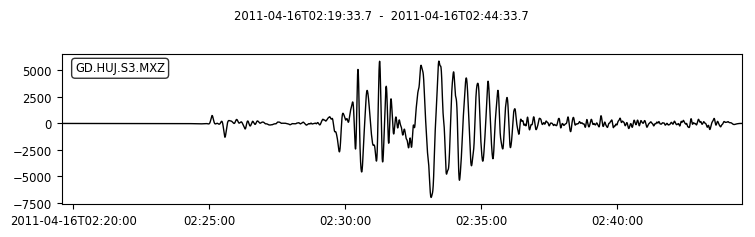

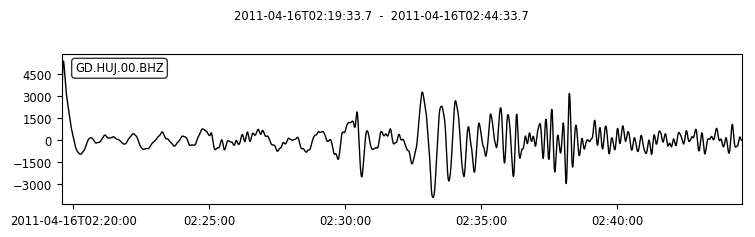

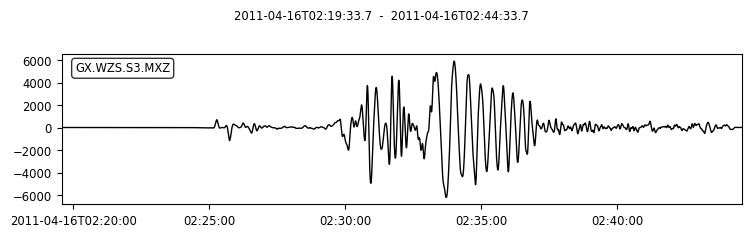

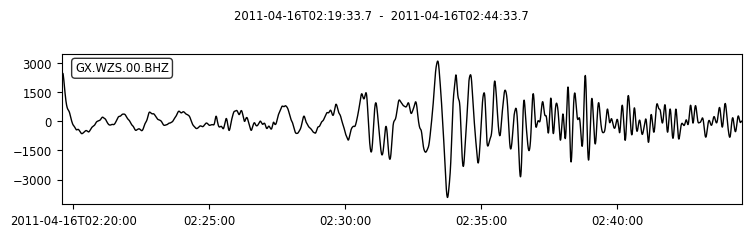

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
17 Trace(s) in Stream:
ZJ.ZHS.S3.MXR  | 2011-04-

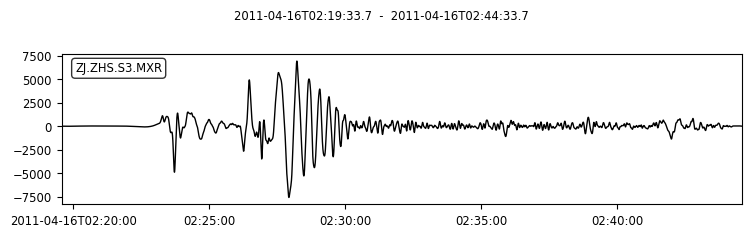

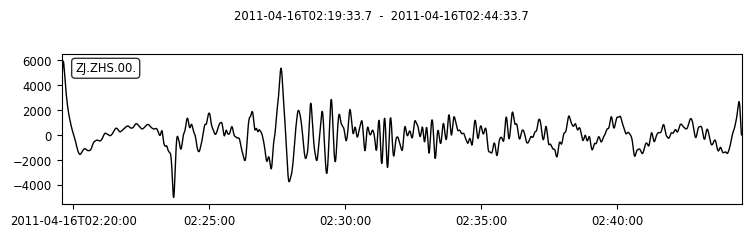

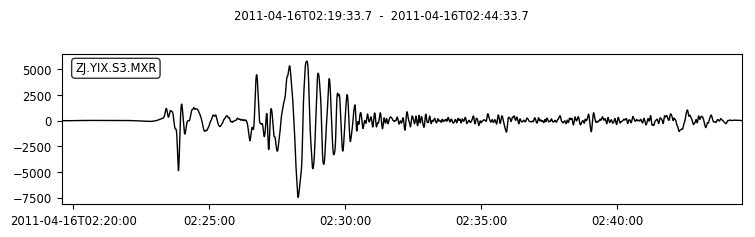

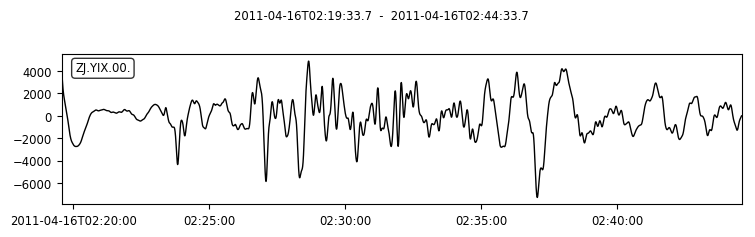

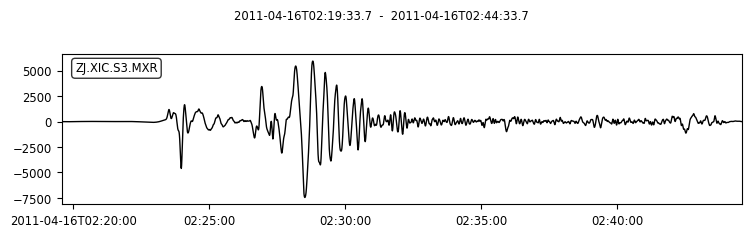

...

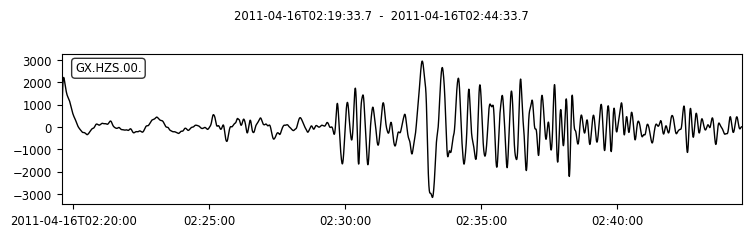

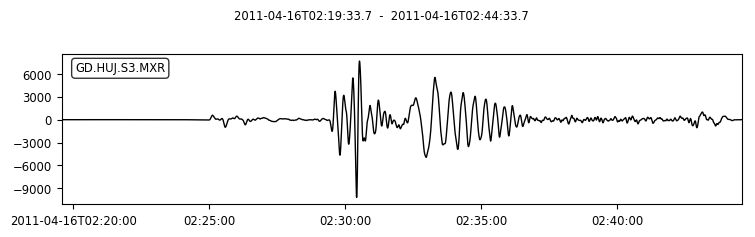

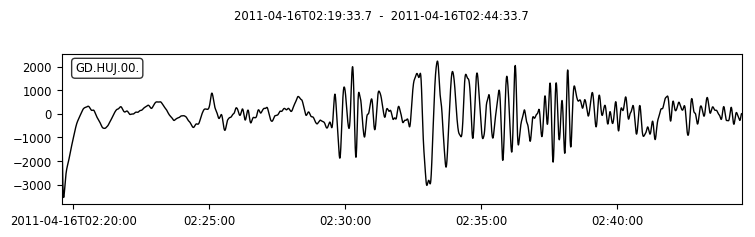

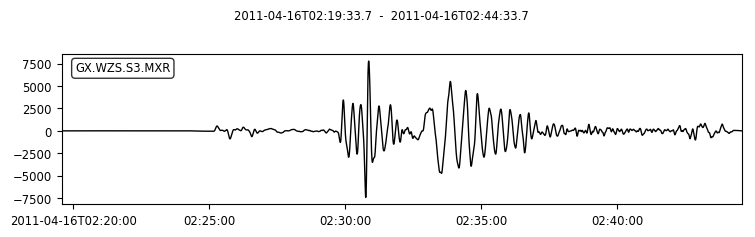

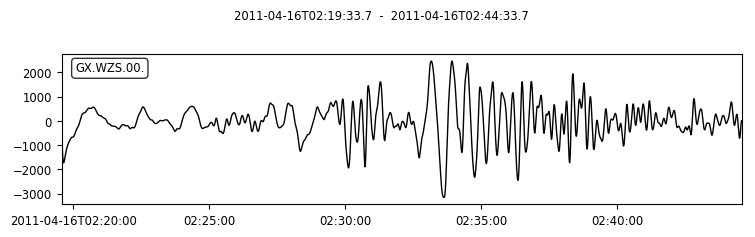

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
17 Trace(s) in Stream:
ZJ.ZHS.S3.MXT  | 2011-04-

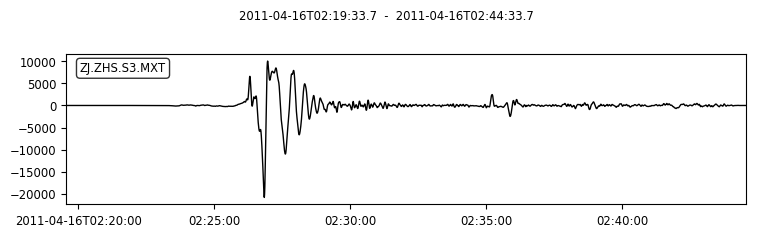

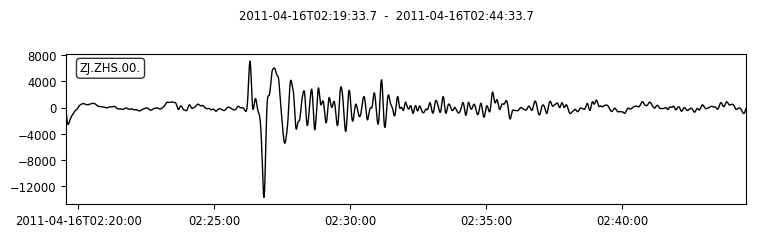

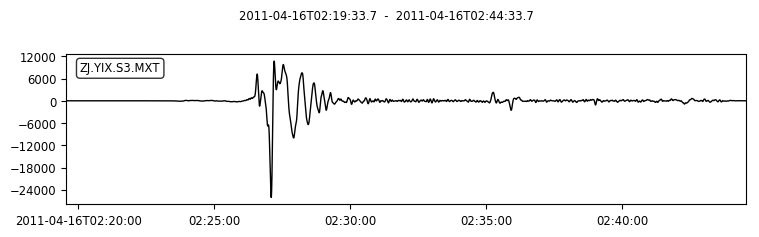

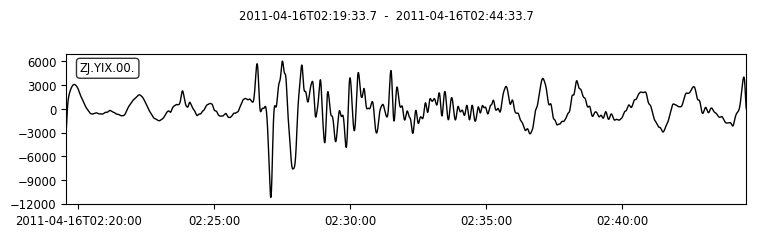

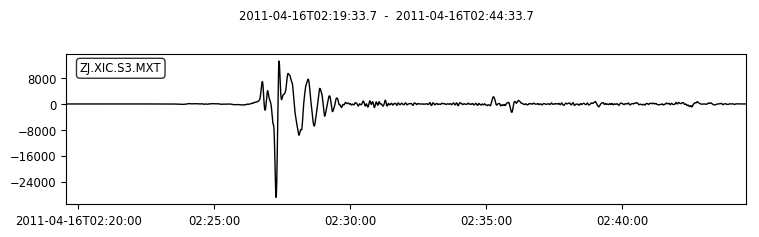

...

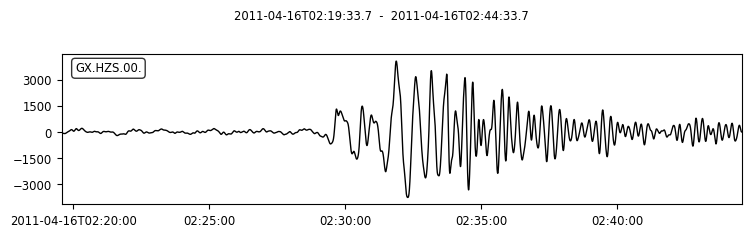

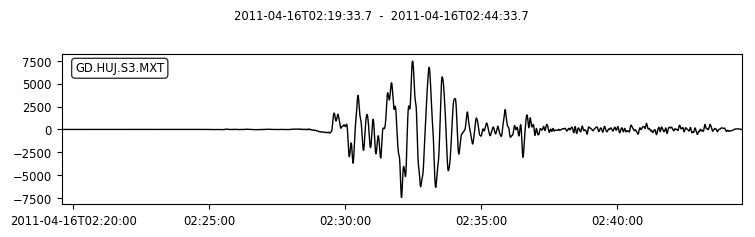

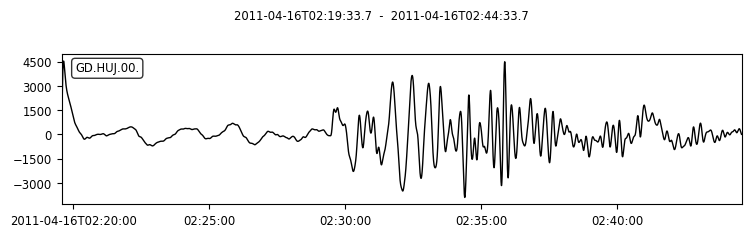

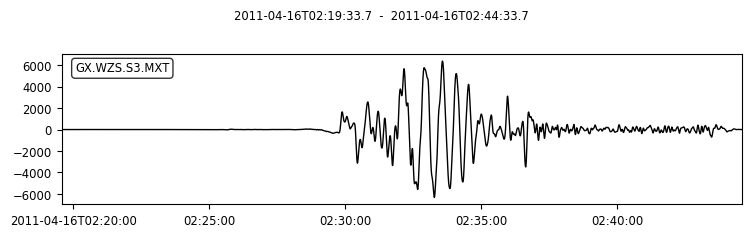

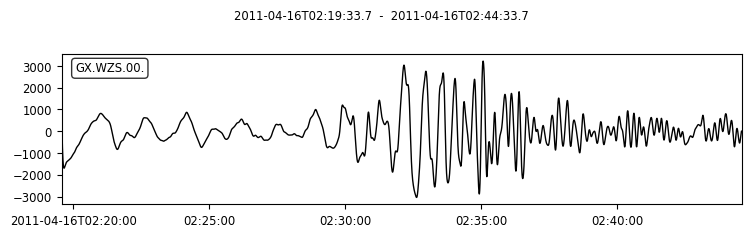

(17 Trace(s) in Stream:
ZJ.ZHS.S3.MXT  | 2011-04-16T02:25:26.550000Z - 2011-04-16T02:27:26.550000Z | 20.0 Hz, 2401 samples
ZJ.YIX.S3.MXT  | 2011-04-16T02:25:43.850000Z - 2011-04-16T02:27:43.850000Z | 20.0 Hz, 2401 samples
ZJ.XIC.S3.MXT  | 2011-04-16T02:25:56.050000Z - 2011-04-16T02:27:56.050000Z | 20.0 Hz, 2401 samples
ZJ.YUQ.S3.MXT  | 2011-04-16T02:26:04.800000Z - 2011-04-16T02:28:04.800000Z | 20.0 Hz, 2401 samples
ZJ.WEZ.S3.MXT  | 2011-04-16T02:26:18.200000Z - 2011-04-16T02:28:18.200000Z | 20.0 Hz, 2401 samples
FJ.PCNP.S3.MXT | 2011-04-16T02:26:50.800000Z - 2011-04-16T02:28:50.800000Z | 20.0 Hz, 2401 samples
FJ.TNSC.S3.MXT | 2011-04-16T02:27:20.900000Z - 2011-04-16T02:29:20.900000Z | 20.0 Hz, 2401 samples
FJ.NPDK.S3.MXT | 2011-04-16T02:27:09.050000Z - 2011-04-16T02:29:09.050000Z | 20.0 Hz, 2401 samples
FJ.MXXF.S3.MXT | 2011-04-16T02:27:26.550000Z - 2011-04-16T02:29:26.550000Z | 20.0 Hz, 2401 samples
JX.HUC.S3.MXT  | 2011-04-16T02:27:51.150000Z - 2011-04-16T02:29:51.150000Z | 20.0 Hz,

In [181]:
names=["ZHS","YIX","XIC","YUQ","WEZ","PCNP","TNSC","NPDK","MXXF","HUC","ANY","SHG","LIZ","YND","HZS","HUJ","WZS"]
network=["ZJ","ZJ","ZJ","ZJ","ZJ","FJ","FJ","FJ","FJ","JX","JX","GD","GD","GD","GX","GD","GX"]
syncz=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"Z",network)
dataz=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"Z",network)
syncr=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"R",network)
datar=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"R",network)
synct=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"T",network)
datat=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"T",network)
preprocess(syncz,dataz,1/100,1/10,"s",-50,70)
preprocess(syncr,datar,1/100,1/10,"s",-50,70)
preprocess(synct,datat,1/100,1/10,"s",-50,70)

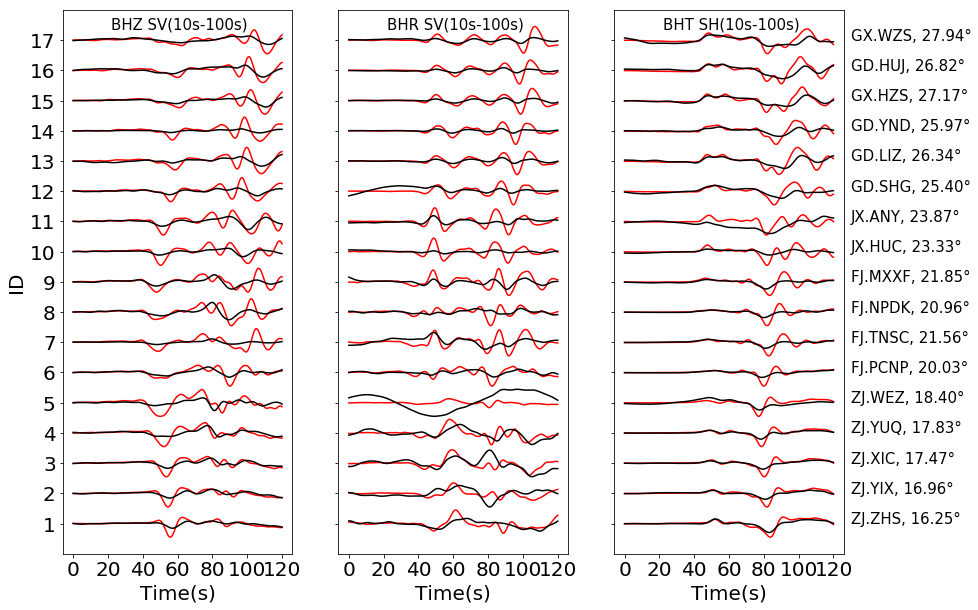

In [183]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,70,0.45,10)

HL.DNI.00.BHZ 10.2355
HL.MIH.00.BHZ 11.0939
HL.QTH.00.BHZ 11.4995
HL.BAQ.00.BHZ 11.5341
HL.SYS.00.BHZ 12.221
HL.JMS.00.BHZ 12.6002
HL.YIL.00.BHZ 12.8692
HL.TOH.00.BHZ 12.8917
HL.HEG.00.BHZ 13.1279
HL.QAN.00.BHZ 13.7534
HL.YCH.00.BHZ 14.0619
HL.BEL.00.BHZ 14.2494
HL.WDL.00.BHZ 15.9301
HL.JGD.00.BHZ 18.0372
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.7

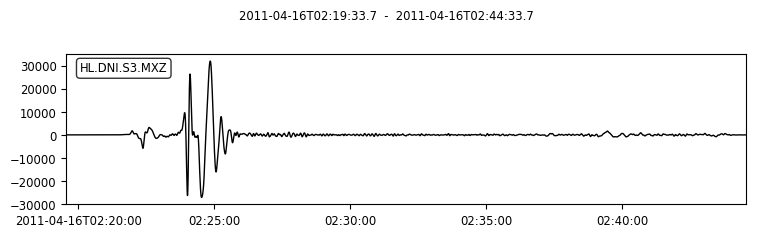

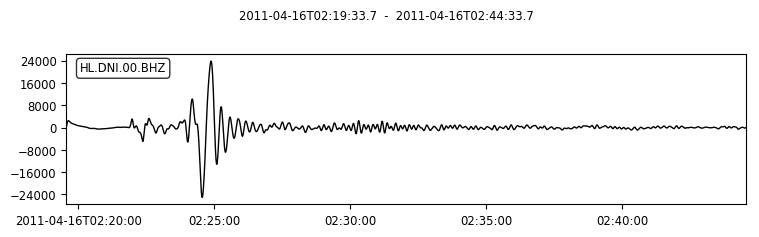

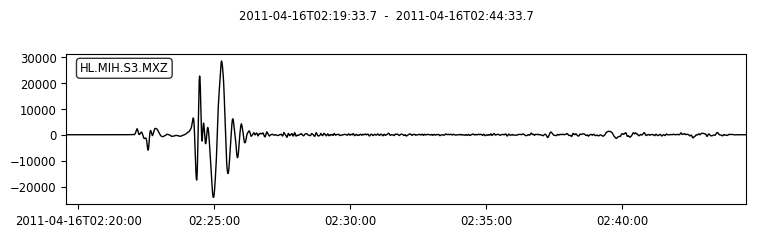

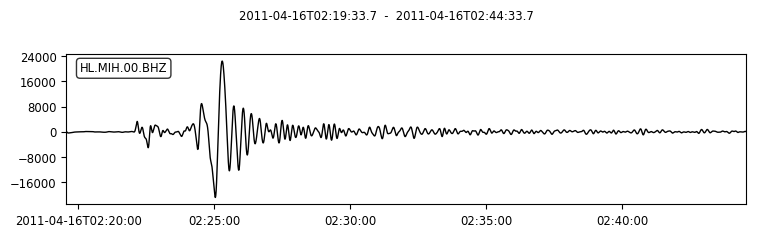

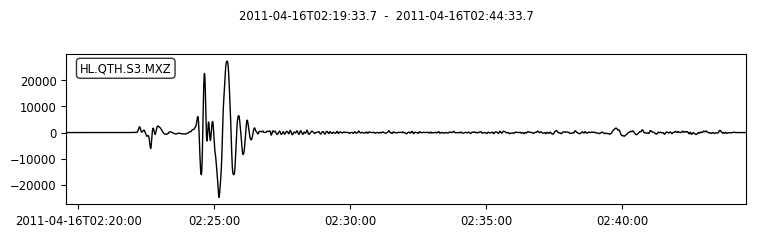

...

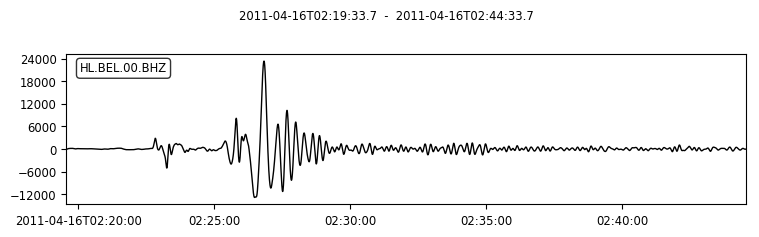

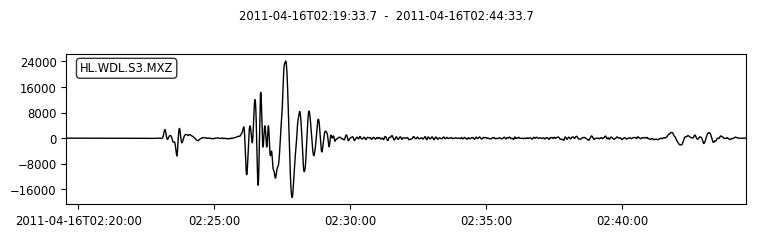

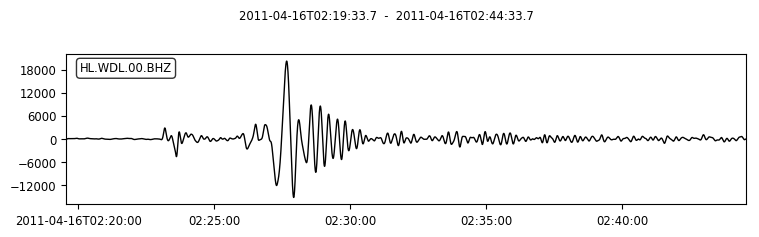

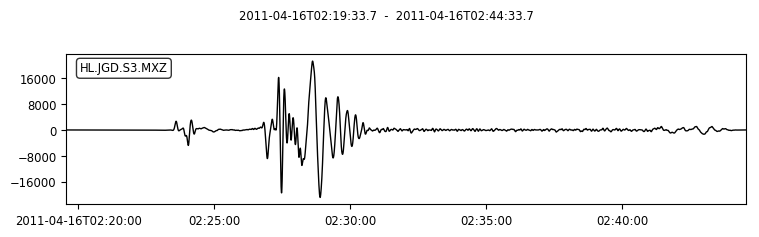

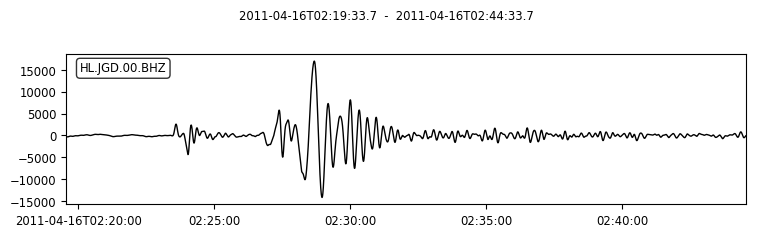

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
14 Trace(s) in Stream:
HL.DNI.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.MIH.S3.MXR | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 sam

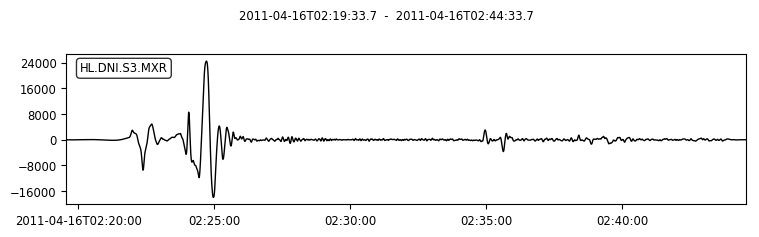

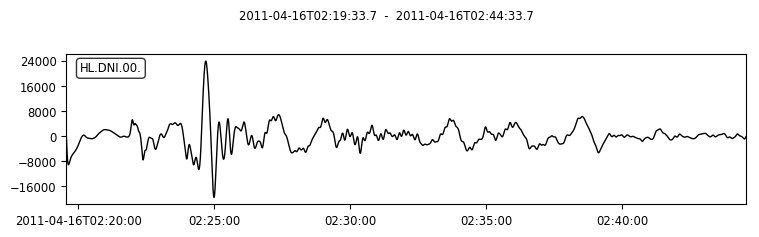

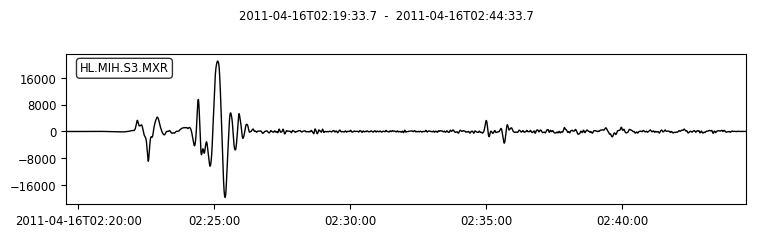

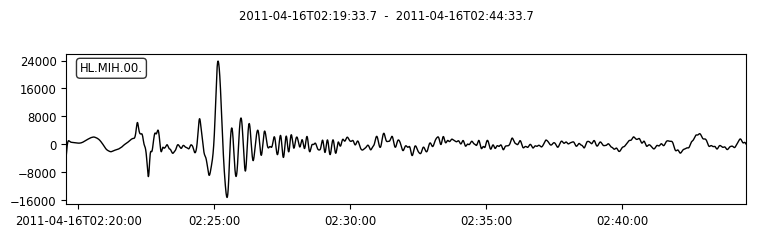

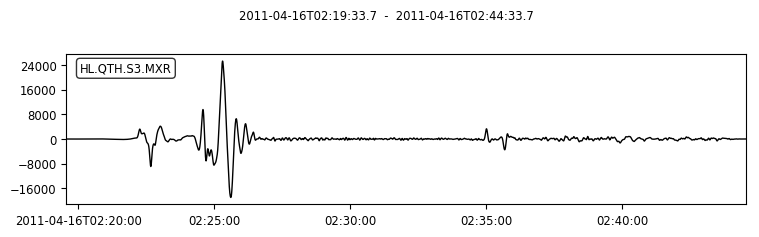

...

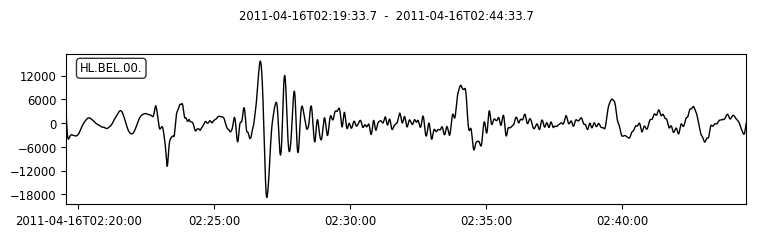

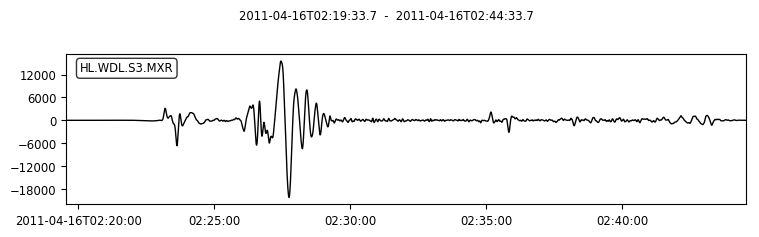

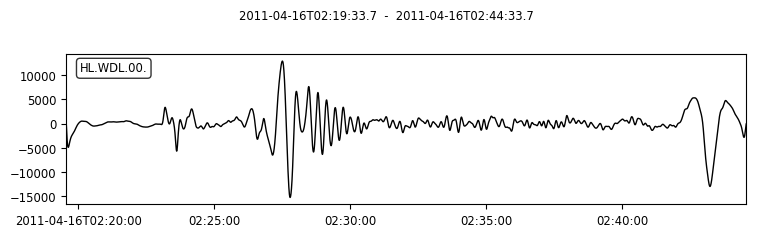

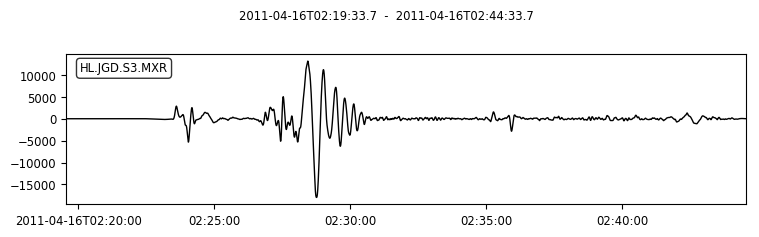

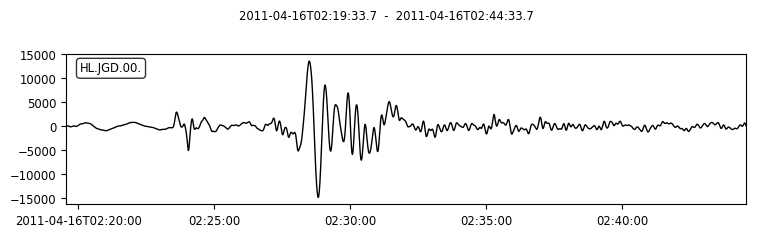

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
14 Trace(s) in Stream:
HL.DNI.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 samples
HL.MIH.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:44:33.700000Z | 20.0 Hz, 30001 sam

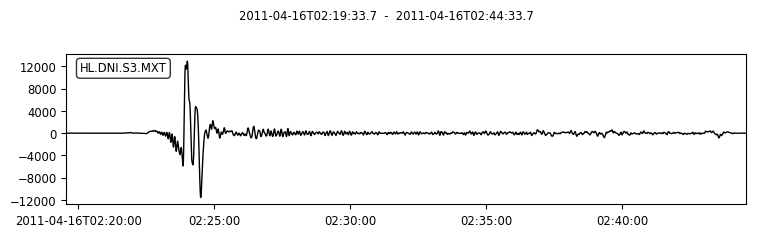

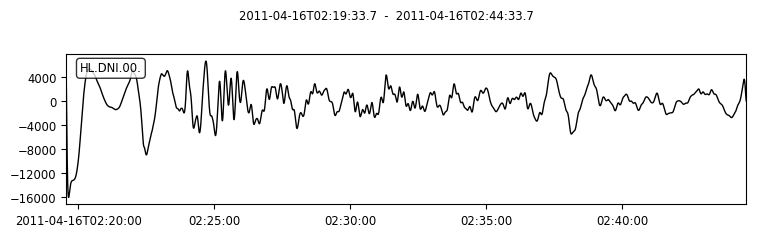

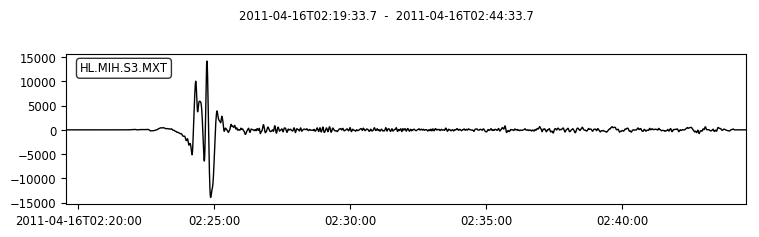

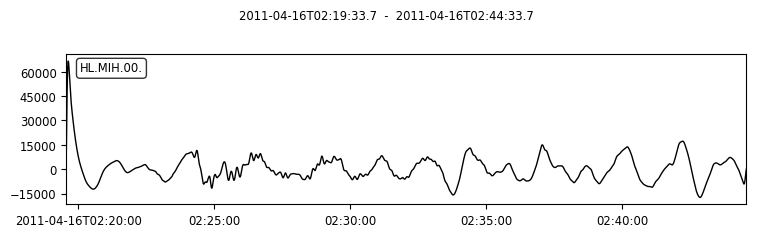

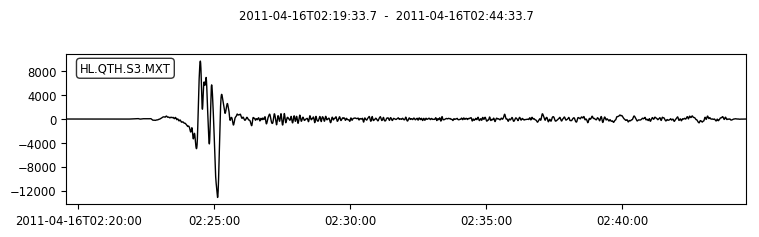

...

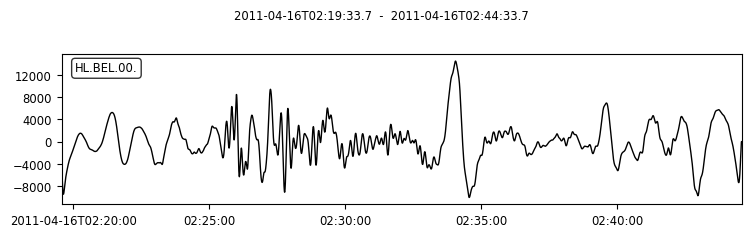

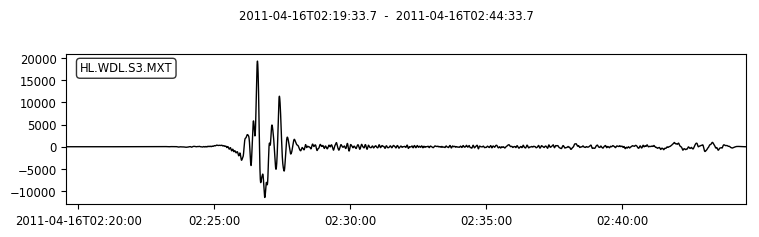

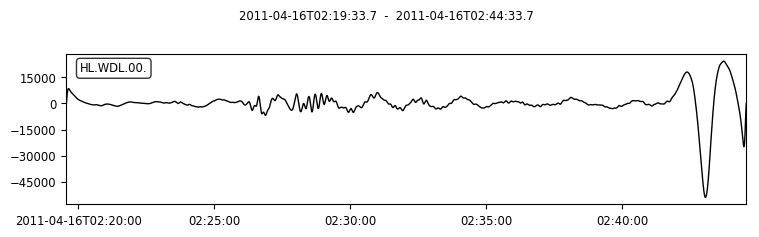

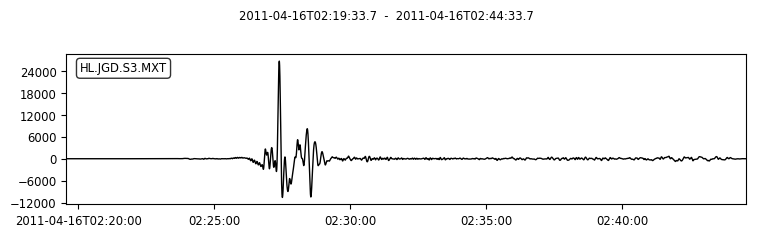

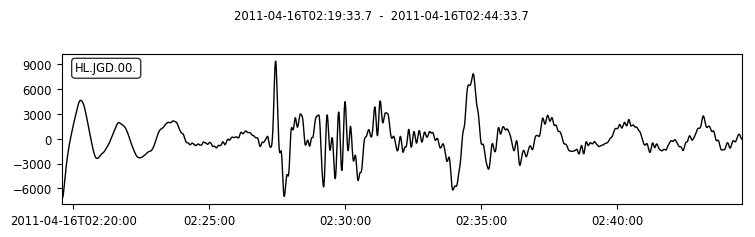

(14 Trace(s) in Stream:
HL.DNI.S3.MXT | 2011-04-16T02:23:00.500000Z - 2011-04-16T02:28:00.500000Z | 20.0 Hz, 6001 samples
HL.MIH.S3.MXT | 2011-04-16T02:23:21.400000Z - 2011-04-16T02:28:21.400000Z | 20.0 Hz, 6001 samples
HL.QTH.S3.MXT | 2011-04-16T02:23:31.300000Z - 2011-04-16T02:28:31.300000Z | 20.0 Hz, 6001 samples
HL.BAQ.S3.MXT | 2011-04-16T02:23:32.150000Z - 2011-04-16T02:28:32.150000Z | 20.0 Hz, 6001 samples
HL.SYS.S3.MXT | 2011-04-16T02:23:48.850000Z - 2011-04-16T02:28:48.850000Z | 20.0 Hz, 6001 samples
HL.JMS.S3.MXT | 2011-04-16T02:23:58.050000Z - 2011-04-16T02:28:58.050000Z | 20.0 Hz, 6001 samples
HL.YIL.S3.MXT | 2011-04-16T02:24:04.600000Z - 2011-04-16T02:29:04.600000Z | 20.0 Hz, 6001 samples
HL.TOH.S3.MXT | 2011-04-16T02:24:05.150000Z - 2011-04-16T02:29:05.150000Z | 20.0 Hz, 6001 samples
HL.HEG.S3.MXT | 2011-04-16T02:24:10.850000Z - 2011-04-16T02:29:10.850000Z | 20.0 Hz, 6001 samples
HL.QAN.S3.MXT | 2011-04-16T02:24:26.050000Z - 2011-04-16T02:29:26.050000Z | 20.0 Hz, 6001 samp

In [282]:
names=["MIH","QTH","JMS","YIL","YCH","JGD","DNI","BAQ","SYS","TOH","HEG","QAN","BEL","WDL"]
network=["HL","HL","HL","HL","HL","HL","HL","HL","HL","HL","HL","HL","HL","HL"]
syncz=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"Z",network)
dataz=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"Z",network)
syncr=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"R",network)
datar=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"R",network)
synct=get_sync_cea("/Users/ziyixi/Datas/poster/sync",names,"T",network)
datat=get_data_cea("/Users/ziyixi/Datas/poster/cea_data",names,"T",network)
for i in dataz:
    print(i.id,i.stats.sac.gcarc)
preprocess(syncz,dataz,1/100,1/10,"s",-50,250)
preprocess(syncr,datar,1/100,1/10,"s",-50,250)
preprocess(synct,datat,1/100,1/10,"s",-50,250)

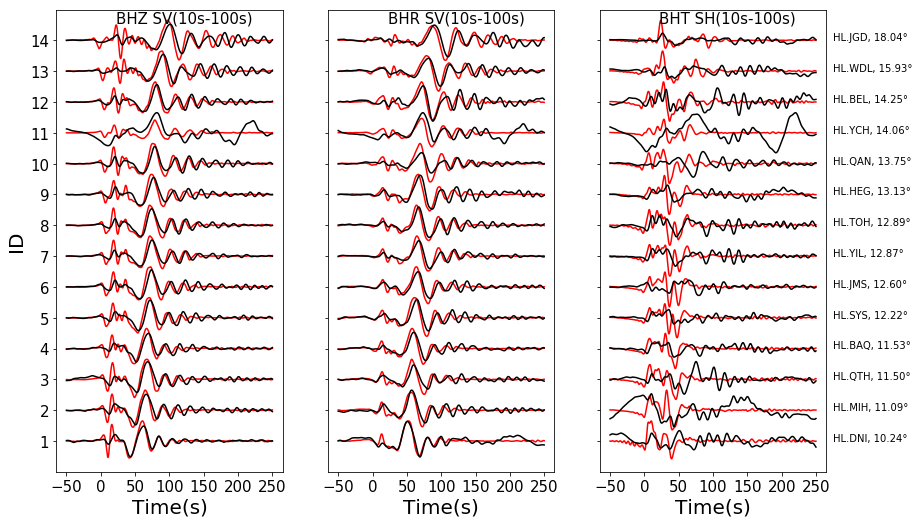

In [283]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,250,0.65,8.5)

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

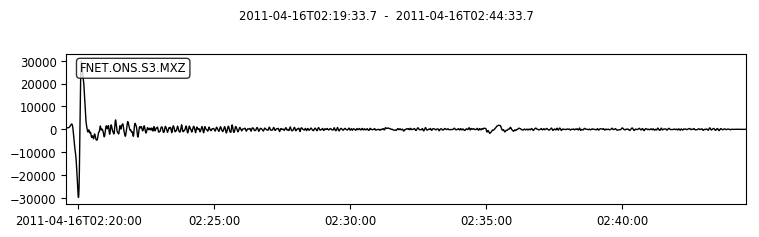

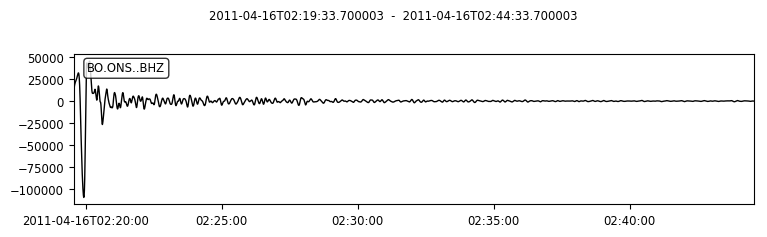

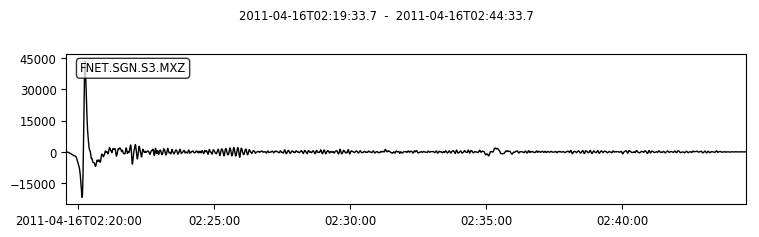

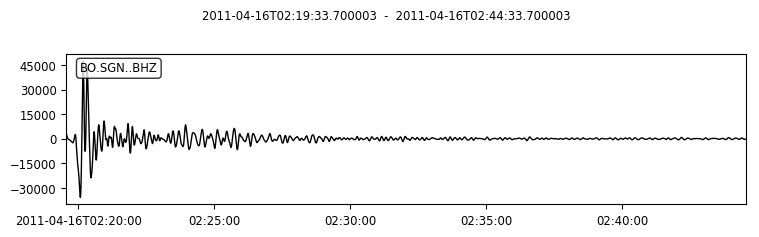

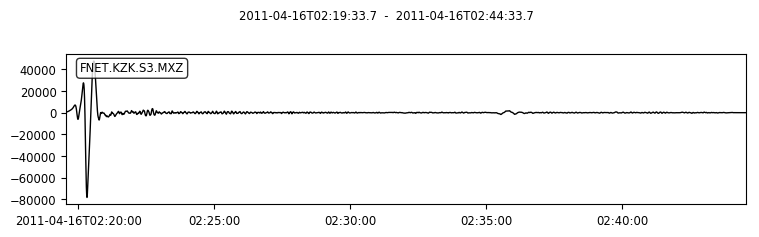

...

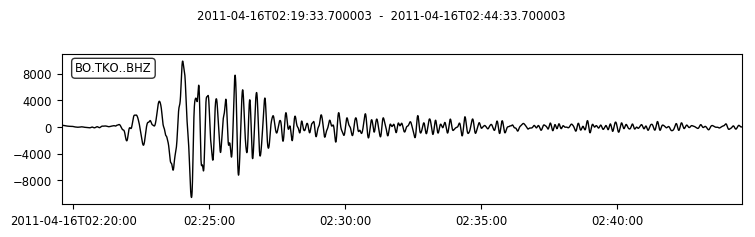

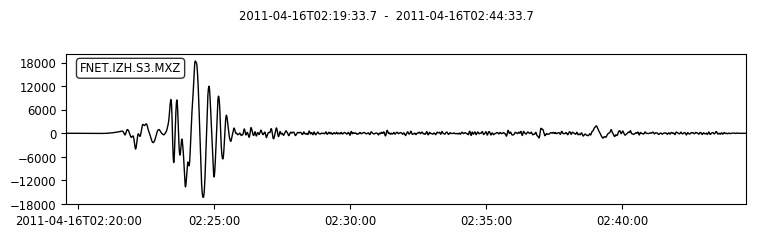

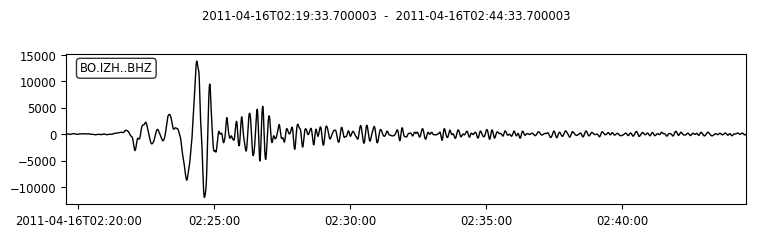

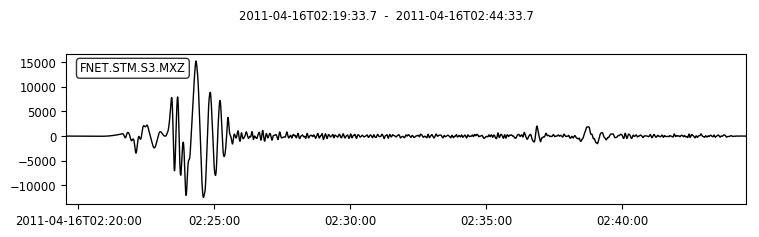

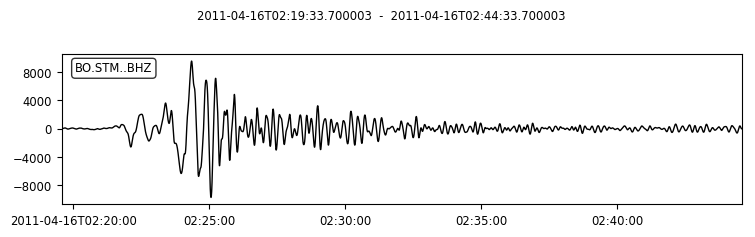

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

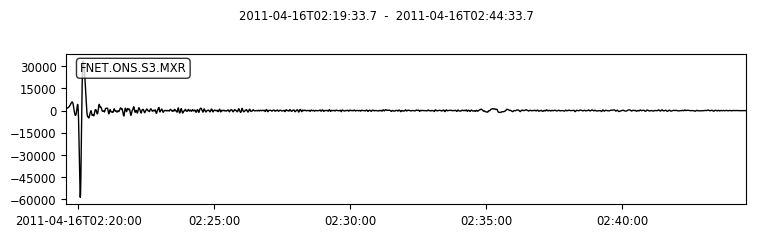

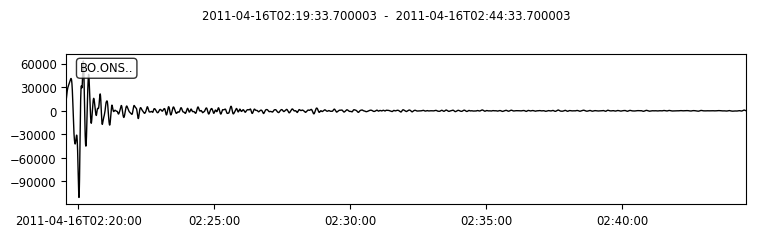

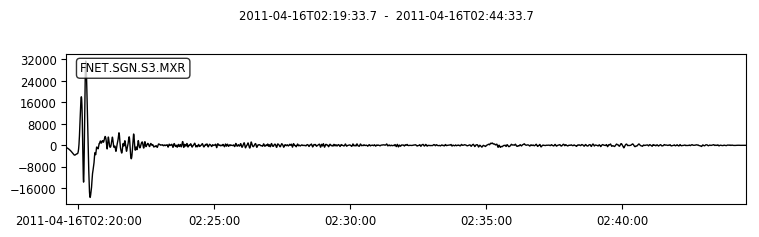

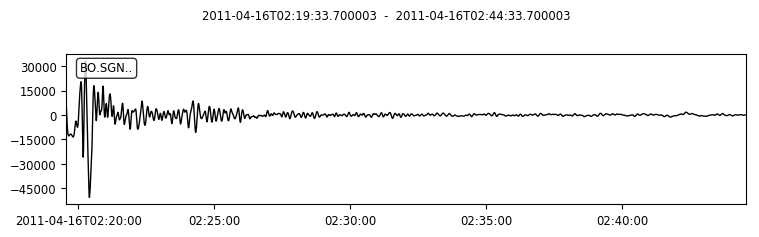

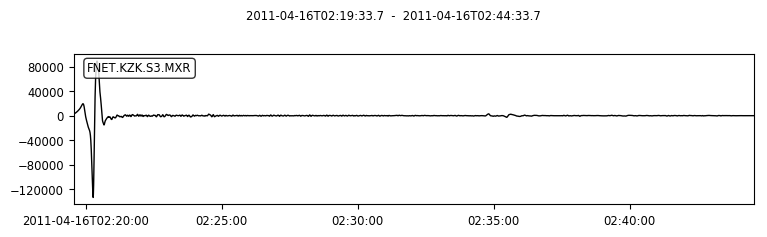

...

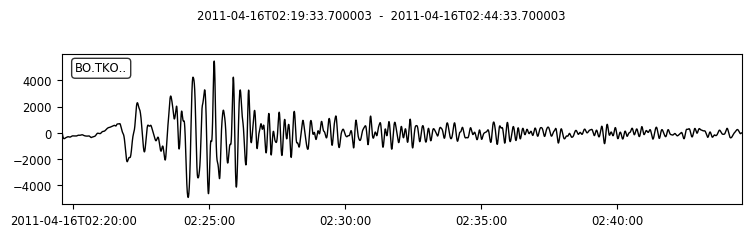

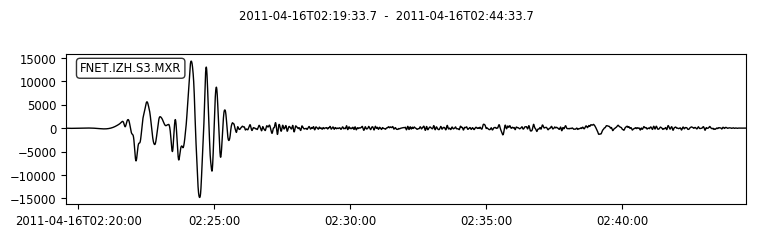

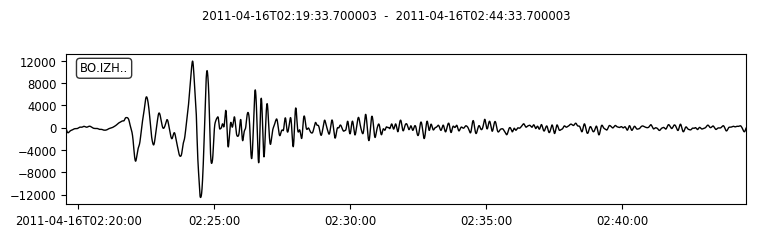

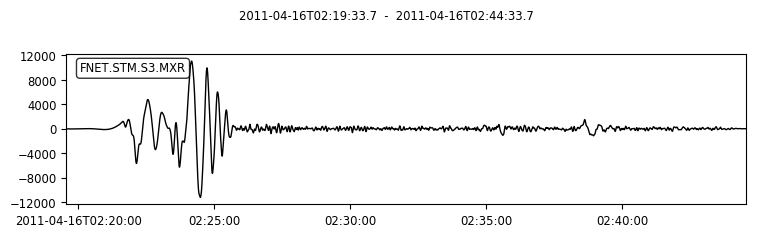

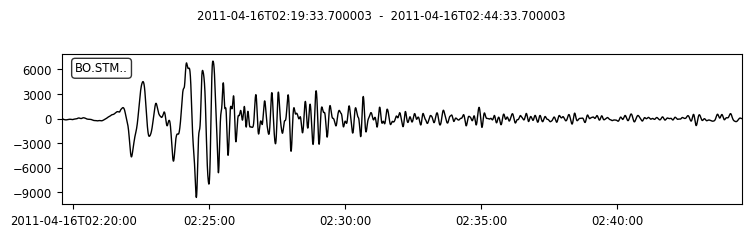

2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.700000Z
2011-04-16T02:19:33.

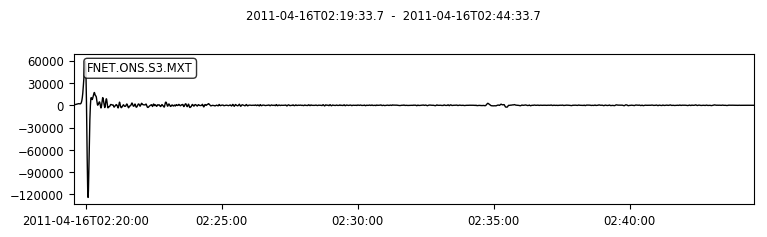

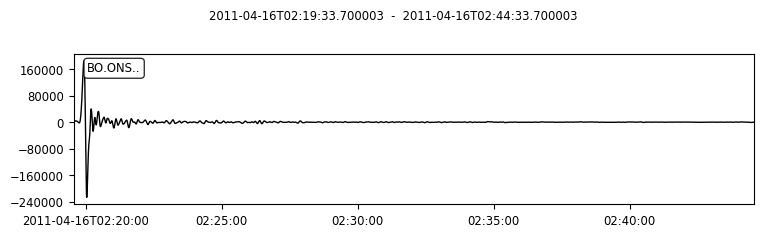

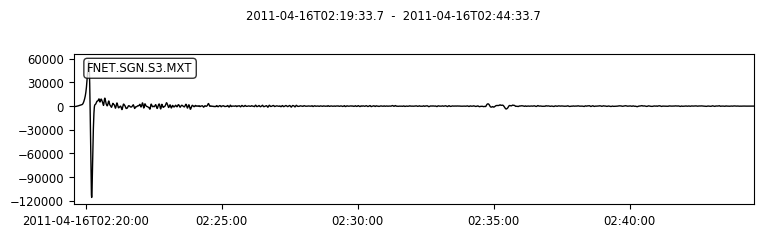

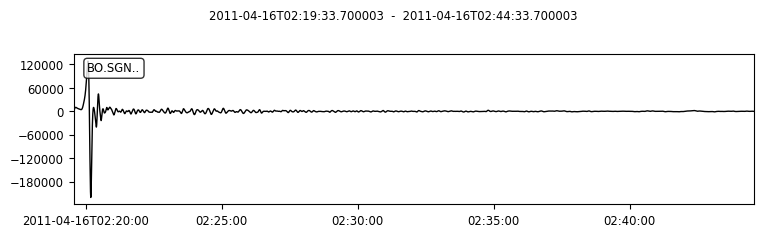

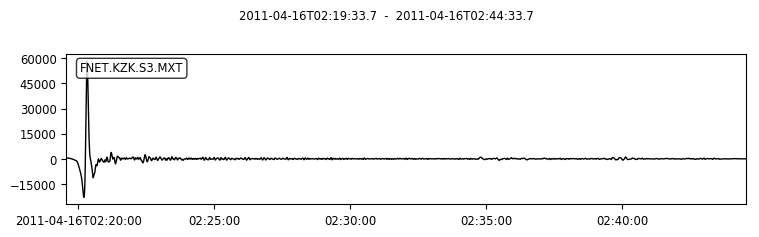

...

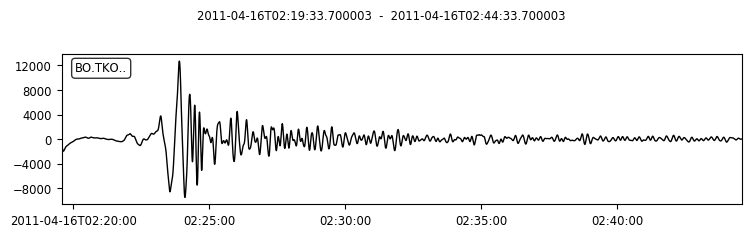

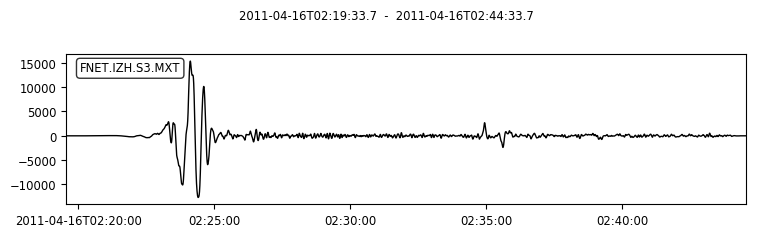

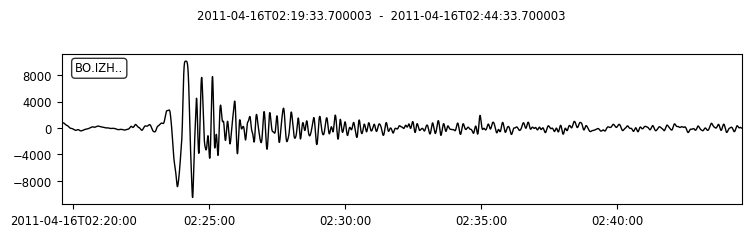

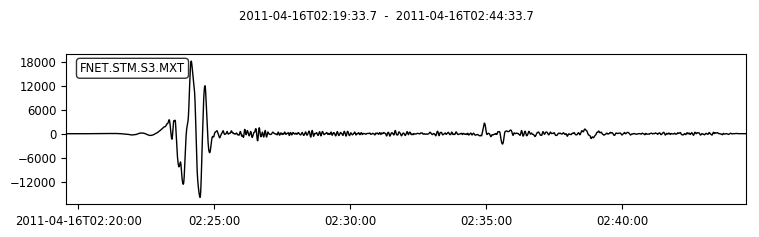

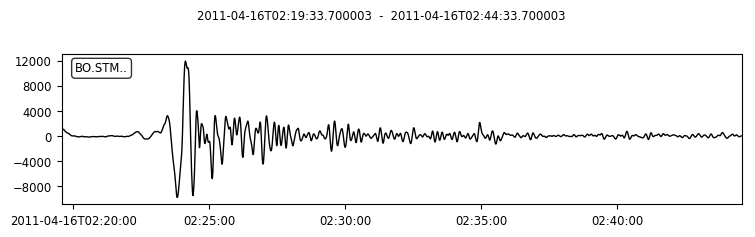

(31 Trace(s) in Stream:

FNET.ONS.S3.MXT | 2011-04-16T02:19:33.700000Z - 2011-04-16T02:24:14.100000Z | 20.0 Hz, 5609 samples
...
(29 other traces)
...
FNET.STM.S3.MXT | 2011-04-16T02:22:34.400000Z - 2011-04-16T02:27:34.400000Z | 20.0 Hz, 6001 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces],
 31 Trace(s) in Stream:

BO.ONS.. | 2011-04-16T02:19:33.700003Z - 2011-04-16T02:24:14.100003Z | 20.0 Hz, 5609 samples
...
(29 other traces)
...
BO.STM.. | 2011-04-16T02:22:34.400003Z - 2011-04-16T02:27:34.400003Z | 20.0 Hz, 6001 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces])

In [287]:
# names=["HRO","YMZ","ASI","TSK","ONS","TTO","SGN","KNM","NAA","TGA","YAS","YZK","ABU","NRW","ISI","NSK","TGW","OKW","INN","SBR","TKD","TMC","STM"]
names=["ONS","TTO","SGN","KNM","NAA","TGA","YAS","YZK","ABU","NRW","ISI","NSK","TGW","OKW","INN","SBR","TKD","TMC","STM","TKO","IZH","YTY","TSA","UMJ","KMT","KIS","WTR","KNY","JIZ","FUJ","KZK"]
syncz=get_sync("/Users/ziyixi/Datas/poster/sync",names,"Z")
dataz=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"Z")
syncr=get_sync("/Users/ziyixi/Datas/poster/sync",names,"R")
datar=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"R")
synct=get_sync("/Users/ziyixi/Datas/poster/sync",names,"T")
datat=get_data("/Users/ziyixi/Datas/poster/fnet_data",names,"T")
preprocess(syncz,dataz,1/100,1/10,"s",-50,250)
preprocess(syncr,datar,1/100,1/10,"s",-50,250)
preprocess(synct,datat,1/100,1/10,"s",-50,250)

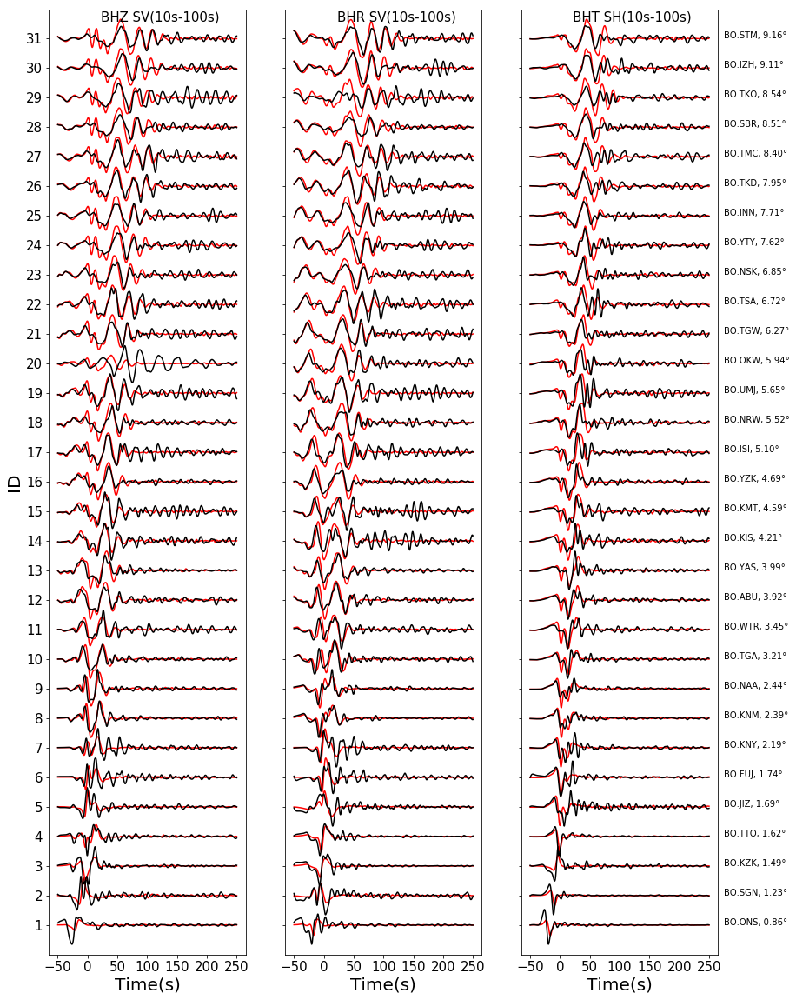

In [288]:
plot_three_component(dataz,datar,datat,syncz,syncr,synct,-50,250,0.65,20)